# Twitter Sentiment Classifier | Feedforward Neural Network
### Chatzispyrou Michail - 1115202000212

# Import essential libraries

In [1]:
import os
import random
import time
import string
import csv
import optuna
import re
import numpy as np
import pandas as pd
pd.set_option('display.max_colwidth', 100) 

import nltk
from nltk.tokenize import word_tokenize

import spacy
!python -m spacy download el_core_news_lg --quiet
nlp = spacy.load("el_core_news_lg")

import unicodedata
from unidecode import unidecode

import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
plt.style.use("seaborn-v0_8")
%matplotlib inline
from matplotlib.ticker import ScalarFormatter

from gensim.models import Word2Vec

from tabulate import tabulate

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader

from torch.optim.lr_scheduler import ReduceLROnPlateau, CyclicLR, LinearLR
from torchmetrics import F1Score, Precision, Recall, Accuracy, ConfusionMatrix

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.metrics import roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay

✔ Download and installation successful
You can now load the package via spacy.load('el_core_news_lg')


# Paths
We are defening some basic paths to make our life easier when reading or writing a file

In [2]:
ROOT_PATH = "/kaggle/"
INPUT_PATH = ROOT_PATH + "input/ys19-2023-assignment-2/"
OUTPUT_PATH = ROOT_PATH + "working/"

# Plotting functions
Since we were asked to plot data multiple times I preferred to make functions for each one of the plots.

In [3]:
def countplot(data, labels, percent, show, sort, title):
    if sort is not None:
        ax = sns.countplot(x=data, order=data.value_counts().sort_values(ascending=True).index)
    else:
        ax = sns.countplot(x=data)
    if percent is not None:
        for i in ax.containers:
            heights = [p.get_height() for p in i]
            for p, height in zip(i, heights):
                percentage = (height / len(data)) * 100
                ax.annotate(f"{int(height)}",
                    (p.get_x() + p.get_width() / 2.0, height),
                    ha="center",
                    va="center",
                    xytext=(0, 5),
                    textcoords="offset points")
                ax.annotate(f"{percentage:.2f}%",
                    (p.get_x() + p.get_width() / 2.0, height),
                    ha="center",
                    va="center",
                    fontsize=9,
                    xytext=(0, -11),
                    textcoords="offset points")
    else:
        for i in ax.containers:
            ax.bar_label(i,)
    if len(labels) == 2:
        plt.xlabel(labels[0])
        plt.ylabel(labels[1])
    else:
        plt.ylabel(labels[0])
    plt.title(title)
    if show:
        plt.show()

def stackedcountplot(data, labels, x, hue, show, sort, title):
    custom_pallete = {"POSITIVE": "Green", "NEGATIVE": "red", "NEUTRAL": "gray"}
    if sort is not None:
        ax = sns.countplot(data=data, x=x, hue=hue, order=data[x].value_counts().sort_values(ascending=True).index,
                     palette=custom_pallete)
    else:
        ax = sns.countplot(data=data, x=x, hue=hue, palette=custom_pallete)
    
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(f'{int(height)}',(p.get_x() + p.get_width() / 2., height),fontsize = 7,ha='center',va='bottom') 
    
    if len(labels) == 2:
        plt.xlabel(labels[0])
        plt.ylabel(labels[1])
    else:
        plt.ylabel(labels[0])
    plt.title(title)
    if show:
        plt.show()
        
def bar_chart(data, show, title, labels):
    fig, ax = plt.subplots()
    sns.barplot(x=labels, y=data, ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=7)
    ax.set_title(title)
    # Add numbers on top of the bars
    if title == "Time Taken":
        for i, val in enumerate(data):
            ax.text(i, val, val, ha='center', va='bottom', fontsize=9)
    else:
        for i, val in enumerate(data):
            ax.text(i, val, f"{val*100:.2f}%", ha='center', va='bottom', fontsize=9)
    if show:
        plt.show()

def custom_roc_curve(Y_val, y_score, show):
    # Compute ROC curve and AUC for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    classes = [0, 1, 2]
    for i, label in enumerate(classes):
        fpr[i], tpr[i], _ = roc_curve(Y_val == label, y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Plot ROC curves for each class
    classes = ["NEGATIVE", "NEUTRAL", "POSITIVE"]
    for i in range(len(classes)):
        plt.plot(fpr[i], tpr[i], label=f'ROC curve {classes[i]} (AUC = {roc_auc[i]*100:0.2f}%)')

    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend(loc="lower right")
    if show:
        plt.show()

def custom_learning_curve(train_score, test_score, size, xlabel, ylabel, show):
    plt.plot(size, train_score, 'o-', color="r", label="Training")
    plt.plot(size, test_score, 'o-', color="g", label="Validation")
#     plt.plot(size, train_score, color="r", label="Training")
#     plt.plot(size, test_score, color="g", label="Validation")
    
    plt.legend(loc="best")
    plt.ylabel(ylabel=ylabel)
    plt.xlabel(xlabel=xlabel)
    if show:
        plt.show()

def custom_confusion_matrix(conf_matrix, show):
    # Generate and print confusion matrix  
    cm_display = ConfusionMatrixDisplay(confusion_matrix = conf_matrix, display_labels = ["NEGATIVE", "NEUTRAL", "POSITIVE"])
    cm_display.plot(ax=plt.gca())
    plt.grid(False)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    if show:
        plt.show()

# Eliminate Randomness
In order for us to achieve the same results in every execution of the notebook we are going to create a function which will initialize all the seeds with a specific number.

In [4]:
def randonmness_elimination(seed=212):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    torch.cuda.manual_seed_all(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)

In [5]:
randonmness_elimination(212)

# Loading the Dataset
We are going to load the datasets

In [6]:
# csv -> dataframe
df_train = pd.read_csv(INPUT_PATH + "train_set.csv")
df_val = pd.read_csv(INPUT_PATH + "valid_set.csv")

# Exploring the Dataset
We are going to examine the structure of the datasets in order to gain valuable insights about the data

## Firstly, we are going to check the form of the data and its content

In [7]:
# print the data frame
df_train

,New_ID,Text,Sentiment,Party
0,35027,#απολυμανση_κοριοι #απεντομωση_κοριος #απολυμανσεις #κοριος#Alphatv #Την Κυριακη #Κουλης #Τσιπρ...,NEUTRAL,SYRIZA
1,9531,Έξι νέες επιστολές για τη Μακεδονία «καίνε» τη ΝΔ - Ο Μητσοτάκης γνώριζε και δίχασε το έθνος htt...,NEGATIVE,ND
2,14146,"Ισχυρό ΚΚΕ, δύναμη του λαού στη Βουλή και στους καθημερινούς αγώνες",POSITIVE,KKE
3,28716,@five2nds @anthi7vas Μνημονιακότατο το #ΜεΡΑ25 #Εκλογες_2019 #8iouliou #epomeni_mera #ΤΩΡΑ_ΚΚΕ ...,NEUTRAL,KKE
4,32886,@ai_katerina Αυτό που είναι συγκλονιστικό είναι η ψυχασθένεια του Τσίπρα!,NEUTRAL,SYRIZA
...,...,...,...,...
36625,35374,@KourtakisJohn @kmitsotakis Ο Κούλης ο Μητσοτάκης λέει ψέματα!!!Δεν άδειασε κανένα Μπάμπη Παπαδη...,NEUTRAL,ND
36626,7744,@enikos_gr @NChatzinikolaou @AdonisGeorgiadi Πρόσεξε μην σκίσει και κανένα καλσόν. Επίσης ... χά...,NEGATIVE,ND
36627,35216,Η θέση του ΚΚΕ για την ασφάλεια των πολιτών και τους διάφορους Ρουβίκωνες είναι η βαθιά κρίση το...,NEUTRAL,KKE
36628,2855,"@thanosplevris Μαρη κακομοίρα θυγατέρα του ναζιστη αντισημίτη, έχεις ξεφτιλιστεί τόσο πολύ που ο...",NEGATIVE,ND


We can see that the train set consists of the following 4 columns:
* ID $\rightarrow$ the ID of the tweet in the dataset
* Text $\rightarrow$ the text of the tweet
* Sentiment $\rightarrow$ the sentiment label POSITIVE, NEUTRAL or NEGATIVE
* Party $\rightarrow$ the potilical party the tweet is reffering to
Finally, we can see that the number of data which will be used to train our model is 36630

## We continue the examination by visualizing the number of tweets for every political party and also the number of each sentiment label for the corresponding political party

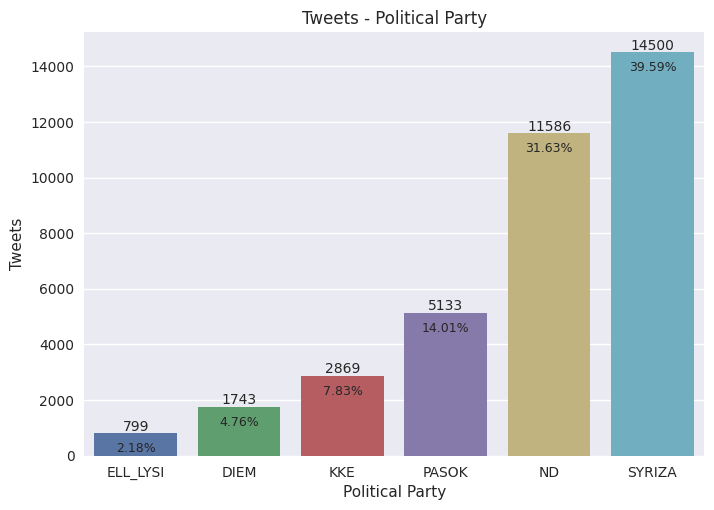

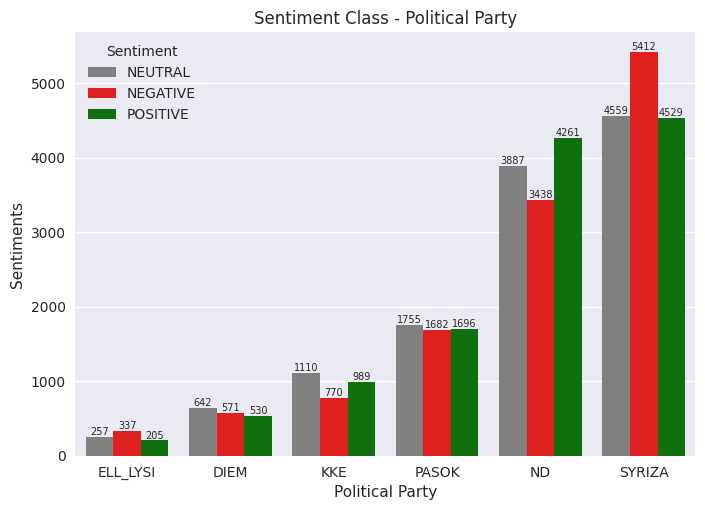

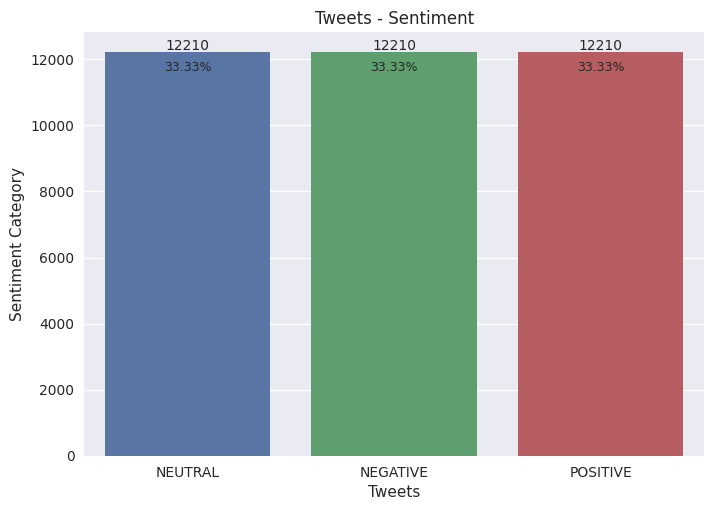

In [8]:
# Get the unique values for party
unique_values = df_train["Party"].unique()
# Find for each unique value their occurence
occurences = df_train["Party"].value_counts()[unique_values]
# Make a countplot
countplot(df_train["Party"], ["Political Party","Tweets"], True, False, True, "Tweets - Political Party")
try:
    plt.savefig('explore/tweets_pp.png')    
except:
    !mkdir explore
    plt.savefig('explore/tweets_pp.png')    
plt.show()
# Make the stacked countplot
stackedcountplot(df_train, ["Political Party","Sentiments"], "Party", "Sentiment", False, True, "Sentiment Class - Political Party")
try:
    plt.savefig('explore/sentiment_pp.png')    
except:
    !mkdir explore
    plt.savefig('explore/sentiment_pp.png')
plt.show()
# Get the unique values for sentiment
unique_values = df_train["Sentiment"].unique()
# Find for each unique value their occurence
occurences = df_train["Sentiment"].value_counts()[unique_values]
countplot(df_train["Sentiment"], ["Tweets","Sentiment Category"], True, False, None, "Tweets - Sentiment")
try:
    plt.savefig('explore/t_s.png')    
except:
    !mkdir explore
    plt.savefig('explore/t_s.png')  
plt.show()

Having thoroughly examined the dataset, we can now draw the following conclusions:
* The dataset is evenly distributed in terms of sentiment categories: </br></br>
&nbsp;&nbsp;12210 are NATURAL</br>
&nbsp;&nbsp;12210 are NEGATIVE</br>
&nbsp;&nbsp;12210 are POSITIVE</br></br>
* 39.59% of the tweets are reffering to "SYRIZA" in which:</br></br>
&nbsp;&nbsp;4559 are NATURAL</br>
&nbsp;&nbsp;5412 are NEGATIVE</br>
&nbsp;&nbsp;4529 are POSITIVE</br></br>
* 31.63% of the tweets are reffering to "ND" from which:</br></br>
&nbsp;&nbsp;3887 are NATURAL</br>
&nbsp;&nbsp;3438 are NEGATIVE</br>
&nbsp;&nbsp;4261 are POSITIVE</br></br>
* 14.01% of the tweets are reffering to "PASOK" from which:</br></br>
&nbsp;&nbsp;1755 are NATURAL</br>
&nbsp;&nbsp;1682 are NEGATIVE</br>
&nbsp;&nbsp;1696 are POSITIVE</br></br>
*  7.83% of the tweets are reffering to "KKE" from which:</br></br>
&nbsp;&nbsp;1110 are NATURAL</br>
&nbsp;&nbsp;770 are NEGATIVE</br> 
&nbsp;&nbsp;989 are POSITIVE</br></br>
*  4.76% of the tweets are reffering to "DIEM" from which:</br></br>
&nbsp;&nbsp;642 are NATURAL</br>
&nbsp;&nbsp;571 are NEGATIVE</br>
&nbsp;&nbsp;530 are POSITIVE</br></br>
*  2.18% of the tweets are reffering to "ELL_LYSI" from which:</br></br>
&nbsp;&nbsp;257 are NATURAL</br>
&nbsp;&nbsp;337 are NEGATIVE</br>
&nbsp;&nbsp;205 are POSITIVE

### We could also examine the validation set but we already know that it is the same as train set. On the other hand,  the test set does not containt the sentiment column, that's because the main purpose of this notebook is to predict their sentiment class using the train & validation sets.

# Data Pre-processing
In the previous assignment I conducted experiments with 3 different variations of the training set:
* No Pre-processing at all
* Basic Pre-processing
* Basic Pre-processing & Lemmatization<br>

While we are pre-processing the data we are creating a new column named `Tokens` in which we are storing the tokens of each tweet in order to use them in [Word2Vec](#word2vec) section.

## Data cleaning
The "winning" option proved to be the **Basic Pre-processing** so I'm going to do the same process below. After that I'm going to train my own Word2Vec model.

In [9]:
def remove_accents(word):
    ret =''.join(c for c in unicodedata.normalize('NFD', word) if unicodedata.category(c) != 'Mn')
    return ret

def clean_tweets(df, lemm):
    # That's the basic pre-processing    
    # Remove possible links starting with http/https/www
    df['Text'] = df['Text'].str.replace(r"(http[s]?://|www\.)[^\s]+", " ", regex = True)
    # Remove whole word with # symbol
    df['Text'] = df['Text'].str.replace(r"(#)[^\s]+", " ", regex = True)
    # Remove whole word with @ symbol
    df['Text'] = df['Text'].str.replace(r"(@)[^\s]+", " ", regex = True)
    # Lowercase everything
    df['Text'] = df['Text'].str.lower()
    # Keep only latin/greek letters and numbers
    df['Text'] = df['Text'].str.replace(r"[^\wa-zα-ω]", " ", regex = True)    
    # If the user wants to do the lemmazation process we will perform it otherwise the token will be added only if it is not a stop word
    df['Tokens'] = df['Text'].apply(lambda text: [token.lemma_ if lemm else token.text for token in nlp(remove_accents(text)) if token.text not in nlp.Defaults.stop_words and token.text.strip()])
    # At last we are combine the tokens to create the new text for the tweet    
    df['Text'] = df['Tokens'].apply(lambda tokens: " ".join(tokens))
    # Then return the cleaned dataframe
    return df

I'm adding two more stop words in the set and also remove the accents from the stop words.

In [10]:
for word in set(nlp.Defaults.stop_words):
    nlp.Defaults.stop_words.add(remove_accents(word))
nlp.Defaults.stop_words.add('κ')
nlp.Defaults.stop_words.add('κι')

#### The cell below has to run only one time in order for the pre-process to take place. After that we can just load the cleaned dataset that was mentioned above.

In [11]:
# First wabse copy the dataframe
df_train_cleaned_bp = df_train.copy()
# Now we will clean the text column
df_train_cleaned_bp = clean_tweets(df_train_cleaned_bp, False)
# Save the cleaned dataset in case we need it in the future instead of cleaning it from the beginning
df_train_cleaned_bp.to_json(OUTPUT_PATH + 'cleaned_train_bp.json')
# Now we are doing the same process for the validation set
df_val_cleaned_bp = df_val.copy()
df_val_cleaned_bp = clean_tweets(df_val_cleaned_bp, False)
df_val_cleaned_bp.to_json(OUTPUT_PATH + 'cleaned_val_bp.json')

## Loading cleaned dataset
We are loading the cleaned dataset.

In [12]:
#Load the cleaned data for Basic Pre-Processing
df_train_bp = pd.read_json(OUTPUT_PATH + "cleaned_train_bp.json")
df_val_bp = pd.read_json(OUTPUT_PATH + "cleaned_val_bp.json")

## Word2Vec
Now we are going to create and train our own Word2Vec model. I choosed to do that for two reasons:
1. To experiment and learn new techniques 
2. After thorough search I didn't come up with something I though it would be useful to me

The model was trained using the following:
* The Token column which we created during pre-processing phase was used as the input
* Each word in order to be known needs to have at least one 1 occurrence
* The dimension of each word vector is 300 
* In order to reproduce the results I'm also using a stable seed 212 (the last 3 digits of my sdi)
* 20 epochs was used to train the model

In [13]:
# Define the word2vec model
word2vec_model = Word2Vec(sentences=list(df_train_bp["Tokens"]), workers=1, min_count=1, vector_size=300, seed=212)

# Train the word2vec model as we said above
word2vec_model.train(list(df_train_bp["Tokens"]), epochs=20, total_examples=word2vec_model.corpus_count)

(6985904, 7411700)

### Mean Vector
The function below will return the mean vector for the given tweet. In this step, we are also taking advantage of the tokenization we had done in the Pre-Processing phase.

In [14]:
def mean_vector(tokens, model):
    # We still check for empty tweet just in case
    if not tokens:
        # Then the result is a numpy array with 300 elements 0
        return np.zeros(300)
    # Otherwise the model will find the mean vector and return it
    return model.wv.get_mean_vector(keys=list(tokens), weights=None, pre_normalize=False, post_normalize=False, ignore_missing=True)

In [15]:
# Make a new column with the mean vector for each tweet for the training set
df_train_bp["embeddings_mean_vector"] = df_train_bp["Tokens"].apply(mean_vector, model=word2vec_model)

# Save the new train dataset
df_train_bp.to_json(OUTPUT_PATH + 'cleaned_train_bp.json')

# Make a new column with the mean vector for each tweet for the validation set
df_val_bp["embeddings_mean_vector"] = df_val_bp["Tokens"].apply(mean_vector, model=word2vec_model)

# Save the new train dataset
df_val_bp.to_json(OUTPUT_PATH + 'cleaned_val_bp.json')

In [16]:
df_train_bp

,New_ID,Text,Sentiment,Party,Tokens,embeddings_mean_vector
0,35027,κυριακη κοριοι απολυμανση καταπολεμηση κοριων απεντομωση κοριους,NEUTRAL,SYRIZA,"[κυριακη, κοριοι, απολυμανση, καταπολεμηση, κοριων, απεντομωση, κοριους]","[-0.32047054, -0.29309198, -0.20391123, 0.09438753, 0.20477511, -0.23843409, -0.124472566, 0.071..."
1,9531,νεες επιστολες μακεδονια καινε νδ μητσοτακης γνωριζε διχασε εθνος,NEGATIVE,ND,"[νεες, επιστολες, μακεδονια, καινε, νδ, μητσοτακης, γνωριζε, διχασε, εθνος]","[-0.23106793, -0.7853444, 0.22757609, 0.546944, -0.22676288, -0.4536085, -1.3300469, -0.2669274,..."
2,14146,ισχυρο κκε δυναμη λαου βουλη καθημερινους αγωνες,POSITIVE,KKE,"[ισχυρο, κκε, δυναμη, λαου, βουλη, καθημερινους, αγωνες]","[-0.44802904, 0.9100896, 0.2015739, 0.012176646, -0.62373096, -0.091203734, -0.1007744, 0.360764..."
3,28716,μνημονιακοτατο,NEUTRAL,KKE,[μνημονιακοτατο],"[-0.0010097063, -0.0009839003, 0.001484412, 0.00292768, 0.0013669952, -0.0021932323, -0.00275025..."
4,32886,συγκλονιστικο ψυχασθενεια τσιπρα,NEUTRAL,SYRIZA,"[συγκλονιστικο, ψυχασθενεια, τσιπρα]","[0.005598699, 0.17969884, -0.08877006, 0.03008213, 0.35266855, -0.6981933, -0.28598562, -0.04011..."
...,...,...,...,...,...,...
36625,35374,κουλης μητσοτακης λεει ψεματα αδειασε μπαμπη παπαδημητριου μπαμπης προετοιμαζει ερχεται κουλη μη...,NEUTRAL,ND,"[κουλης, μητσοτακης, λεει, ψεματα, αδειασε, μπαμπη, παπαδημητριου, μπαμπης, προετοιμαζει, ερχετα...","[-0.11121101, -0.25207365, 0.28019226, 0.4195406, -0.16259795, -0.7871607, -0.9632984, 0.5553633..."
36626,7744,προσεξε σκισει καλσον χαλια νεα φωτογραφια ομορφη πραγματικοτητα,NEGATIVE,ND,"[προσεξε, σκισει, καλσον, χαλια, νεα, φωτογραφια, ομορφη, πραγματικοτητα]","[-0.0568525, -0.08007222, -0.13146874, 0.23573276, 0.07861893, -0.37239, -0.39985576, 0.00115527..."
36627,35216,θεση κκε ασφαλεια πολιτων διαφορους ρουβικωνες βαθια κριση καπιταλιστικου συστηματος μειωση φορο...,NEUTRAL,KKE,"[θεση, κκε, ασφαλεια, πολιτων, διαφορους, ρουβικωνες, βαθια, κριση, καπιταλιστικου, συστηματος, ...","[-0.16773018, 0.040738173, -0.0970156, -0.10762447, -0.25490364, -0.0043183854, -0.22932982, -0...."
36628,2855,μαρη κακομοιρα θυγατερα ναζιστη αντισημιτη ξεφτιλιστει τρολ νδ σχολιαζουν ντροπη μπορεις λιποθυμ...,NEGATIVE,ND,"[μαρη, κακομοιρα, θυγατερα, ναζιστη, αντισημιτη, ξεφτιλιστει, τρολ, νδ, σχολιαζουν, ντροπη, μπορ...","[-0.10868633, -0.14007707, 0.05934826, 0.04757132, -0.15126355, -0.12087498, -0.34052882, -0.185..."


# Neural Network
Below I will create an all in one class for neural networks. Depending on the parameters we will give, a different neural network will be created. We will deal with both activation functions and dropout as well as multiple layers.

The `GenericNeuralNetwork` consists of the following:
* Input Layer
* For every ossible Hidden Layer
    * Possible Dropout
    * Possible Activation
* Output Layer

In [17]:
class GenericNeuralNetwork(nn.Module):
    def __init__(self, Input, HiddenList, Output, Activation, Dropout):
        super(GenericNeuralNetwork, self).__init__()
        HiddenList = [Input] + HiddenList + [Output]
        self.linear_relu_stack  = nn.Sequential()
        for i in range(len(HiddenList)-1):
            self.linear_relu_stack.append(nn.Linear(HiddenList[i], HiddenList[i + 1]))
            
            if Dropout and i != len(HiddenList) - 2:
                self.linear_relu_stack.append(nn.Dropout(Dropout))
                
            if Activation and i != len(HiddenList) - 2:
                self.linear_relu_stack.append(Activation())
    
    def forward(self, x):
        logits = self.linear_relu_stack(x)
        return logits

## Create DataLoader
Because we are building neural networks our data need a special represenation. The function below will convert the given dataset into a TensorDataset and then it will return the DataLoader for that dataset.

In [18]:
# This function will make a TensorDataset which I will use later on as the set in DataLoader
def create_dataloader(data, labels, labels_map, batch_size, shuffle):
    # We first need to convert the data from a Panda Series into a numpy array
    data = np.array(data.to_list())

    # We also need to convert the labels from a Panda Series into a numpy array
    labels = np.array(labels.to_list())
    
    # Mapping the labels based on the dictionary provided as the 3rd argument
    mapped_labels = np.array([labels_map[label] for label in labels])
        
    # Convert data to fit the requirements
    data = torch.from_numpy(data).type(torch.float)
    
    # Convert labels to fit the requirements
    mapped_labels = torch.from_numpy(mapped_labels)

    # Store the TensorData
    data_set = TensorDataset(data, mapped_labels)
    
    # Return the DataLoader
    return DataLoader(dataset=data_set, batch_size=batch_size, shuffle=shuffle)

## Train, Test & Evaluate our model

### Show Report
The `show_report` function is responsible for displaying the results.

In [19]:
def show_report(t, loss, f, a, r, p):
    print(f"Time Taken:   \t\t{t:.3f}")
    print(f"Average Loss: \t\t{loss}")
    print(f"F1-Score:     \t\t{f}")
    print(f"Accuracy:     \t\t{a}")
    print(f"Recall:       \t\t{r}")
    print(f"Precision:    \t\t{p}")

### Testing Process
The `testing_process` makes all the nececary calculations in order to evaluate our model

In [20]:
def testing_process(model, dataloader, costFunc, device):
    preds = []
    
    targets = []
    
    model.eval()
    
    sum_losses = 0.0
    
    with torch.no_grad():
        for X, y in dataloader:
            
            # Move the data to the corresponding device
            X = X.to(device)
            y = y.to(device)
  
            # Compute prediction and loss
            pred = model(X.float())
            loss = costFunc(pred, y)
            sum_losses += loss.item()
    
            preds.append(pred)
            targets.append(y)

    loss = sum_losses / len(dataloader)
    f = F1Score(task='multiclass', average="weighted", num_classes=3).to(device)
    a = Accuracy(task='multiclass', average="weighted", num_classes=3).to(device)
    r = Recall(task='multiclass', average="weighted", num_classes=3).to(device)
    p = Precision(task='multiclass', average="weighted", num_classes=3).to(device)
    
    f = f(torch.cat(preds), torch.cat(targets)).item()
    a = a(torch.cat(preds), torch.cat(targets)).item()
    r = r(torch.cat(preds), torch.cat(targets)).item()
    p = p(torch.cat(preds), torch.cat(targets)).item()
    
    return loss, f, a, r, p, preds, targets

### Epoch Process
The `epoch_process` function was made in order for us to train our model in each epoch

In [21]:
def epoch_process(epochs, epoch, model, dataloader, optimizer, costFunc, size, scheduler, device, show_progress):
    model.train()
    
    if show_progress:
        print(f"Epoch {epoch+1:{len(str(epochs))}d}\n-----------------------------")
    
    for batch, (X, y) in enumerate(dataloader):
        # Move the data to the corresponding device
        X = X.to(device)
        y = y.to(device)

        # Compute prediction and loss
        pred = model(X.float())
        loss = costFunc(pred, y)
        
        # Backpropagation
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Per 750 batches for each epoch display the loss
        if show_progress and batch % 750 == 0:
            loss, current = loss.item(), batch * len(X)
            print(f"loss: {loss:>8f}  [{current:>{len(str(size))}d}/{size:>{len(str(size))}d}]")
            
    if scheduler:
        scheduler.step()
        
    if show_progress:
        print()

### Training Process
The `training_process` function is liable for the whole training process.

In [22]:
def training_process(epochs, optimizer, train_dataloader, val_dataloader, costFunc, model, scheduler, device, show_progress):
    
    train_losses, train_f1 = [], []
    
    val_losses, val_f1 = [], []
    
    size = len(train_dataloader.dataset)
    
    best_stats = {"max_f1": -1, "best_model": None, "epoch": None }
    
    for epoch in range(epochs):
    
        epoch_process(epochs, epoch, model, train_dataloader, optimizer, costFunc, size, scheduler, device, show_progress)

        curr_mean_train_loss, f1_train, _, _, _, _, _ = testing_process(model, train_dataloader, costFunc, device)
        train_losses.append(curr_mean_train_loss)
        train_f1.append(f1_train)
    
        curr_mean_val_loss, f1_val, _, _, _, _, _ = testing_process(model, val_dataloader, costFunc, device)
        val_losses.append(curr_mean_val_loss)
        val_f1.append(f1_val)
            
        if f1_val > best_stats["max_f1"]:
            best_stats["max_f1"] = f1_val
            best_stats["best_model"] = model
            best_stats["epoch"] = epoch + 1
        
    return model, train_losses, val_losses, train_f1, val_f1, best_stats

### Evaluation Process
The `evaluation_process` is the core of our notebook, it trains our model & testing our model and plot the necessary curves

In [23]:
def evaluation_process(path, train_dataloader, val_dataloader, model, epochs, optimizer, costFunc, learning_rate, scheduler, scheduler_info, device, show_progress):
    model = model.to(device)
    
    optimizer = optimizer(model.parameters(), lr = learning_rate)
    
    if scheduler:
        scheduler = scheduler(optimizer, lr = learning_rate, **scheduler_info)
    
    # Begin timer    
    begin_timer = time.perf_counter()
    
    # Do the train
    trained_model, train_losses, val_losses, train_f1, val_f1, best_stats = training_process(epochs, optimizer, train_dataloader, val_dataloader, costFunc, model, scheduler, device, show_progress)

    # Stop timer
    stop_timer = time.perf_counter()

    # Train class report  
    loss_train, f_train, a_train, r_train, p_train, preds_train, targets_train = testing_process(best_stats["best_model"], train_dataloader, costFunc, device)
    
    # Val class report  
    loss_val, f_val, a_val, r_val, p_val, preds_val, targets_val = testing_process(best_stats["best_model"], val_dataloader, costFunc, device)
    
    train_class_report = classification_report( y_true = torch.cat(targets_train).numpy(), 
                                                y_pred = list(np.concatenate([(torch.max(i, 1)[1].tolist()) for i in preds_train])), 
                                                target_names=["NEGATIVE", "NEUTRAL", "POSITIVE"])
    
    val_class_report= classification_report( y_true = torch.cat(targets_val).numpy(), 
                                             y_pred = list(np.concatenate([(torch.max(i, 1)[1].tolist()) for i in preds_val])), 
                                             target_names=["NEGATIVE", "NEUTRAL", "POSITIVE"])
    
    train_class_report = list("Training classification report                  \n\n") + list(train_class_report)
    val_class_report = list("Validation classification report\n\n") + list(val_class_report)
    
    show_report(stop_timer - begin_timer, loss_val, f_val, a_val, r_val, p_val)
    
    print()
    
    for i,j in zip(''.join(train_class_report).split("\n"), ''.join(val_class_report).split("\n")):
        print(f"{i}\t\t{j}")
    
    # That's just to save the plots in order for us to download them and use them in report instead of screenshooting everything
    fig = plt.figure()
    custom_learning_curve(train_losses, val_losses, [i + 1 for i in range(epochs)], "Epochs", "Loss", False)
    plt.close(fig)
    try:
        fig.savefig(f'{path}/lr_loss.png')    
    except:
        os.makedirs(f"{path}")
        fig.savefig(f'{path}/lr_loss.png')  
    
    fig = plt.figure()
    custom_learning_curve(train_f1, val_f1, [i + 1 for i in range(epochs)], "Epochs", "F1-Score", False)
    plt.close(fig)
    try:
        fig.savefig(f'{path}/lr_f1.png')    
    except:
        os.makedirs(f"{path}")
        fig.savefig(f'{path}/lr_f1.png')      
    
    
    # Display plots       
    all_plots = [ "custom_learning_curve(train_losses, val_losses, [i + 1 for i in range(epochs)], \"Epochs\", \"Loss\", False)",
                  "custom_learning_curve(train_f1, val_f1, [i + 1 for i in range(epochs)], \"Epochs\", \"F1-Score\", False)"]
    # Make subplots
    _, axes = plt.subplots(1, len(all_plots), figsize=(15, 5))
    # Print each plot in a different subplot section
    for i, plot_command in enumerate(all_plots):
        plt.subplot(1, len(all_plots), i + 1)
        exec(f"{plot_command}")
    plt.tight_layout()
#     plt.savefig(f"{path}/combined.png")
    plt.show()
    

In [24]:
# Map each category to it's corresponding integer
labels_to_ints = {np.unique(df_train_bp["Sentiment"])[i]: i for i in range(0, len(np.unique(df_train_bp["Sentiment"])))}

# Create DataLoader for the train set
train_dataloader = create_dataloader(df_train_bp["embeddings_mean_vector"], df_train_bp["Sentiment"], labels_to_ints, 16, True)

# Create DataLoader for the val set
val_dataloader = create_dataloader(df_val_bp["embeddings_mean_vector"], df_val_bp["Sentiment"], labels_to_ints, 16, False)

# Algorithms and Experiments
In this section we are going to try different Neural Networks. For each NN we are going to try different activation functions and dropout. For each trial we will plot and comment the Learning and ROC curves as well as the Confusion Matrix. 

We will experiment with 3 different architechtures of the Neural Networks. We will use 1 to 3 hidden layers as well as possible dropout ratios and activation functions. In order to make things easier we will test all the architectures with different number of layers and size of each layer without any dropout and activation. The most promising architechture will be taken into further experimentation (activation functions, optimizer, etc) in order for us to find the best model. All of the tests can be recreated because I manually initialize the necessary engines by the same seed each time, the only difference will be in the `Time Taken` metric.

## Architecture 1
The first architecture will confists of `one` `hidden layer` as well as the input/output dimensions. For our sentiment analysis we will use an `input dimension` of `300` which is the number of the Word2Vec and the `output dimension` will be `3` as the number of classes we try to classify our data in. The experiments, for now, will be conducted with the use of `SGD` optimizer, in 50 epochs and with a `learning rate` of `0.01`. For the cost function I have chosen the`CrossEntropyLoss` since it is well-suited for multiclass classification problems like ours. We will test one layer with sizes varying from `16 to 256`, anything more would be too much.

---------------------- Neural Network with 1 Hidden Layer of size 16 -----------------------

Time Taken:   		134.649
Average Loss: 		1.0822728748350698
F1-Score:     		0.3675421476364136
Accuracy:     		0.3864678740501404
Recall:       		0.3864678740501404
Precision:    		0.39050111174583435

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.41      0.18      0.25     12210		     NEUTRAL       0.40      0.18      0.25      1744
    POSITIVE       0.40      0.39      0.40     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   macro avg 

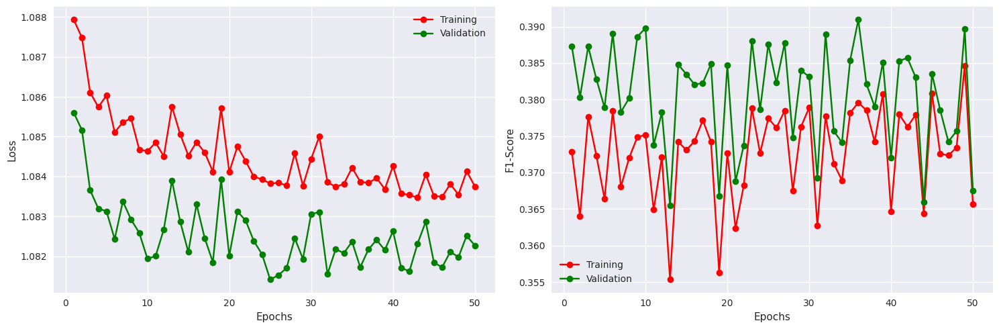


---------------------- Neural Network with 1 Hidden Layer of size 32 -----------------------

Time Taken:   		143.558
Average Loss: 		1.0822088915273684
F1-Score:     		0.37264519929885864
Accuracy:     		0.3878058195114136
Recall:       		0.3878058195114136
Precision:    		0.39041954278945923

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.59      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.40      0.21      0.27     12210		     NEUTRAL       0.39      0.21      0.27      1744
    POSITIVE       0.41      0.37      0.39     12210		    POSITIVE       0.40      0.37      0.39      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   macro av

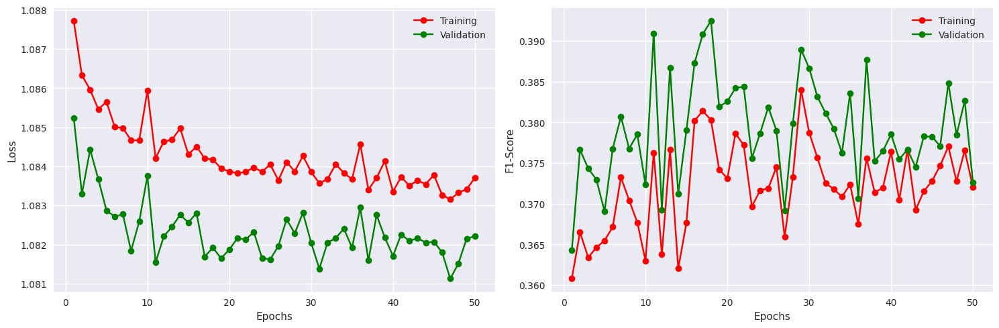


---------------------- Neural Network with 1 Hidden Layer of size 64 -----------------------

Time Taken:   		145.285
Average Loss: 		1.0822704804417556
F1-Score:     		0.3824034035205841
Accuracy:     		0.39105504751205444
Recall:       		0.39105504751205444
Precision:    		0.39091408252716064

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.42      0.40     12210		    NEGATIVE       0.40      0.43      0.41      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.39      0.24      0.30      1744
    POSITIVE       0.38      0.48      0.43     12210		    POSITIVE       0.39      0.51      0.44      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   macro a

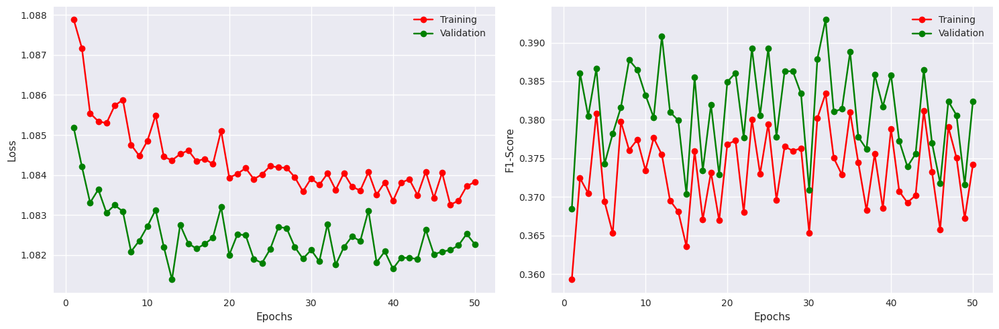


---------------------- Neural Network with 1 Hidden Layer of size 128 -----------------------

Time Taken:   		148.533
Average Loss: 		1.0817800960774087
F1-Score:     		0.37704822421073914
Accuracy:     		0.39124616980552673
Recall:       		0.39124616980552673
Precision:    		0.39252370595932007

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.53      0.45      1744
     NEUTRAL       0.39      0.20      0.26     12210		     NEUTRAL       0.39      0.20      0.27      1744
    POSITIVE       0.40      0.42      0.41     12210		    POSITIVE       0.40      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   macro

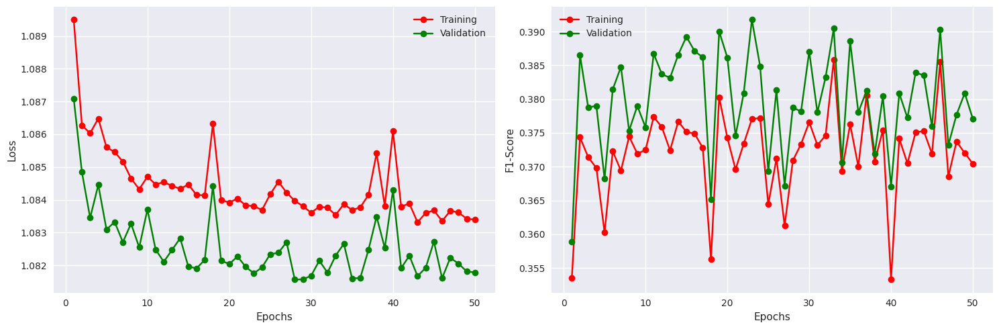


---------------------- Neural Network with 1 Hidden Layer of size 256 -----------------------

Time Taken:   		163.958
Average Loss: 		1.081850341153801
F1-Score:     		0.3797275424003601
Accuracy:     		0.3876146674156189
Recall:       		0.3876146674156189
Precision:    		0.3918613791465759

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.37      0.31      0.34     12210		     NEUTRAL       0.38      0.31      0.34      1744
    POSITIVE       0.42      0.30      0.35     12210		    POSITIVE       0.42      0.30      0.35      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   macro avg 

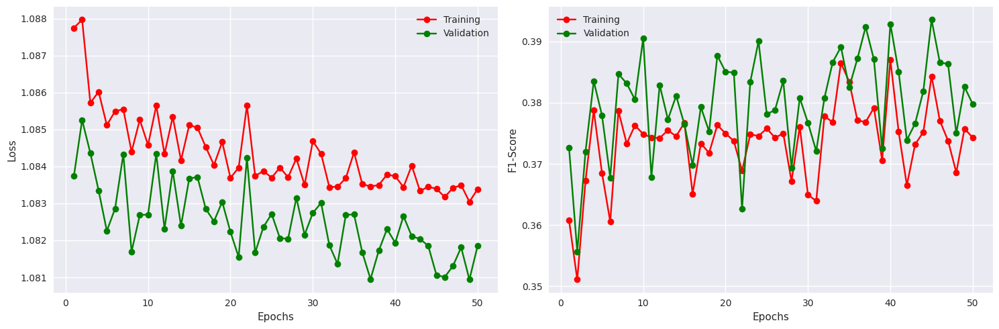

In [25]:
for H1 in [16, 32, 64, 128, 256]:
    print(f"---------------------- Neural Network with 1 Hidden Layer of size {H1} -----------------------\n")
    # Eliminate randomness    
    randonmness_elimination(212)

    model = GenericNeuralNetwork(300, [H1], 3, None, None)

    # preds, targets = 
    evaluation_process( path = f"arch_1/{H1}",
                        train_dataloader = train_dataloader, 
                        val_dataloader = val_dataloader, 
                        model = model,
                        epochs = 50, 
                        optimizer = torch.optim.SGD, 
                        costFunc = nn.CrossEntropyLoss(), 
                        learning_rate = 0.01,  
                        scheduler = None,
                        scheduler_info = None,
                        device = "cuda" if torch.cuda.is_available() else "cpu",  
                        show_progress = False)
    print()

## Architecture 2
The second architecture will confists of `two hidden layer` as well as the input/output dimensions. For our sentiment analysis we will use an `input` `dimension` of `300` which is the number of the Word2Vec and the `output dimension` will be `3` as the number of classes we try to classify our data in. The experiments, for now, will be conducted with the use of `SGD` optimizer, in 50 epochs and with a `learning rate` of `0.01`. For the cost function I have chosen the`CrossEntropyLoss` since it is well-suited for multiclass classification problems like ours. We will test two layers with sizes varying from `16 to 256`, anything more would be too much.

---------------------- Neural Network with 2 Hidden Layers of sizes 16 16 -----------------------

Time Taken:   		144.163
Average Loss: 		1.0819223805669616
F1-Score:     		0.3799508810043335
Accuracy:     		0.38818809390068054
Recall:       		0.38818809390068054
Precision:    		0.3869755268096924

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.52      0.43     12210		    NEGATIVE       0.39      0.52      0.44      1744
     NEUTRAL       0.39      0.25      0.31     12210		     NEUTRAL       0.37      0.25      0.30      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.40      0.39      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   macr

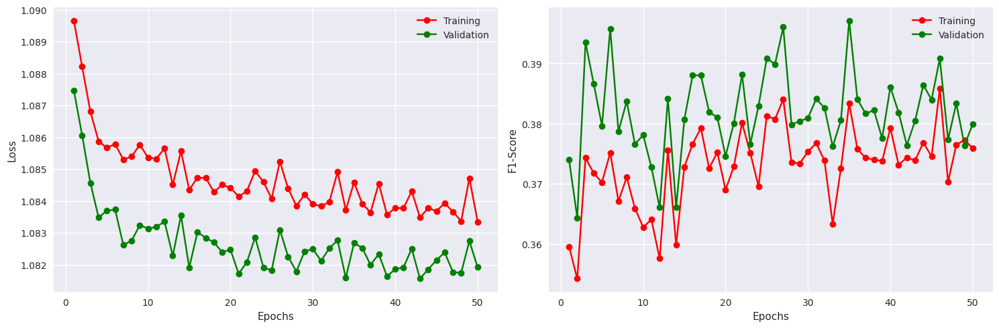


---------------------- Neural Network with 2 Hidden Layers of sizes 16 32 -----------------------

Time Taken:   		142.979
Average Loss: 		1.0819346979488291
F1-Score:     		0.3762797713279724
Accuracy:     		0.3902904987335205
Recall:       		0.3902904987335205
Precision:    		0.3905092477798462

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.39      0.52      0.44      1744
     NEUTRAL       0.39      0.20      0.27     12210		     NEUTRAL       0.39      0.20      0.26      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.39      0.46      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   macro

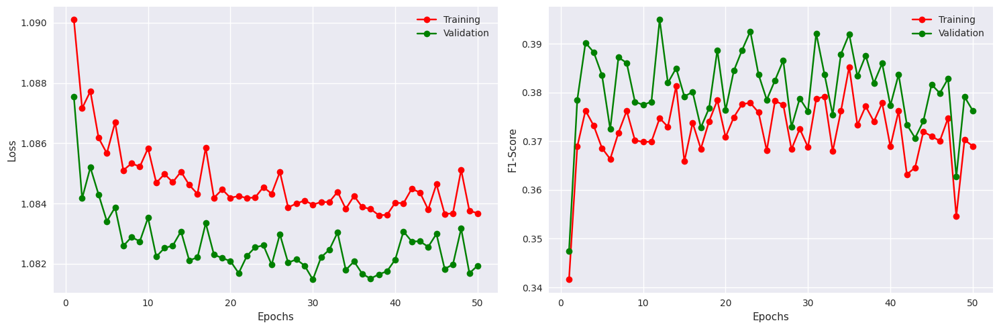


---------------------- Neural Network with 2 Hidden Layers of sizes 16 64 -----------------------

Time Taken:   		145.760
Average Loss: 		1.081855223630911
F1-Score:     		0.380365252494812
Accuracy:     		0.3902905583381653
Recall:       		0.3902905583381653
Precision:    		0.3904722332954407

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.39      0.25      0.31     12210		     NEUTRAL       0.38      0.25      0.30      1744
    POSITIVE       0.41      0.36      0.38     12210		    POSITIVE       0.41      0.37      0.39      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.38     36630		   macro a

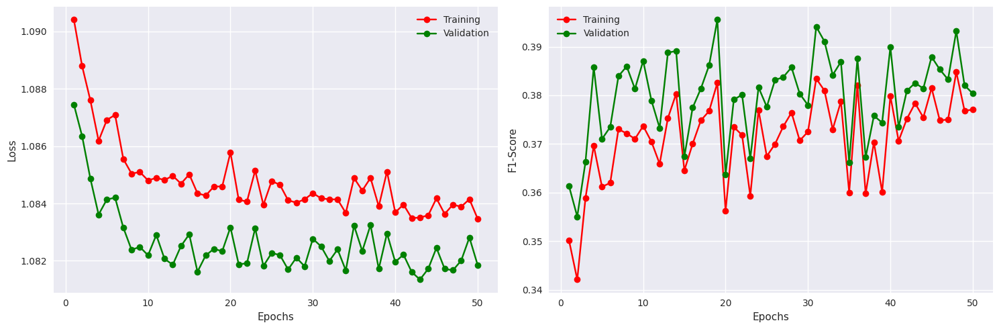


---------------------- Neural Network with 2 Hidden Layers of sizes 16 128 -----------------------

Time Taken:   		145.924
Average Loss: 		1.0817866378238807
F1-Score:     		0.39218491315841675
Accuracy:     		0.3929663896560669
Recall:       		0.3929663896560669
Precision:    		0.39242619276046753

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.41      0.39     12210		    NEGATIVE       0.40      0.41      0.40      1744
     NEUTRAL       0.38      0.35      0.37     12210		     NEUTRAL       0.38      0.34      0.36      1744
    POSITIVE       0.39      0.40      0.40     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.39     36630		   ma

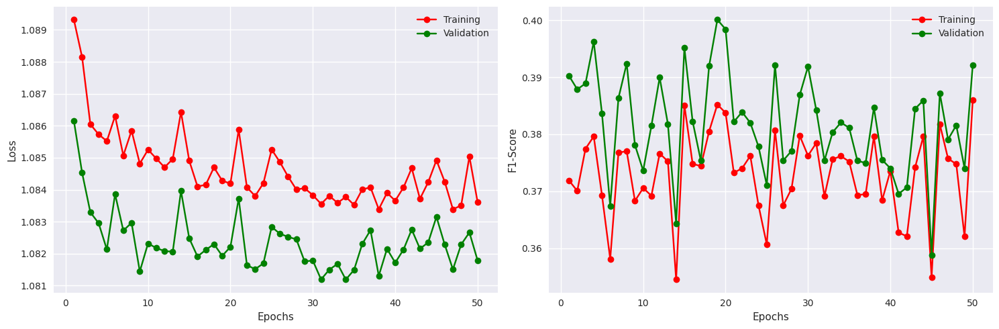


---------------------- Neural Network with 2 Hidden Layers of sizes 16 256 -----------------------

Time Taken:   		146.828
Average Loss: 		1.0816218069204862
F1-Score:     		0.38834524154663086
Accuracy:     		0.39373087882995605
Recall:       		0.39373087882995605
Precision:    		0.39228659868240356

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.46      0.41     12210		    NEGATIVE       0.39      0.47      0.43      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.38      0.27      0.32      1744
    POSITIVE       0.39      0.42      0.40     12210		    POSITIVE       0.40      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   

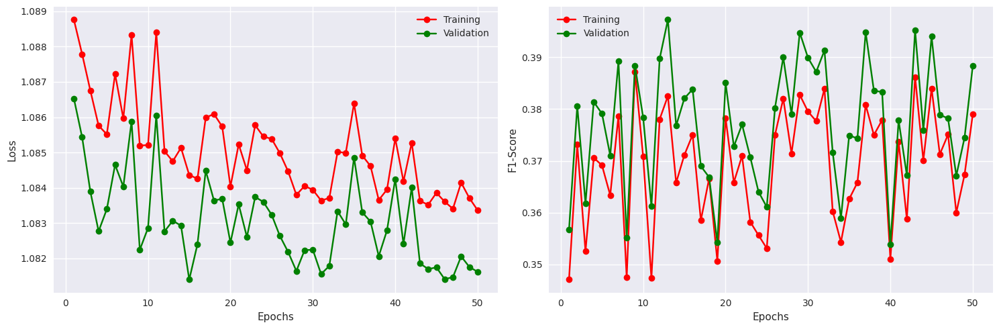


---------------------- Neural Network with 2 Hidden Layers of sizes 32 16 -----------------------

Time Taken:   		152.683
Average Loss: 		1.0831812787857988
F1-Score:     		0.37318164110183716
Accuracy:     		0.38130733370780945
Recall:       		0.38130733370780945
Precision:    		0.39209213852882385

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.42      0.40     12210		    NEGATIVE       0.38      0.42      0.40      1744
     NEUTRAL       0.36      0.50      0.42     12210		     NEUTRAL       0.36      0.49      0.41      1744
    POSITIVE       0.42      0.23      0.30     12210		    POSITIVE       0.43      0.24      0.31      1744
		
    accuracy                           0.38     36630		    accuracy                           0.38      5232
   macro avg       0.39      0.38      0.37     36630		   m

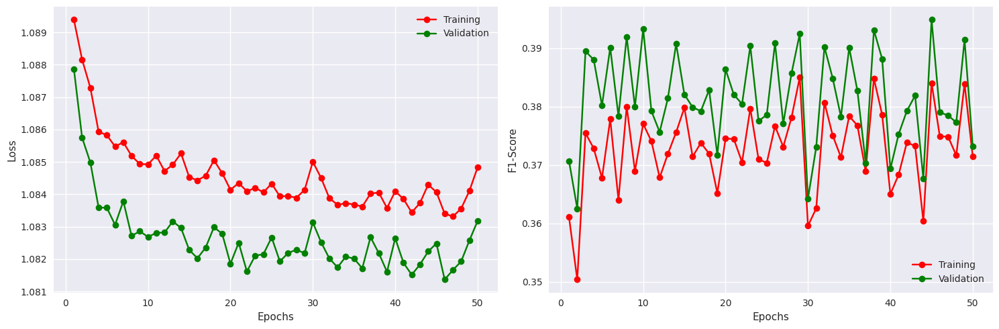


---------------------- Neural Network with 2 Hidden Layers of sizes 32 32 -----------------------

Time Taken:   		153.715
Average Loss: 		1.0819116283994201
F1-Score:     		0.3852098882198334
Accuracy:     		0.3904816508293152
Recall:       		0.3904816508293152
Precision:    		0.3896832764148712

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.45      0.41     12210		    NEGATIVE       0.39      0.45      0.42      1744
     NEUTRAL       0.38      0.27      0.31     12210		     NEUTRAL       0.38      0.27      0.32      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.40      0.45      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   macro

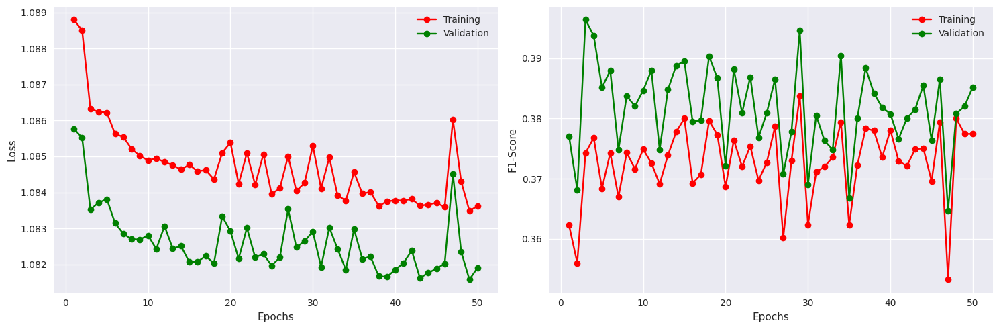


---------------------- Neural Network with 2 Hidden Layers of sizes 32 64 -----------------------

Time Taken:   		153.266
Average Loss: 		1.0816609912326942
F1-Score:     		0.3782917857170105
Accuracy:     		0.39067280292510986
Recall:       		0.39067280292510986
Precision:    		0.3918030858039856

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.55      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.39      0.22      0.28     12210		     NEUTRAL       0.39      0.22      0.28      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   mac

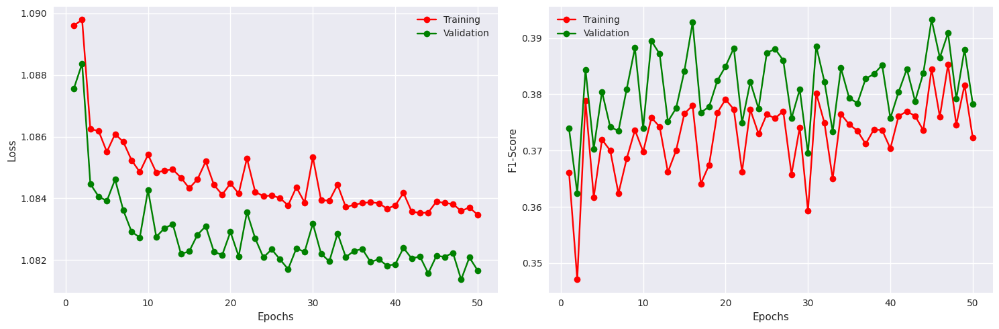


---------------------- Neural Network with 2 Hidden Layers of sizes 32 128 -----------------------

Time Taken:   		155.415
Average Loss: 		1.081572185962572
F1-Score:     		0.3791466951370239
Accuracy:     		0.3906727731227875
Recall:       		0.3906727731227875
Precision:    		0.39238905906677246

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.57      0.45     12210		    NEGATIVE       0.38      0.57      0.46      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.39      0.24      0.30      1744
    POSITIVE       0.41      0.35      0.37     12210		    POSITIVE       0.41      0.36      0.38      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   macr

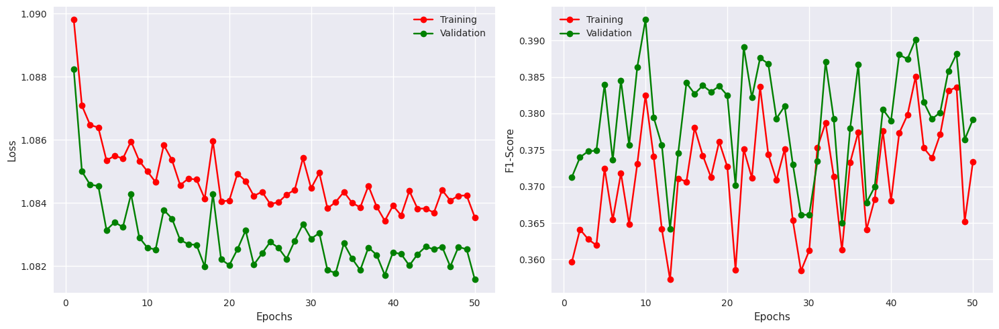


---------------------- Neural Network with 2 Hidden Layers of sizes 32 256 -----------------------

Time Taken:   		164.903
Average Loss: 		1.0833115718051198
F1-Score:     		0.3709906339645386
Accuracy:     		0.38933485746383667
Recall:       		0.38933485746383667
Precision:    		0.3973395526409149

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.63      0.46     12210		    NEGATIVE       0.38      0.64      0.48      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.42      0.24      0.31     12210		    POSITIVE       0.43      0.25      0.31      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.36     36630		   ma

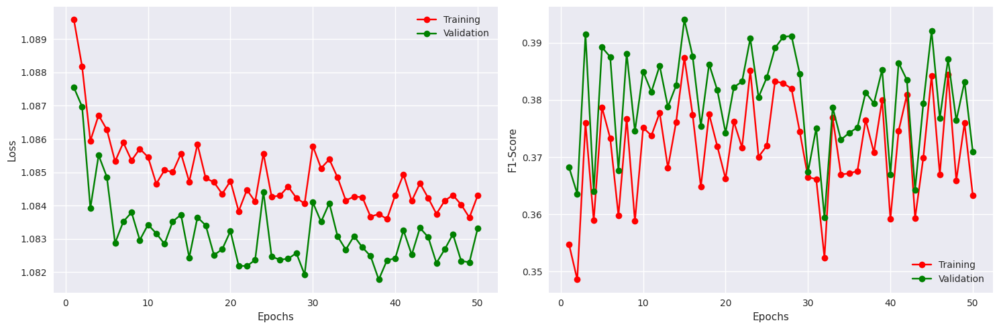


---------------------- Neural Network with 2 Hidden Layers of sizes 64 16 -----------------------

Time Taken:   		155.881
Average Loss: 		1.082382037734402
F1-Score:     		0.3756839334964752
Accuracy:     		0.39105504751205444
Recall:       		0.39105504751205444
Precision:    		0.3936614394187927

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.39      0.51      0.44      1744
     NEUTRAL       0.40      0.19      0.26     12210		     NEUTRAL       0.40      0.19      0.26      1744
    POSITIVE       0.39      0.45      0.42     12210		    POSITIVE       0.39      0.47      0.43      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   macr

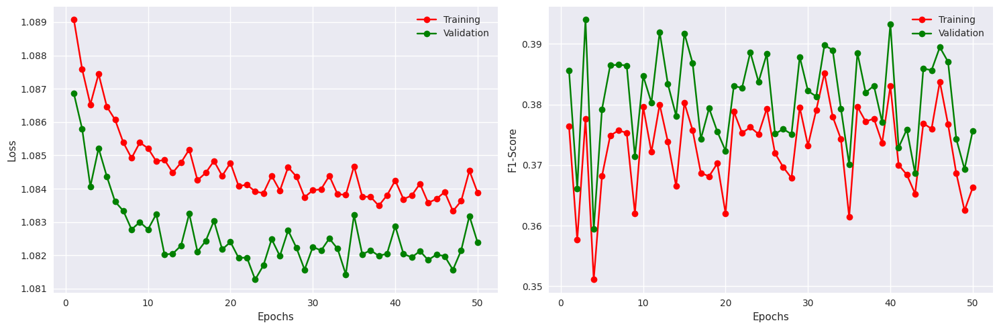


---------------------- Neural Network with 2 Hidden Layers of sizes 64 32 -----------------------

Time Taken:   		157.684
Average Loss: 		1.0813418867391185
F1-Score:     		0.3799976408481598
Accuracy:     		0.3878057897090912
Recall:       		0.3878057897090912
Precision:    		0.3869430422782898

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.39      0.48      0.43      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.38      0.24      0.30      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.39      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   macro

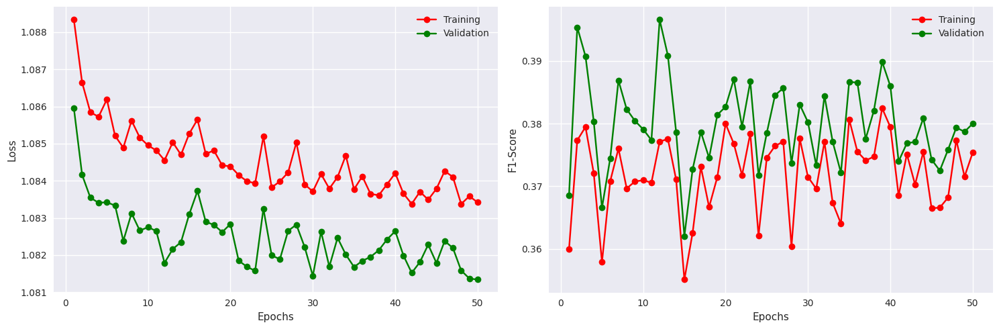


---------------------- Neural Network with 2 Hidden Layers of sizes 64 64 -----------------------

Time Taken:   		159.287
Average Loss: 		1.0818888018255204
F1-Score:     		0.38514161109924316
Accuracy:     		0.39067280292510986
Recall:       		0.39067280292510986
Precision:    		0.39190685749053955

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.38      0.52      0.44      1744
     NEUTRAL       0.38      0.29      0.33     12210		     NEUTRAL       0.38      0.29      0.33      1744
    POSITIVE       0.40      0.34      0.37     12210		    POSITIVE       0.41      0.36      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

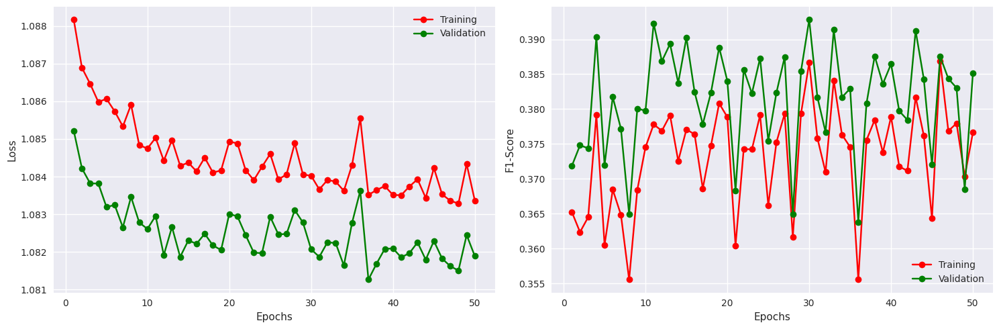


---------------------- Neural Network with 2 Hidden Layers of sizes 64 128 -----------------------

Time Taken:   		169.952
Average Loss: 		1.0816798193739094
F1-Score:     		0.3858848512172699
Accuracy:     		0.38952600955963135
Recall:       		0.38952600955963135
Precision:    		0.39104411005973816

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.38      0.50      0.43      1744
     NEUTRAL       0.37      0.32      0.35     12210		     NEUTRAL       0.38      0.33      0.35      1744
    POSITIVE       0.41      0.33      0.36     12210		    POSITIVE       0.41      0.34      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

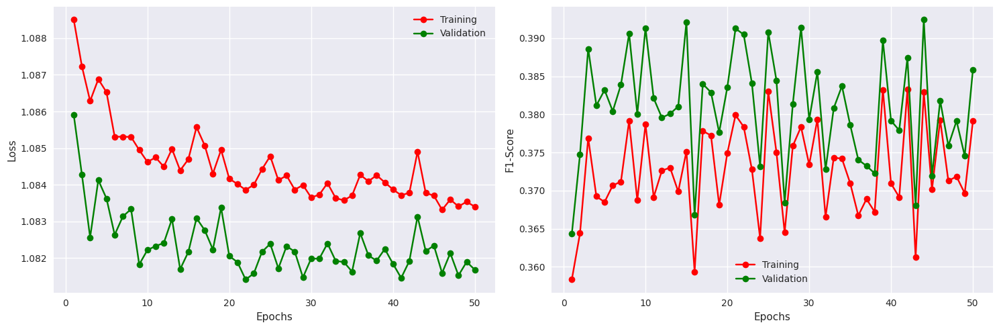


---------------------- Neural Network with 2 Hidden Layers of sizes 64 256 -----------------------

Time Taken:   		176.352
Average Loss: 		1.081742343005784
F1-Score:     		0.377926230430603
Accuracy:     		0.38799694180488586
Recall:       		0.38799694180488586
Precision:    		0.3889615535736084

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.55      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.38      0.24      0.30      1744
    POSITIVE       0.41      0.36      0.38     12210		    POSITIVE       0.41      0.37      0.39      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.38     36630		   macr

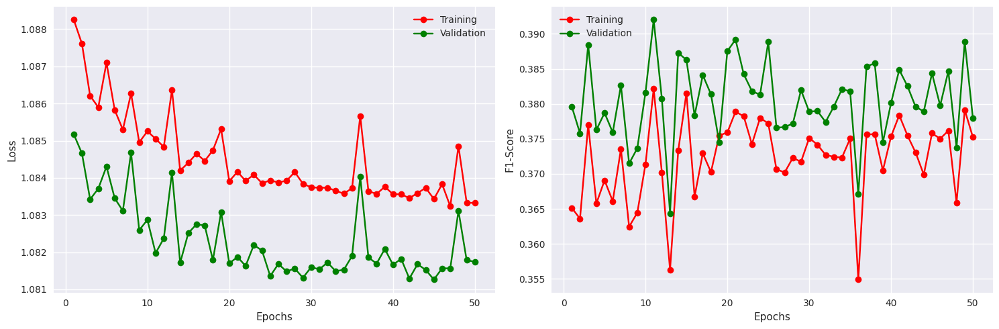


---------------------- Neural Network with 2 Hidden Layers of sizes 128 16 -----------------------

Time Taken:   		163.960
Average Loss: 		1.0814678291662023
F1-Score:     		0.3856978416442871
Accuracy:     		0.3929663598537445
Recall:       		0.3929663598537445
Precision:    		0.39252573251724243

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.39      0.48      0.43      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.39      0.25      0.30      1744
    POSITIVE       0.39      0.42      0.41     12210		    POSITIVE       0.40      0.45      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   mac

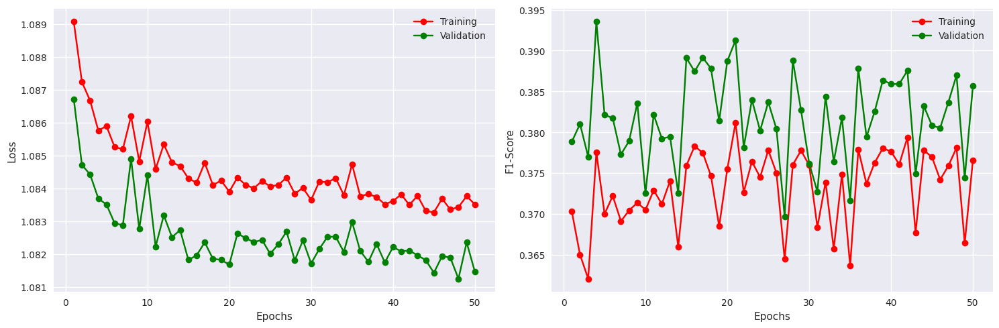


---------------------- Neural Network with 2 Hidden Layers of sizes 128 32 -----------------------

Time Taken:   		162.588
Average Loss: 		1.0816545305995766
F1-Score:     		0.3820842504501343
Accuracy:     		0.3920106887817383
Recall:       		0.3920106887817383
Precision:    		0.3922990560531616

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.52      0.43     12210		    NEGATIVE       0.38      0.53      0.44      1744
     NEUTRAL       0.39      0.24      0.29     12210		     NEUTRAL       0.39      0.23      0.29      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   macr

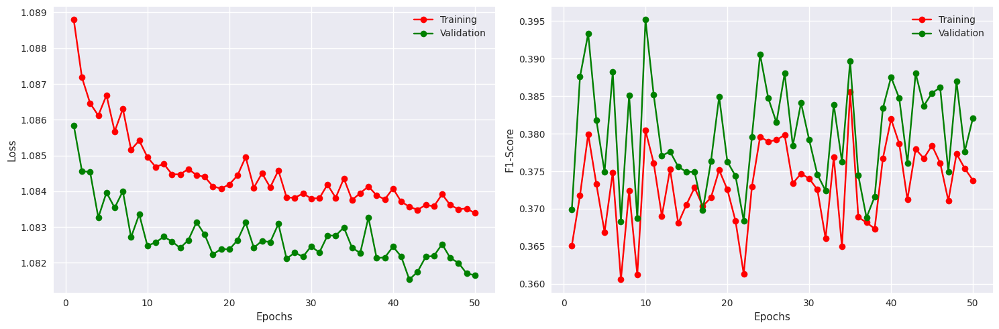


---------------------- Neural Network with 2 Hidden Layers of sizes 128 64 -----------------------

Time Taken:   		173.303
Average Loss: 		1.0819505586172098
F1-Score:     		0.37835800647735596
Accuracy:     		0.3874235153198242
Recall:       		0.3874235153198242
Precision:    		0.3874610662460327

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.52      0.43     12210		    NEGATIVE       0.38      0.53      0.44      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.38      0.24      0.30      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.40      0.39      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   mac

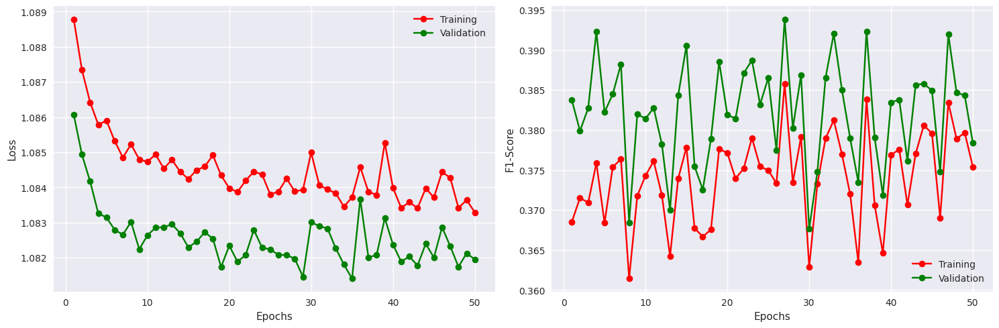


---------------------- Neural Network with 2 Hidden Layers of sizes 128 128 -----------------------

Time Taken:   		180.748
Average Loss: 		1.0823320157666454
F1-Score:     		0.3708774447441101
Accuracy:     		0.3927752375602722
Recall:       		0.3927752375602722
Precision:    		0.40055733919143677

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.65      0.47     12210		    NEGATIVE       0.38      0.65      0.48      1744
     NEUTRAL       0.40      0.19      0.26     12210		     NEUTRAL       0.40      0.20      0.27      1744
    POSITIVE       0.41      0.32      0.36     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.36     36630		   ma

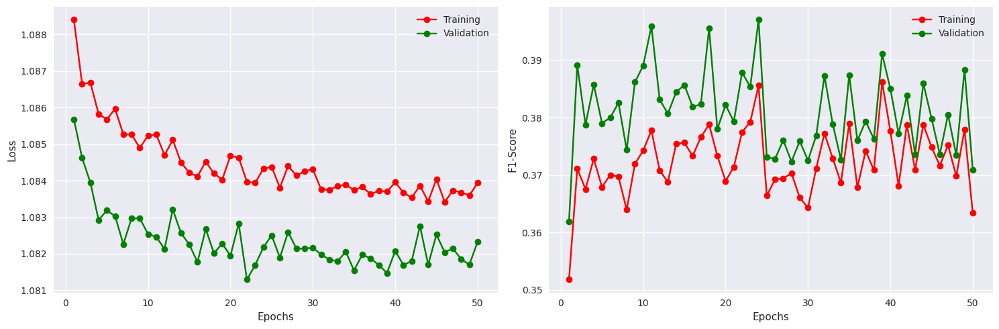


---------------------- Neural Network with 2 Hidden Layers of sizes 128 256 -----------------------

Time Taken:   		187.922
Average Loss: 		1.0821315560501286
F1-Score:     		0.37942928075790405
Accuracy:     		0.38952600955963135
Recall:       		0.38952600955963135
Precision:    		0.3904895484447479

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.47      0.42     12210		    NEGATIVE       0.39      0.47      0.43      1744
     NEUTRAL       0.39      0.22      0.28     12210		     NEUTRAL       0.39      0.22      0.29      1744
    POSITIVE       0.39      0.46      0.42     12210		    POSITIVE       0.39      0.47      0.43      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   

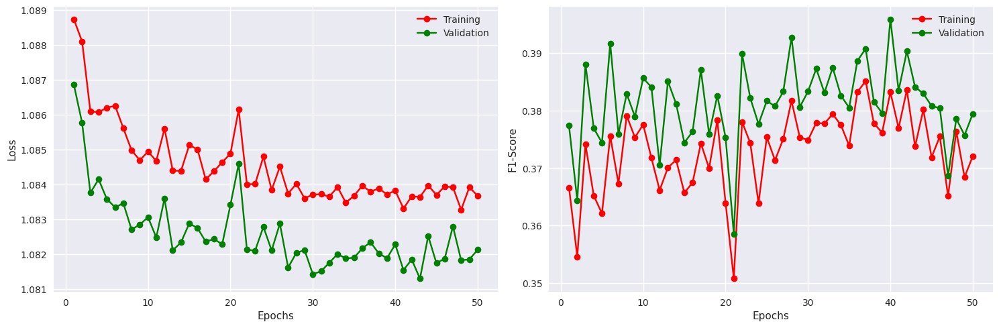


---------------------- Neural Network with 2 Hidden Layers of sizes 256 16 -----------------------

Time Taken:   		177.386
Average Loss: 		1.0823405056918434
F1-Score:     		0.3860832750797272
Accuracy:     		0.3918195962905884
Recall:       		0.3918195962905884
Precision:    		0.3922426998615265

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.39      0.39     12210		    NEGATIVE       0.40      0.39      0.40      1744
     NEUTRAL       0.39      0.27      0.32     12210		     NEUTRAL       0.39      0.28      0.32      1744
    POSITIVE       0.38      0.49      0.43     12210		    POSITIVE       0.39      0.51      0.44      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   macr

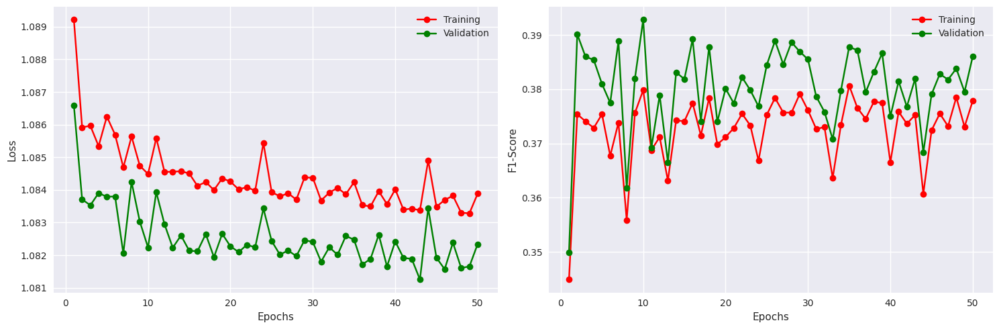


---------------------- Neural Network with 2 Hidden Layers of sizes 256 32 -----------------------

Time Taken:   		183.504
Average Loss: 		1.0817070175019243
F1-Score:     		0.384552001953125
Accuracy:     		0.3920106887817383
Recall:       		0.3920106887817383
Precision:    		0.395602285861969

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.39      0.28      0.33      1744
    POSITIVE       0.41      0.33      0.36     12210		    POSITIVE       0.42      0.35      0.38      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   macro 

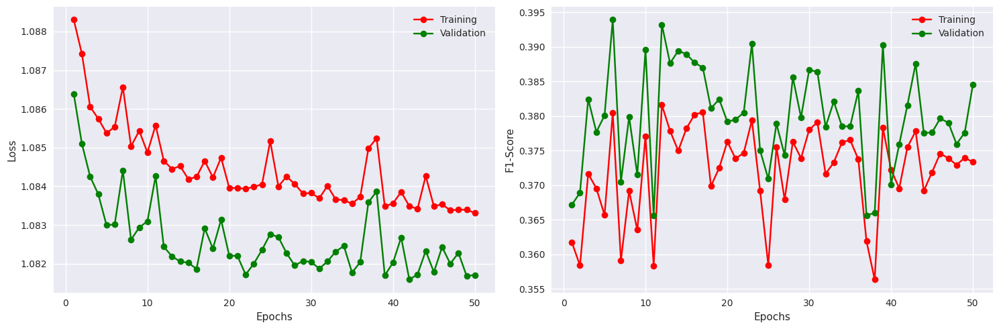


---------------------- Neural Network with 2 Hidden Layers of sizes 256 64 -----------------------

Time Taken:   		191.655
Average Loss: 		1.081967358560008
F1-Score:     		0.39190226793289185
Accuracy:     		0.3931574821472168
Recall:       		0.3931574821472168
Precision:    		0.3928149938583374

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.39      0.39     12210		    NEGATIVE       0.40      0.40      0.40      1744
     NEUTRAL       0.38      0.34      0.36     12210		     NEUTRAL       0.39      0.34      0.36      1744
    POSITIVE       0.39      0.42      0.41     12210		    POSITIVE       0.39      0.45      0.42      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.39     36630		   macr

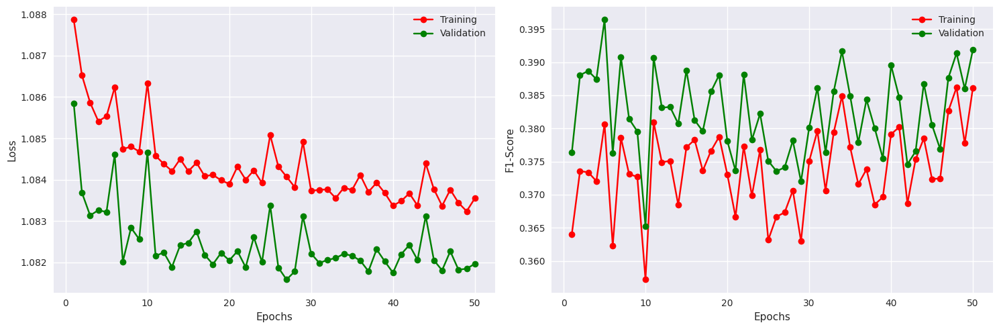


---------------------- Neural Network with 2 Hidden Layers of sizes 256 128 -----------------------

Time Taken:   		200.240
Average Loss: 		1.0826377697311775
F1-Score:     		0.37245091795921326
Accuracy:     		0.39105504751205444
Recall:       		0.39105504751205444
Precision:    		0.3954518735408783

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.55      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.40      0.17      0.24     12210		     NEUTRAL       0.41      0.18      0.25      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.40      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.36     36630		   

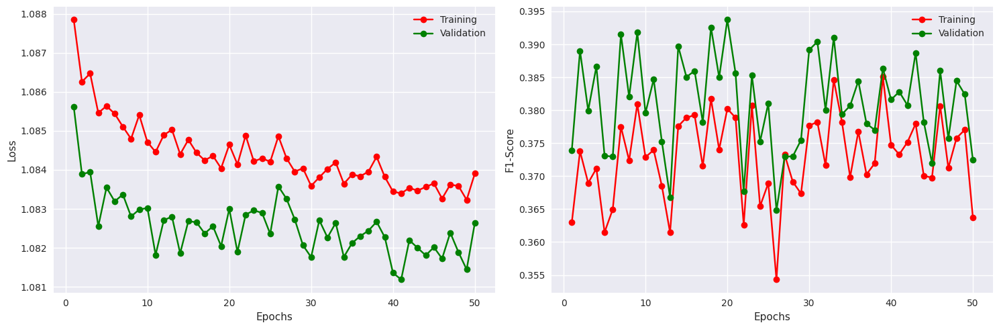


---------------------- Neural Network with 2 Hidden Layers of sizes 256 256 -----------------------

Time Taken:   		210.142
Average Loss: 		1.081893335970899
F1-Score:     		0.3708319067955017
Accuracy:     		0.38799694180488586
Recall:       		0.38799694180488586
Precision:    		0.3911726474761963

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.57      0.46      1744
     NEUTRAL       0.40      0.18      0.25     12210		     NEUTRAL       0.40      0.19      0.26      1744
    POSITIVE       0.40      0.40      0.40     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   ma

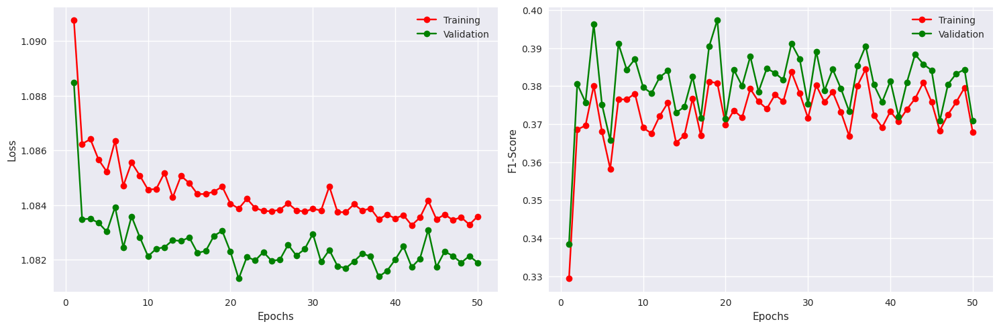

In [26]:
for H1 in [16, 32, 64, 128, 256]:
    for H2 in [16, 32, 64, 128, 256]:

        print(f"---------------------- Neural Network with 2 Hidden Layers of sizes {H1} {H2} -----------------------\n")
        # Eliminate randomness    
        randonmness_elimination(212)

        model = GenericNeuralNetwork(300, [H1, H2], 3, None, None)

        # preds, targets = 
        evaluation_process( path = f"arch_2/{H1}_{H2}",
                            train_dataloader = train_dataloader, 
                            val_dataloader = val_dataloader, 
                            model = model,
                            epochs = 50, 
                            optimizer = torch.optim.SGD, 
                            costFunc = nn.CrossEntropyLoss(), 
                            learning_rate = 0.01,  
                            scheduler = None,
                            scheduler_info = None,
                            device = "cuda" if torch.cuda.is_available() else "cpu",  
                            show_progress = False)
        print()

## Architecture 3
The second architecture will confists of `three hidden layer` as well as the input/output dimensions. For our sentiment analysis we will use an `input` `dimension` of `300` which is the number of the Word2Vec and the `output dimension` will be `3` as the number of classes we try to classify our data in. The experiments, for now, will be conducted with the use of `SGD` optimizer, in 50 epochs and with a `learning rate` of `0.01`. For the cost function I have chosen the`CrossEntropyLoss` since it is well-suited for multiclass classification problems like ours. We will test three layers with sizes varying from `16 to 256`, anything more would be too much.

---------------------- Neural Network with 3 Hidden Layer of sizes 16 16 16 -----------------------

Time Taken:   		153.287
Average Loss: 		1.082075762639352
F1-Score:     		0.37719812989234924
Accuracy:     		0.38971713185310364
Recall:       		0.38971713185310364
Precision:    		0.39569997787475586

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.60      0.46      1744
     NEUTRAL       0.38      0.30      0.34     12210		     NEUTRAL       0.38      0.31      0.34      1744
    POSITIVE       0.42      0.26      0.32     12210		    POSITIVE       0.43      0.27      0.33      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   m

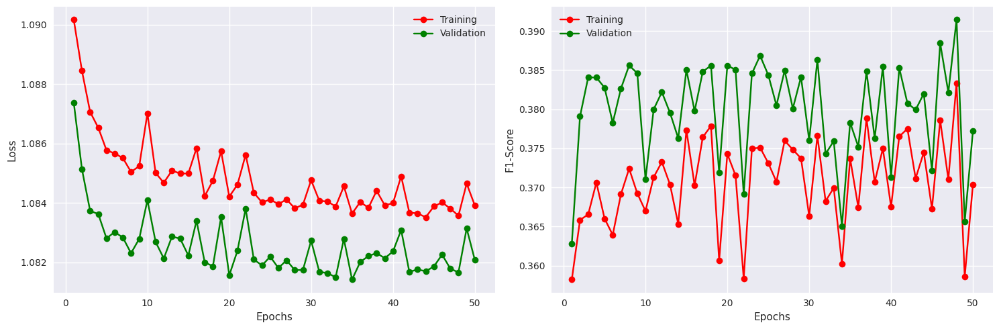


---------------------- Neural Network with 3 Hidden Layer of sizes 16 16 32 -----------------------

Time Taken:   		155.438
Average Loss: 		1.0822278315867853
F1-Score:     		0.38434112071990967
Accuracy:     		0.38704127073287964
Recall:       		0.38704127073287964
Precision:    		0.3890934884548187

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.47      0.42     12210		    NEGATIVE       0.38      0.48      0.43      1744
     NEUTRAL       0.37      0.36      0.36     12210		     NEUTRAL       0.37      0.36      0.36      1744
    POSITIVE       0.41      0.31      0.35     12210		    POSITIVE       0.41      0.32      0.36      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   

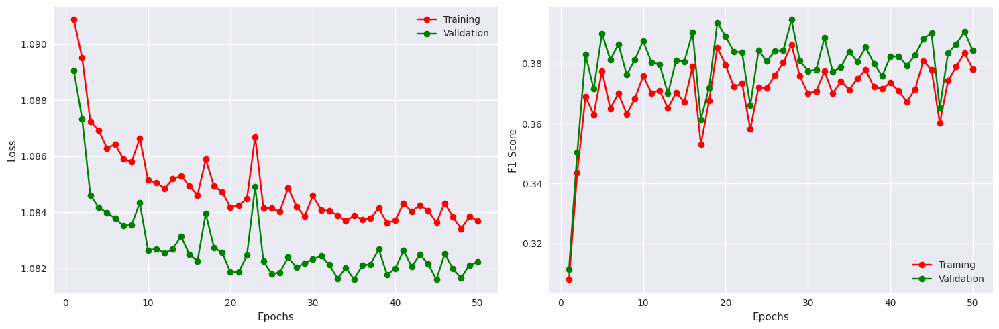


---------------------- Neural Network with 3 Hidden Layer of sizes 16 16 64 -----------------------

Time Taken:   		157.839
Average Loss: 		1.081754787617138
F1-Score:     		0.377485990524292
Accuracy:     		0.3885703384876251
Recall:       		0.3885703384876251
Precision:    		0.3889598250389099

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.39      0.23      0.29     12210		     NEUTRAL       0.38      0.23      0.29      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   macro

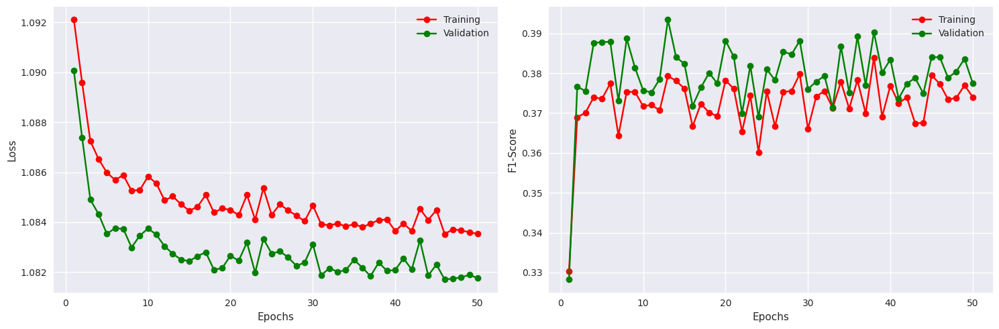


---------------------- Neural Network with 3 Hidden Layer of sizes 16 16 128 -----------------------

Time Taken:   		156.238
Average Loss: 		1.0818814945148036
F1-Score:     		0.39340704679489136
Accuracy:     		0.3933486342430115
Recall:       		0.3933486342430115
Precision:    		0.3935685157775879

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.38      0.38     12210		    NEGATIVE       0.40      0.39      0.39      1744
     NEUTRAL       0.37      0.40      0.38     12210		     NEUTRAL       0.38      0.39      0.38      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.41      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

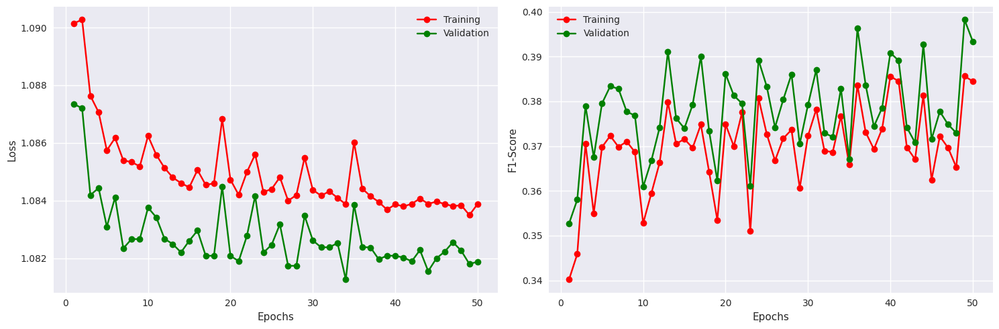


---------------------- Neural Network with 3 Hidden Layer of sizes 16 16 256 -----------------------

Time Taken:   		160.132
Average Loss: 		1.0844975296145916
F1-Score:     		0.36308982968330383
Accuracy:     		0.37844038009643555
Recall:       		0.37844038009643555
Precision:    		0.3960295021533966

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.37      0.38     12210		    NEGATIVE       0.38      0.37      0.38      1744
     NEUTRAL       0.36      0.57      0.44     12210		     NEUTRAL       0.36      0.57      0.44      1744
    POSITIVE       0.43      0.19      0.27     12210		    POSITIVE       0.45      0.20      0.28      1744
		
    accuracy                           0.38     36630		    accuracy                           0.38      5232
   macro avg       0.39      0.38      0.36     36630		  

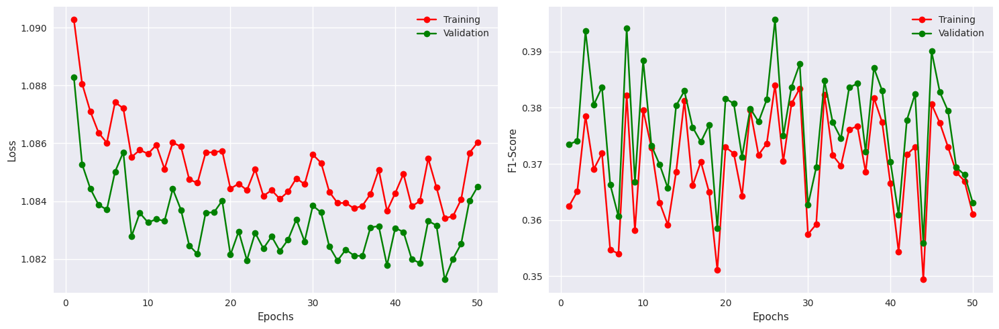


---------------------- Neural Network with 3 Hidden Layer of sizes 16 32 16 -----------------------

Time Taken:   		156.200
Average Loss: 		1.0816466223209276
F1-Score:     		0.3869067430496216
Accuracy:     		0.39239296317100525
Recall:       		0.39239296317100525
Precision:    		0.3916725218296051

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.49      0.42     12210		    NEGATIVE       0.39      0.51      0.44      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.40      0.37      0.39     12210		    POSITIVE       0.41      0.39      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

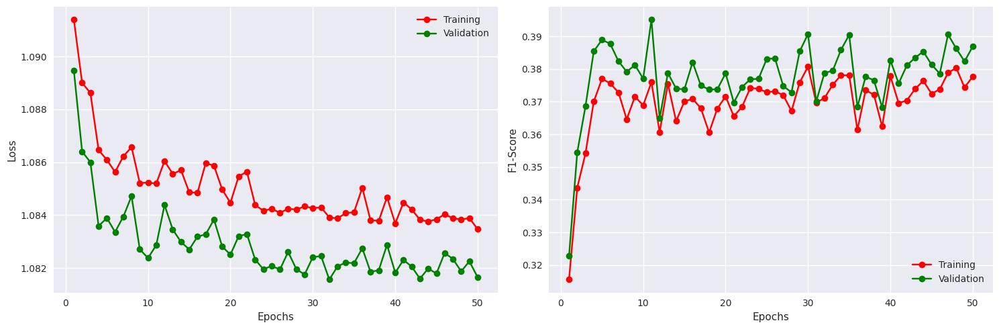


---------------------- Neural Network with 3 Hidden Layer of sizes 16 32 32 -----------------------

Time Taken:   		157.847
Average Loss: 		1.0816898765184828
F1-Score:     		0.3779878318309784
Accuracy:     		0.3900994062423706
Recall:       		0.3900994062423706
Precision:    		0.3920098543167114

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.40      0.21      0.28     12210		     NEUTRAL       0.40      0.22      0.28      1744
    POSITIVE       0.40      0.40      0.40     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   mac

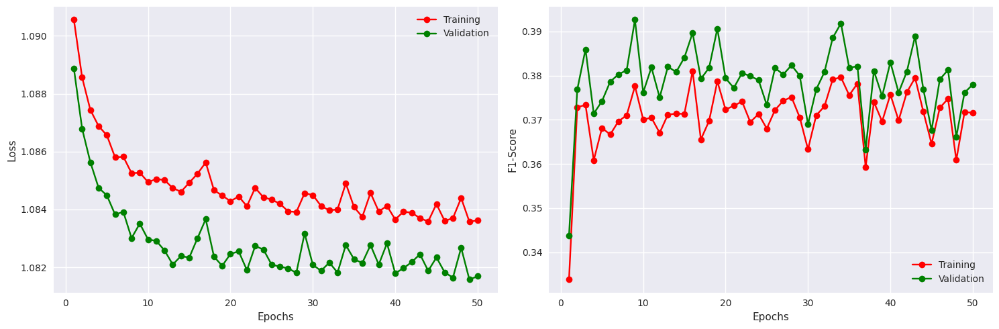


---------------------- Neural Network with 3 Hidden Layer of sizes 16 32 64 -----------------------

Time Taken:   		159.122
Average Loss: 		1.0814366717951014
F1-Score:     		0.38326287269592285
Accuracy:     		0.3920106887817383
Recall:       		0.3920106887817383
Precision:    		0.3926711082458496

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.52      0.43     12210		    NEGATIVE       0.38      0.53      0.45      1744
     NEUTRAL       0.38      0.25      0.30     12210		     NEUTRAL       0.39      0.25      0.30      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.41      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   ma

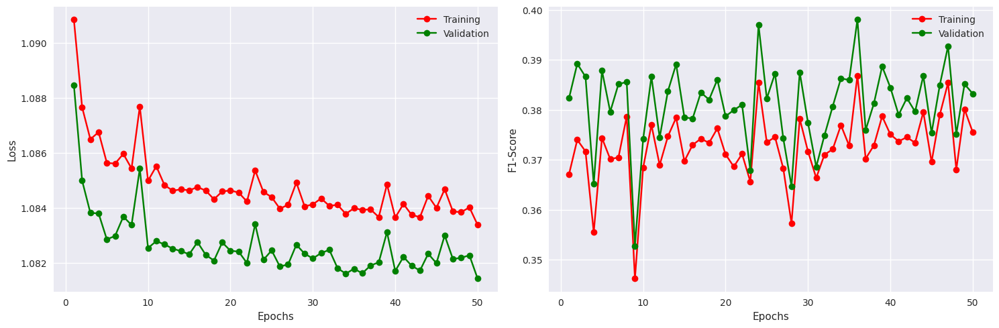


---------------------- Neural Network with 3 Hidden Layer of sizes 16 32 128 -----------------------

Time Taken:   		160.096
Average Loss: 		1.0817574625350648
F1-Score:     		0.3910161554813385
Accuracy:     		0.39392203092575073
Recall:       		0.39392203092575073
Precision:    		0.3933689594268799

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.44      0.41     12210		    NEGATIVE       0.40      0.45      0.42      1744
     NEUTRAL       0.38      0.30      0.34     12210		     NEUTRAL       0.39      0.30      0.34      1744
    POSITIVE       0.39      0.41      0.40     12210		    POSITIVE       0.40      0.43      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   

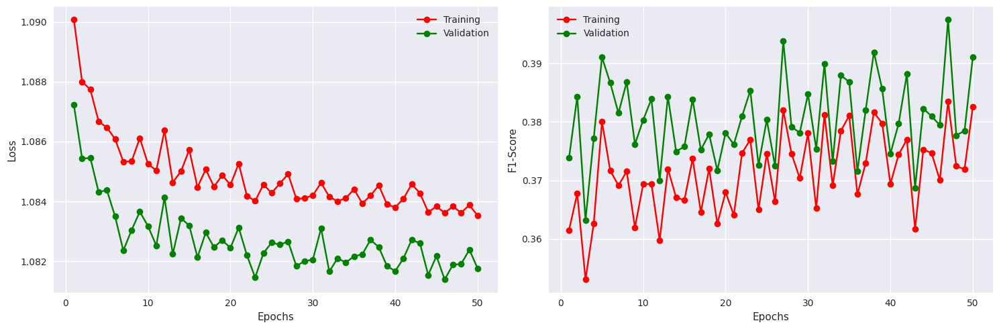


---------------------- Neural Network with 3 Hidden Layer of sizes 16 32 256 -----------------------

Time Taken:   		172.459
Average Loss: 		1.083066586872124
F1-Score:     		0.37055471539497375
Accuracy:     		0.3935397267341614
Recall:       		0.3935397267341614
Precision:    		0.40545886754989624

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.67      0.47     12210		    NEGATIVE       0.38      0.68      0.48      1744
     NEUTRAL       0.39      0.22      0.28     12210		     NEUTRAL       0.40      0.23      0.29      1744
    POSITIVE       0.43      0.26      0.32     12210		    POSITIVE       0.44      0.27      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.36     36630		   m

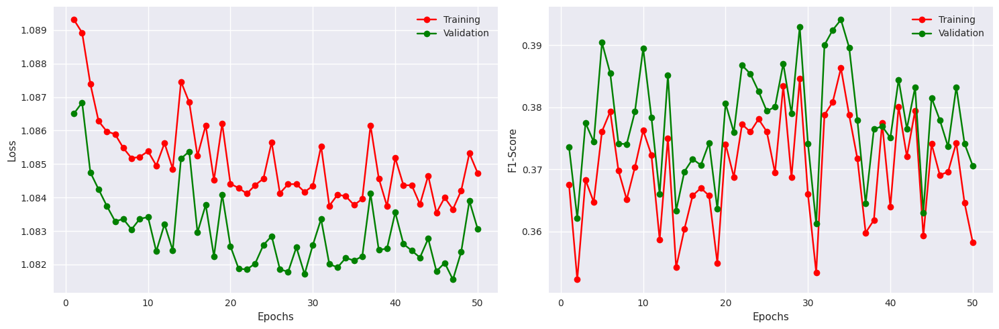


---------------------- Neural Network with 3 Hidden Layer of sizes 16 64 16 -----------------------

Time Taken:   		155.865
Average Loss: 		1.0820739017714054
F1-Score:     		0.37561672925949097
Accuracy:     		0.3876146674156189
Recall:       		0.3876146674156189
Precision:    		0.3918410539627075

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.59      0.46      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.37      0.28      0.32      1744
    POSITIVE       0.42      0.28      0.34     12210		    POSITIVE       0.42      0.29      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   ma

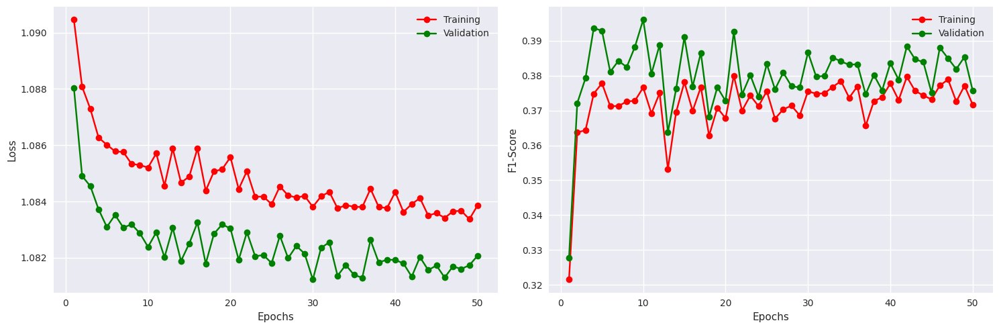


---------------------- Neural Network with 3 Hidden Layer of sizes 16 64 32 -----------------------

Time Taken:   		158.407
Average Loss: 		1.081614824610019
F1-Score:     		0.38495391607284546
Accuracy:     		0.39067280292510986
Recall:       		0.39067280292510986
Precision:    		0.3897089660167694

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.47      0.42     12210		    NEGATIVE       0.39      0.48      0.43      1744
     NEUTRAL       0.38      0.27      0.31     12210		     NEUTRAL       0.38      0.27      0.31      1744
    POSITIVE       0.40      0.41      0.40     12210		    POSITIVE       0.40      0.43      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

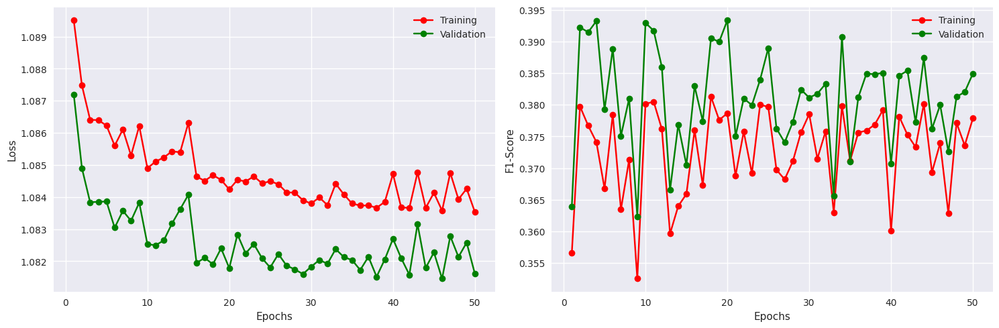


---------------------- Neural Network with 3 Hidden Layer of sizes 16 64 64 -----------------------

Time Taken:   		160.869
Average Loss: 		1.0819165411345455
F1-Score:     		0.37125805020332336
Accuracy:     		0.3860856294631958
Recall:       		0.3860856294631958
Precision:    		0.3880123496055603

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.59      0.46     12210		    NEGATIVE       0.38      0.60      0.46      1744
     NEUTRAL       0.39      0.23      0.29     12210		     NEUTRAL       0.38      0.22      0.28      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.41      0.34      0.37      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   ma

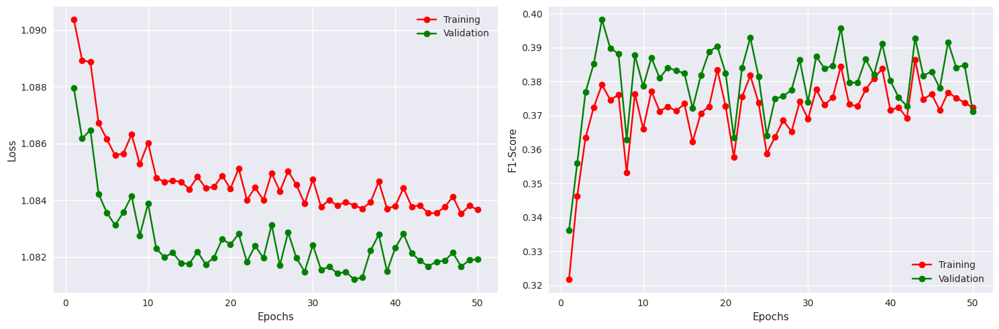


---------------------- Neural Network with 3 Hidden Layer of sizes 16 64 128 -----------------------

Time Taken:   		173.085
Average Loss: 		1.0813940293198332
F1-Score:     		0.38312190771102905
Accuracy:     		0.3889526128768921
Recall:       		0.3889526128768921
Precision:    		0.3878723382949829

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.49      0.42     12210		    NEGATIVE       0.39      0.49      0.43      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.38      0.27      0.31      1744
    POSITIVE       0.40      0.39      0.40     12210		    POSITIVE       0.40      0.41      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

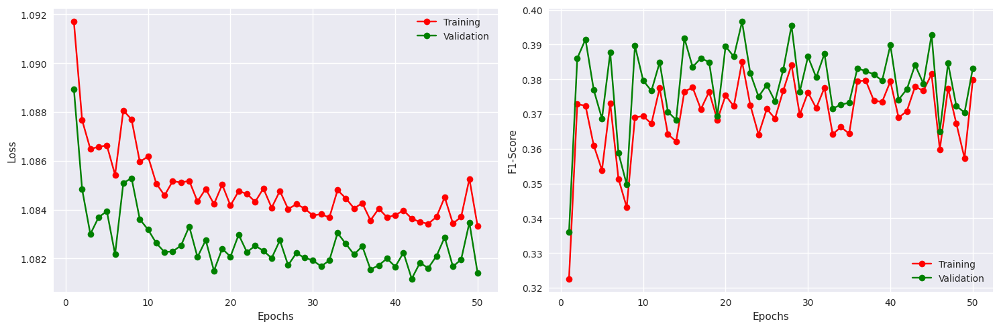


---------------------- Neural Network with 3 Hidden Layer of sizes 16 64 256 -----------------------

Time Taken:   		181.569
Average Loss: 		1.0819579443071232
F1-Score:     		0.37494760751724243
Accuracy:     		0.38971713185310364
Recall:       		0.38971713185310364
Precision:    		0.39283818006515503

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.57      0.45     12210		    NEGATIVE       0.38      0.57      0.46      1744
     NEUTRAL       0.40      0.20      0.27     12210		     NEUTRAL       0.40      0.21      0.28      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.40      0.38      0.39      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		 

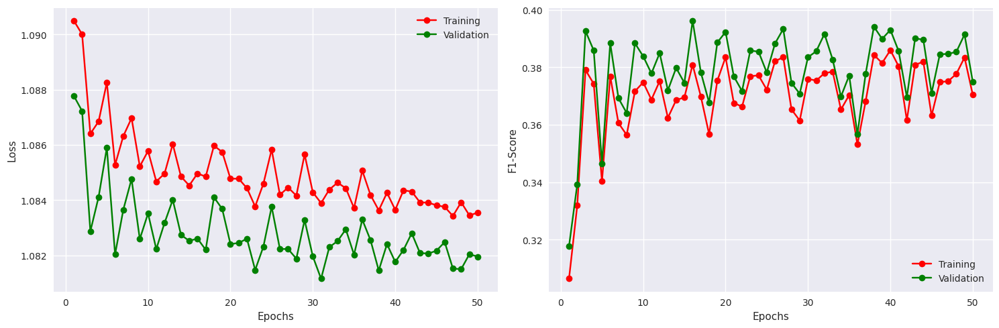


---------------------- Neural Network with 3 Hidden Layer of sizes 16 128 16 -----------------------

Time Taken:   		158.175
Average Loss: 		1.0823867767593547
F1-Score:     		0.38998034596443176
Accuracy:     		0.3904816508293152
Recall:       		0.3904816508293152
Precision:    		0.39052504301071167

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.36      0.37     12210		    NEGATIVE       0.40      0.37      0.39      1744
     NEUTRAL       0.38      0.38      0.38     12210		     NEUTRAL       0.37      0.37      0.37      1744
    POSITIVE       0.39      0.41      0.40     12210		    POSITIVE       0.39      0.43      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   

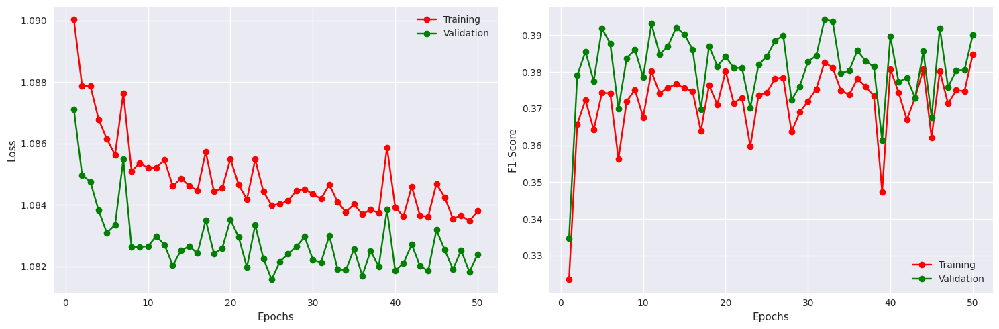


---------------------- Neural Network with 3 Hidden Layer of sizes 16 128 32 -----------------------

Time Taken:   		159.273
Average Loss: 		1.0814388071725127
F1-Score:     		0.38699692487716675
Accuracy:     		0.391819566488266
Recall:       		0.391819566488266
Precision:    		0.3904913067817688

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.44      0.41     12210		    NEGATIVE       0.39      0.45      0.42      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.38      0.27      0.32      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.40      0.45      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   mac

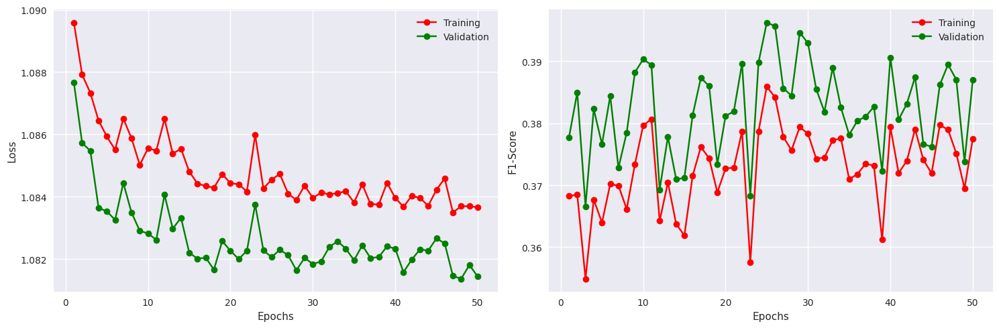


---------------------- Neural Network with 3 Hidden Layer of sizes 16 128 64 -----------------------

Time Taken:   		170.634
Average Loss: 		1.0836246534954153
F1-Score:     		0.36327147483825684
Accuracy:     		0.38665902614593506
Recall:       		0.38665902614593506
Precision:    		0.40254080295562744

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.63      0.46     12210		    NEGATIVE       0.38      0.65      0.48      1744
     NEUTRAL       0.37      0.31      0.34     12210		     NEUTRAL       0.38      0.32      0.34      1744
    POSITIVE       0.44      0.19      0.26     12210		    POSITIVE       0.46      0.19      0.27      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.35     36630		 

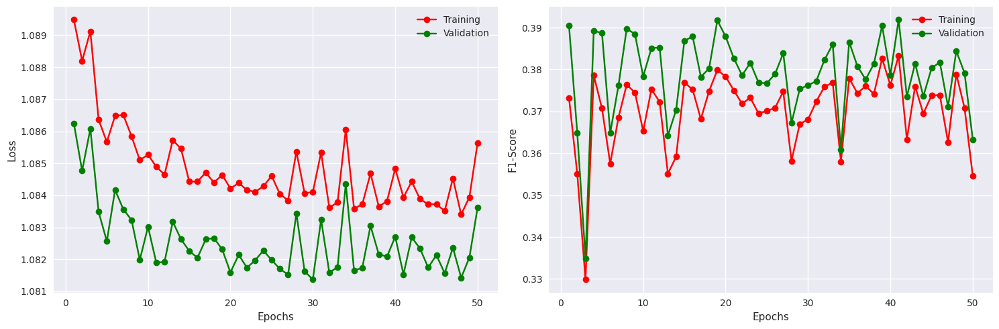


---------------------- Neural Network with 3 Hidden Layer of sizes 16 128 128 -----------------------

Time Taken:   		176.315
Average Loss: 		1.0820274834239154
F1-Score:     		0.3828544020652771
Accuracy:     		0.38799694180488586
Recall:       		0.38799694180488586
Precision:    		0.39288651943206787

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.38      0.51      0.44      1744
     NEUTRAL       0.37      0.36      0.37     12210		     NEUTRAL       0.37      0.37      0.37      1744
    POSITIVE       0.42      0.28      0.33     12210		    POSITIVE       0.43      0.29      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		 

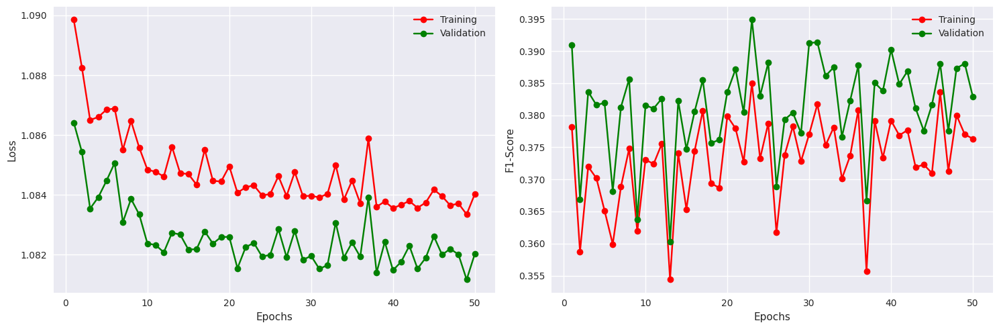


---------------------- Neural Network with 3 Hidden Layer of sizes 16 128 256 -----------------------

Time Taken:   		187.513
Average Loss: 		1.0814033589960967
F1-Score:     		0.3822736442089081
Accuracy:     		0.38837921619415283
Recall:       		0.38837921619415283
Precision:    		0.3886950612068176

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.38      0.52      0.44      1744
     NEUTRAL       0.38      0.28      0.33     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.41      0.36      0.38     12210		    POSITIVE       0.41      0.37      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		  

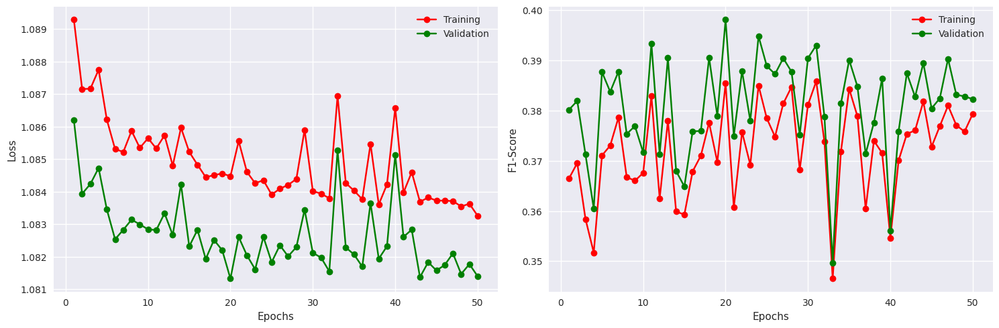


---------------------- Neural Network with 3 Hidden Layer of sizes 16 256 16 -----------------------

Time Taken:   		165.623
Average Loss: 		1.0824101350358502
F1-Score:     		0.3867201805114746
Accuracy:     		0.3876146674156189
Recall:       		0.3876146674156189
Precision:    		0.3896142244338989

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.41      0.40     12210		    NEGATIVE       0.39      0.42      0.41      1744
     NEUTRAL       0.37      0.42      0.40     12210		     NEUTRAL       0.37      0.41      0.39      1744
    POSITIVE       0.41      0.32      0.36     12210		    POSITIVE       0.41      0.33      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   ma

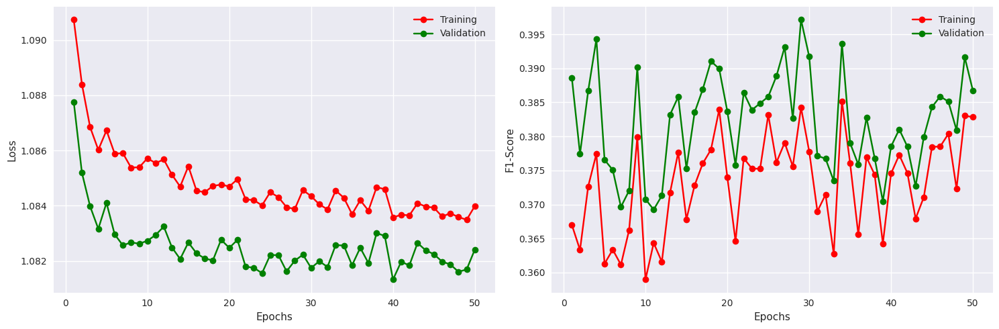


---------------------- Neural Network with 3 Hidden Layer of sizes 16 256 32 -----------------------

Time Taken:   		176.665
Average Loss: 		1.0818006855632187
F1-Score:     		0.3830050826072693
Accuracy:     		0.3916283845901489
Recall:       		0.3916283845901489
Precision:    		0.39414823055267334

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.55      0.44     12210		    NEGATIVE       0.38      0.56      0.45      1744
     NEUTRAL       0.38      0.27      0.31     12210		     NEUTRAL       0.39      0.27      0.32      1744
    POSITIVE       0.41      0.33      0.36     12210		    POSITIVE       0.42      0.35      0.38      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   m

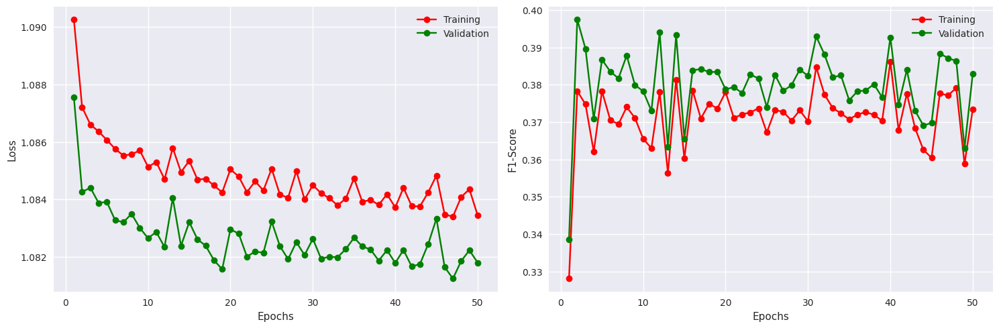


---------------------- Neural Network with 3 Hidden Layer of sizes 16 256 64 -----------------------

Time Taken:   		181.296
Average Loss: 		1.0816670185929045
F1-Score:     		0.3785380721092224
Accuracy:     		0.3931574821472168
Recall:       		0.3931574821472168
Precision:    		0.3959105312824249

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.56      0.45     12210		    NEGATIVE       0.38      0.56      0.46      1744
     NEUTRAL       0.40      0.20      0.27     12210		     NEUTRAL       0.40      0.21      0.27      1744
    POSITIVE       0.40      0.39      0.40     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   ma

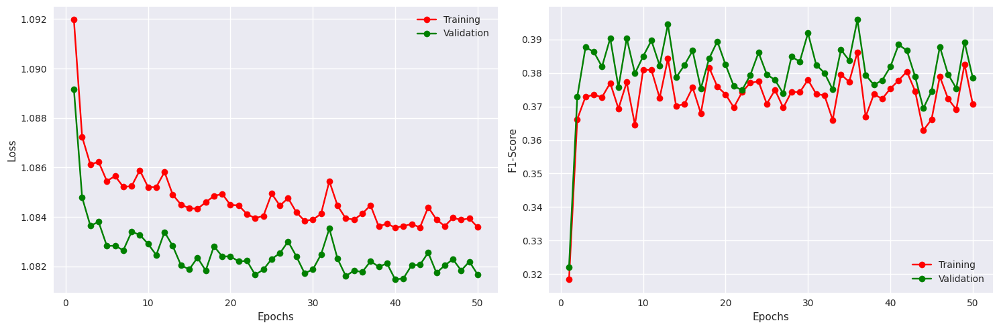


---------------------- Neural Network with 3 Hidden Layer of sizes 16 256 128 -----------------------

Time Taken:   		192.470
Average Loss: 		1.0815502248408233
F1-Score:     		0.38475263118743896
Accuracy:     		0.38971710205078125
Recall:       		0.38971710205078125
Precision:    		0.3885824978351593

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.39      0.49      0.43      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		 

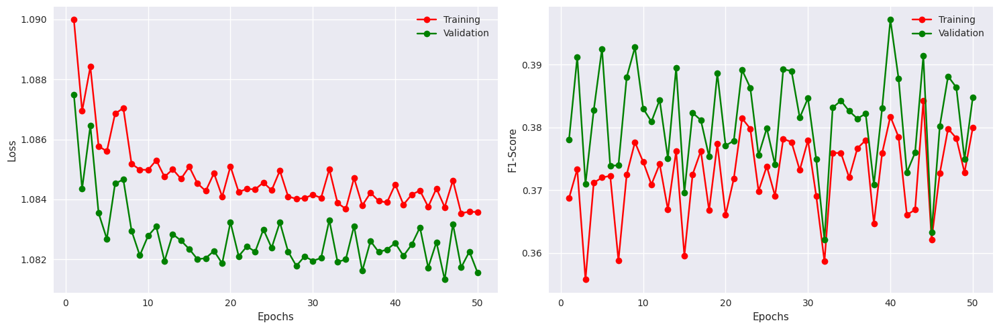


---------------------- Neural Network with 3 Hidden Layer of sizes 16 256 256 -----------------------

Time Taken:   		204.358
Average Loss: 		1.0815081118808245
F1-Score:     		0.3889307677745819
Accuracy:     		0.3912461996078491
Recall:       		0.3912461996078491
Precision:    		0.3915198743343353

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.47      0.42     12210		    NEGATIVE       0.39      0.48      0.43      1744
     NEUTRAL       0.37      0.32      0.35     12210		     NEUTRAL       0.37      0.32      0.35      1744
    POSITIVE       0.40      0.36      0.38     12210		    POSITIVE       0.41      0.38      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

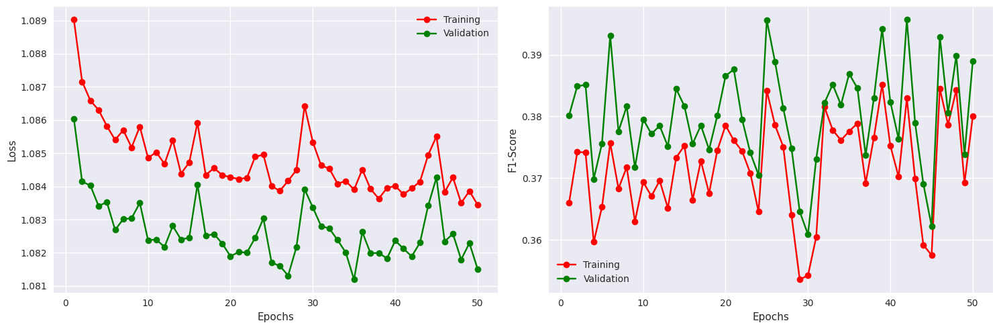


---------------------- Neural Network with 3 Hidden Layer of sizes 32 16 16 -----------------------

Time Taken:   		169.731
Average Loss: 		1.081774719264529
F1-Score:     		0.38053756952285767
Accuracy:     		0.3899082541465759
Recall:       		0.3899082541465759
Precision:    		0.3906797766685486

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.38      0.26      0.31     12210		     NEUTRAL       0.38      0.25      0.30      1744
    POSITIVE       0.41      0.35      0.38     12210		    POSITIVE       0.41      0.36      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   mac

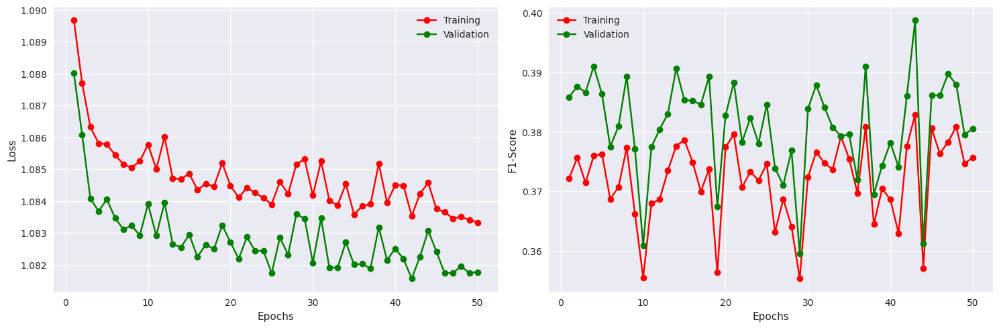


---------------------- Neural Network with 3 Hidden Layer of sizes 32 16 32 -----------------------

Time Taken:   		167.135
Average Loss: 		1.0822086968553175
F1-Score:     		0.39115631580352783
Accuracy:     		0.3927752375602722
Recall:       		0.3927752375602722
Precision:    		0.39182186126708984

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.38      0.38     12210		    NEGATIVE       0.40      0.40      0.40      1744
     NEUTRAL       0.38      0.33      0.35     12210		     NEUTRAL       0.38      0.33      0.35      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.40      0.45      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

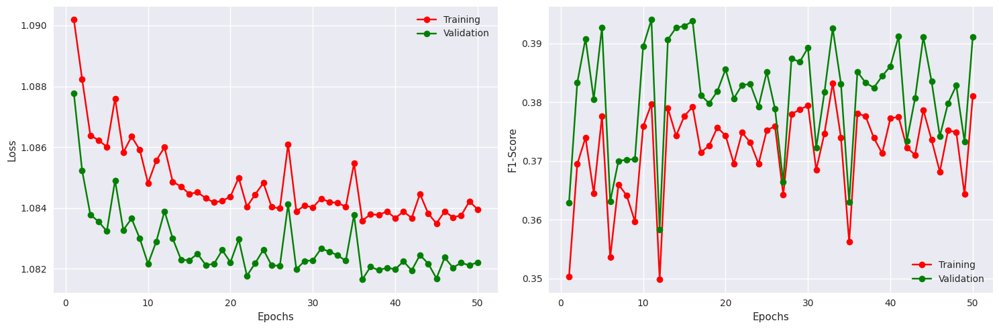


---------------------- Neural Network with 3 Hidden Layer of sizes 32 16 64 -----------------------

Time Taken:   		167.884
Average Loss: 		1.0820021540017668
F1-Score:     		0.3783414959907532
Accuracy:     		0.39105504751205444
Recall:       		0.39105504751205444
Precision:    		0.39764806628227234

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.59      0.45     12210		    NEGATIVE       0.38      0.60      0.47      1744
     NEUTRAL       0.38      0.29      0.33     12210		     NEUTRAL       0.38      0.30      0.33      1744
    POSITIVE       0.42      0.27      0.33     12210		    POSITIVE       0.43      0.27      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

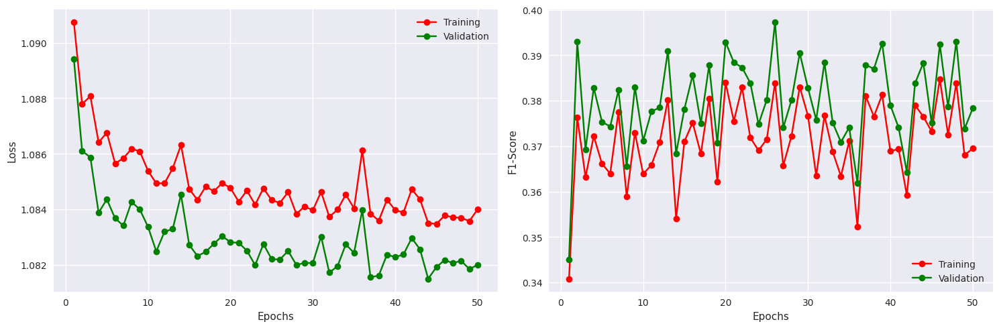


---------------------- Neural Network with 3 Hidden Layer of sizes 32 16 128 -----------------------

Time Taken:   		173.051
Average Loss: 		1.0819640766590013
F1-Score:     		0.38087916374206543
Accuracy:     		0.3876146972179413
Recall:       		0.3876146972179413
Precision:    		0.38871943950653076

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.38      0.30      0.34     12210		     NEUTRAL       0.37      0.30      0.33      1744
    POSITIVE       0.41      0.31      0.35     12210		    POSITIVE       0.41      0.32      0.36      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   

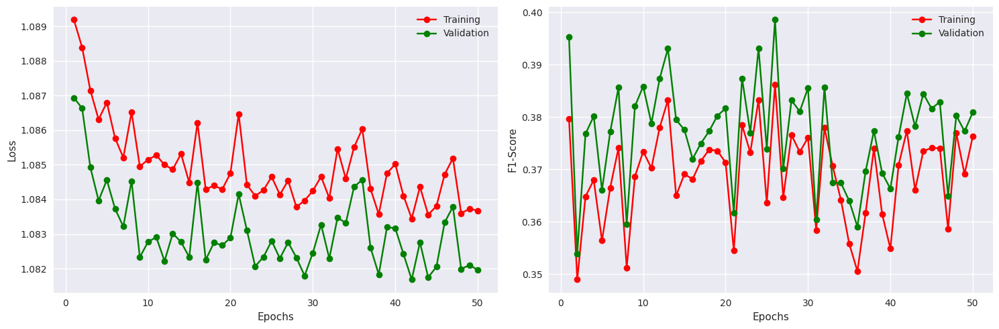


---------------------- Neural Network with 3 Hidden Layer of sizes 32 16 256 -----------------------

Time Taken:   		173.865
Average Loss: 		1.0852056003491812
F1-Score:     		0.35515159368515015
Accuracy:     		0.37844038009643555
Recall:       		0.37844038009643555
Precision:    		0.40017348527908325

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.60      0.46     12210		    NEGATIVE       0.37      0.60      0.46      1744
     NEUTRAL       0.37      0.37      0.37     12210		     NEUTRAL       0.36      0.37      0.36      1744
    POSITIVE       0.46      0.17      0.24     12210		    POSITIVE       0.47      0.16      0.24      1744
		
    accuracy                           0.38     36630		    accuracy                           0.38      5232
   macro avg       0.40      0.38      0.36     36630		 

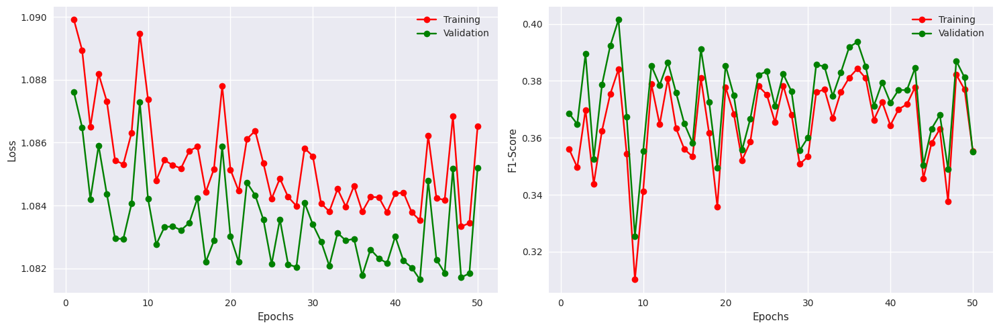


---------------------- Neural Network with 3 Hidden Layer of sizes 32 32 16 -----------------------

Time Taken:   		166.987
Average Loss: 		1.0821455753542233
F1-Score:     		0.39261043071746826
Accuracy:     		0.39258408546447754
Recall:       		0.39258408546447754
Precision:    		0.39322900772094727

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.38      0.38     12210		    NEGATIVE       0.40      0.38      0.39      1744
     NEUTRAL       0.37      0.40      0.39     12210		     NEUTRAL       0.38      0.41      0.39      1744
    POSITIVE       0.40      0.37      0.38     12210		    POSITIVE       0.41      0.39      0.40      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.39     36630		  

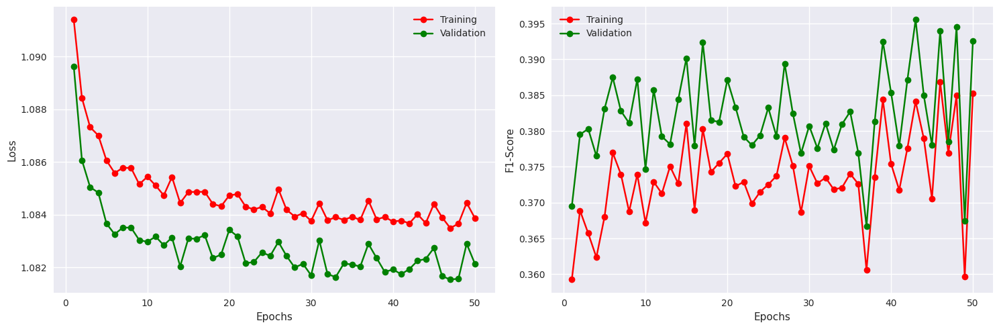


---------------------- Neural Network with 3 Hidden Layer of sizes 32 32 32 -----------------------

Time Taken:   		168.448
Average Loss: 		1.0824254696522284
F1-Score:     		0.3829652965068817
Accuracy:     		0.3904816508293152
Recall:       		0.3904816508293152
Precision:    		0.3906839191913605

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.46      0.41     12210		    NEGATIVE       0.39      0.47      0.42      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.39      0.25      0.30      1744
    POSITIVE       0.39      0.44      0.41     12210		    POSITIVE       0.39      0.46      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   mac

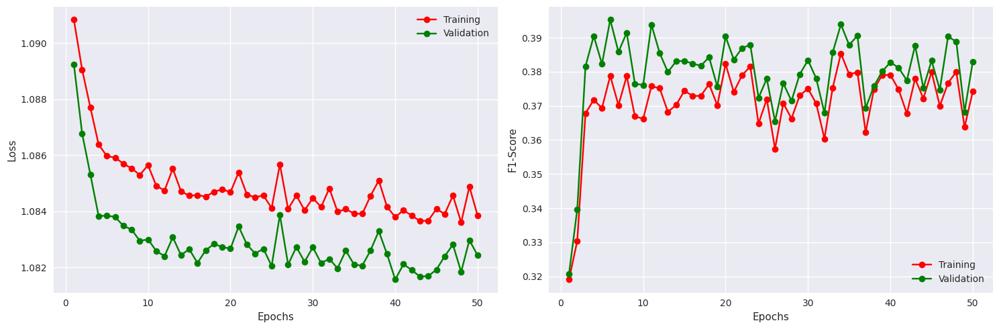


---------------------- Neural Network with 3 Hidden Layer of sizes 32 32 64 -----------------------

Time Taken:   		167.964
Average Loss: 		1.0822469533765717
F1-Score:     		0.3743312656879425
Accuracy:     		0.3900994062423706
Recall:       		0.3900994062423706
Precision:    		0.3974815607070923

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.62      0.46     12210		    NEGATIVE       0.38      0.63      0.47      1744
     NEUTRAL       0.38      0.27      0.31     12210		     NEUTRAL       0.39      0.27      0.32      1744
    POSITIVE       0.42      0.27      0.33     12210		    POSITIVE       0.43      0.27      0.33      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   mac

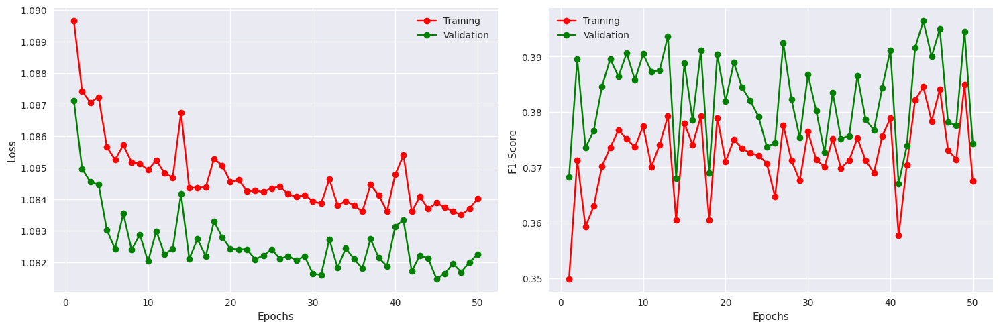


---------------------- Neural Network with 3 Hidden Layer of sizes 32 32 128 -----------------------

Time Taken:   		168.553
Average Loss: 		1.0825242970697013
F1-Score:     		0.3719806671142578
Accuracy:     		0.38379204273223877
Recall:       		0.38379204273223877
Precision:    		0.3829619288444519

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.38      0.50      0.43      1744
     NEUTRAL       0.39      0.21      0.28     12210		     NEUTRAL       0.38      0.21      0.27      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.39      0.44      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.38      5232
   macro avg       0.38      0.38      0.37     36630		   

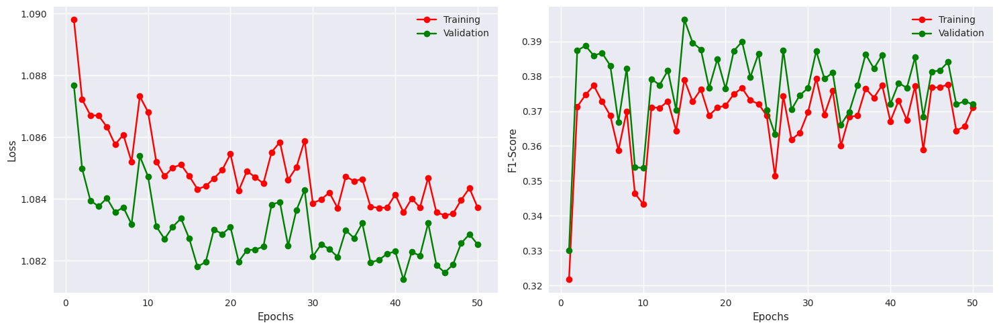


---------------------- Neural Network with 3 Hidden Layer of sizes 32 32 256 -----------------------

Time Taken:   		180.080
Average Loss: 		1.083506666192221
F1-Score:     		0.36741089820861816
Accuracy:     		0.37729358673095703
Recall:       		0.37729358673095703
Precision:    		0.3887068033218384

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.34      0.36     12210		    NEGATIVE       0.39      0.34      0.36      1744
     NEUTRAL       0.36      0.56      0.44     12210		     NEUTRAL       0.35      0.55      0.43      1744
    POSITIVE       0.42      0.24      0.30     12210		    POSITIVE       0.42      0.24      0.31      1744
		
    accuracy                           0.38     36630		    accuracy                           0.38      5232
   macro avg       0.39      0.38      0.37     36630		   

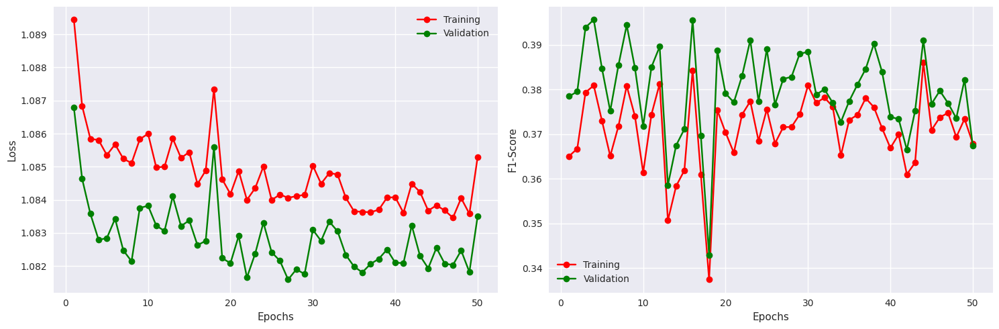


---------------------- Neural Network with 3 Hidden Layer of sizes 32 64 16 -----------------------

Time Taken:   		164.759
Average Loss: 		1.0822122020458957
F1-Score:     		0.37630707025527954
Accuracy:     		0.3900994062423706
Recall:       		0.3900994062423706
Precision:    		0.39141297340393066

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.57      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.39      0.22      0.28     12210		     NEUTRAL       0.39      0.22      0.28      1744
    POSITIVE       0.41      0.37      0.39     12210		    POSITIVE       0.40      0.37      0.39      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   m

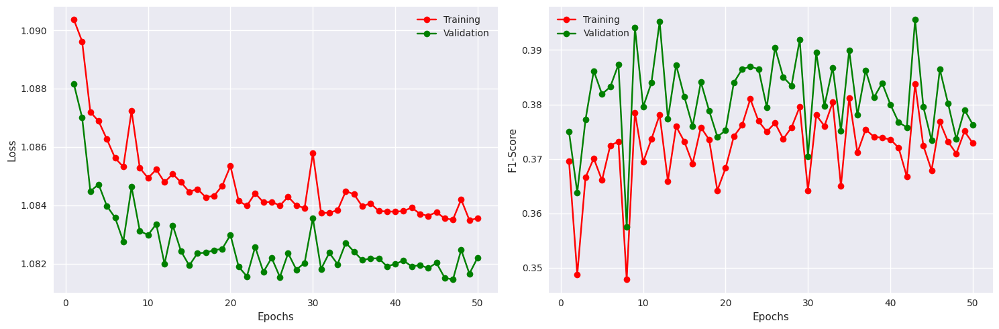


---------------------- Neural Network with 3 Hidden Layer of sizes 32 64 32 -----------------------

Time Taken:   		166.580
Average Loss: 		1.0833640078521285
F1-Score:     		0.38813066482543945
Accuracy:     		0.3933486044406891
Recall:       		0.3933486044406891
Precision:    		0.3951278328895569

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.30      0.34     12210		    NEGATIVE       0.41      0.32      0.36      1744
     NEUTRAL       0.38      0.34      0.36     12210		     NEUTRAL       0.38      0.34      0.36      1744
    POSITIVE       0.38      0.51      0.43     12210		    POSITIVE       0.39      0.53      0.45      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   ma

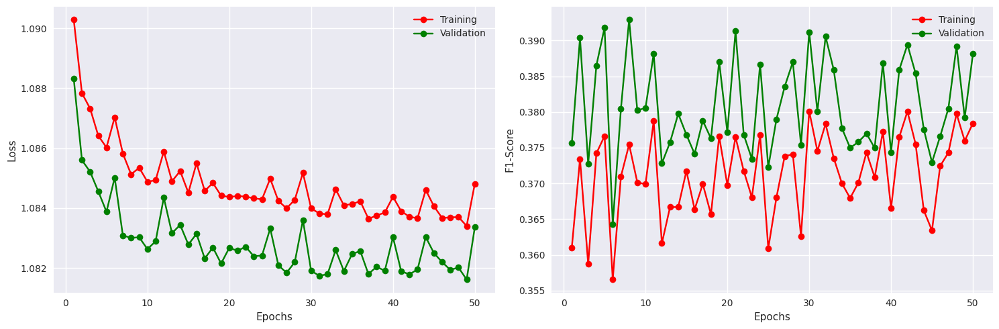


---------------------- Neural Network with 3 Hidden Layer of sizes 32 64 64 -----------------------

Time Taken:   		167.899
Average Loss: 		1.081653153677599
F1-Score:     		0.38517725467681885
Accuracy:     		0.3889526128768921
Recall:       		0.3889526128768921
Precision:    		0.3894198536872864

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.49      0.42     12210		    NEGATIVE       0.38      0.50      0.43      1744
     NEUTRAL       0.38      0.31      0.34     12210		     NEUTRAL       0.38      0.31      0.34      1744
    POSITIVE       0.41      0.35      0.38     12210		    POSITIVE       0.41      0.37      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   mac

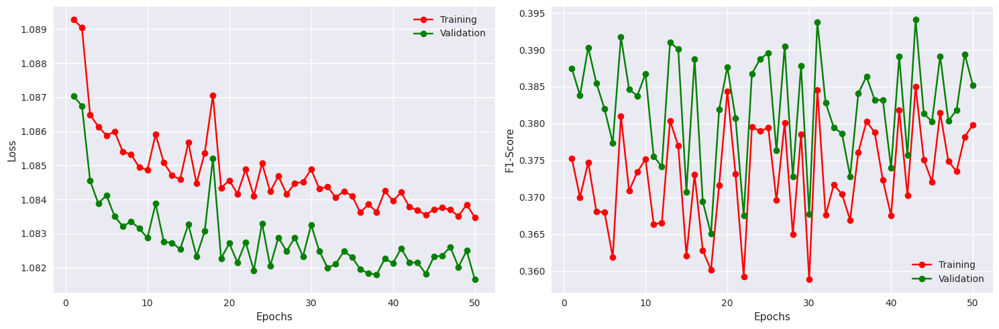


---------------------- Neural Network with 3 Hidden Layer of sizes 32 64 128 -----------------------

Time Taken:   		176.339
Average Loss: 		1.08127455773339
F1-Score:     		0.3839338719844818
Accuracy:     		0.391437292098999
Recall:       		0.391437292098999
Precision:    		0.39201152324676514

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.38      0.51      0.44      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.39      0.25      0.31      1744
    POSITIVE       0.40      0.39      0.40     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   macro

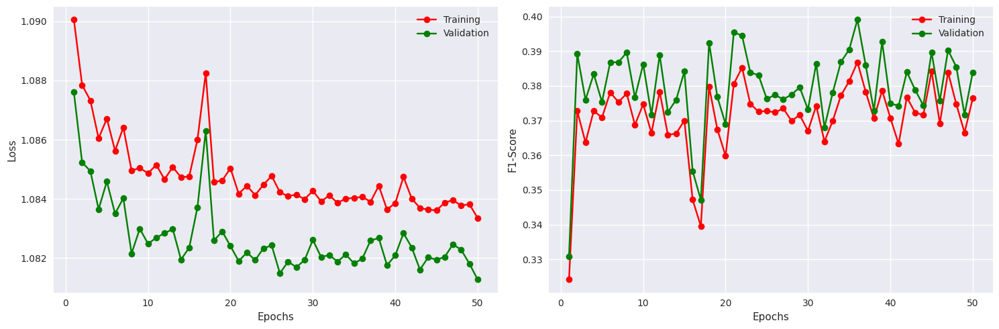


---------------------- Neural Network with 3 Hidden Layer of sizes 32 64 256 -----------------------

Time Taken:   		182.388
Average Loss: 		1.0825133261695186
F1-Score:     		0.3800041675567627
Accuracy:     		0.394113153219223
Recall:       		0.394113153219223
Precision:    		0.3991677165031433

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.60      0.46     12210		    NEGATIVE       0.38      0.61      0.47      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.39      0.26      0.31      1744
    POSITIVE       0.41      0.30      0.35     12210		    POSITIVE       0.42      0.31      0.36      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   macr

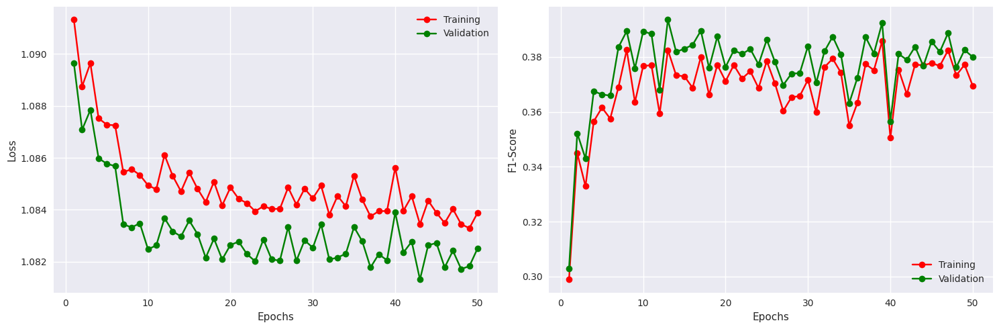


---------------------- Neural Network with 3 Hidden Layer of sizes 32 128 16 -----------------------

Time Taken:   		167.933
Average Loss: 		1.0814948818370107
F1-Score:     		0.39702939987182617
Accuracy:     		0.3973623812198639
Recall:       		0.3973623812198639
Precision:    		0.39709582924842834

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.41      0.39     12210		    NEGATIVE       0.40      0.42      0.41      1744
     NEUTRAL       0.38      0.36      0.37     12210		     NEUTRAL       0.38      0.36      0.37      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.41      0.41      0.41      1744
		
    accuracy                           0.39     36630		    accuracy                           0.40      5232
   macro avg       0.39      0.39      0.39     36630		   

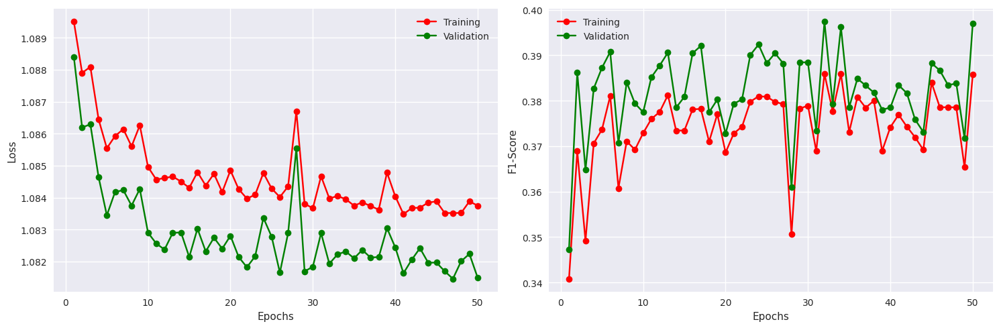


---------------------- Neural Network with 3 Hidden Layer of sizes 32 128 32 -----------------------

Time Taken:   		168.696
Average Loss: 		1.0837218014107568
F1-Score:     		0.364071786403656
Accuracy:     		0.3878058195114136
Recall:       		0.3878058195114136
Precision:    		0.397466242313385

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.66      0.47     12210		    NEGATIVE       0.38      0.68      0.48      1744
     NEUTRAL       0.38      0.25      0.30     12210		     NEUTRAL       0.38      0.25      0.30      1744
    POSITIVE       0.43      0.24      0.31     12210		    POSITIVE       0.43      0.24      0.31      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.36     36630		   macr

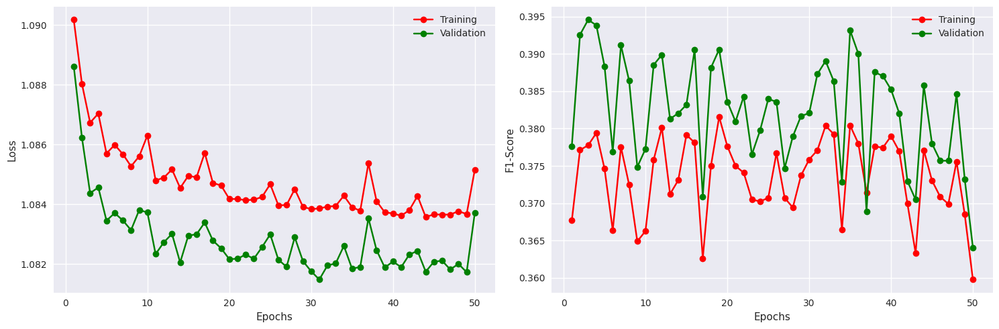


---------------------- Neural Network with 3 Hidden Layer of sizes 32 128 64 -----------------------

Time Taken:   		175.212
Average Loss: 		1.0819373531808183
F1-Score:     		0.39368292689323425
Accuracy:     		0.394113153219223
Recall:       		0.394113153219223
Precision:    		0.3937210738658905

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.41      0.39     12210		    NEGATIVE       0.39      0.41      0.40      1744
     NEUTRAL       0.38      0.36      0.37     12210		     NEUTRAL       0.38      0.36      0.37      1744
    POSITIVE       0.39      0.39      0.39     12210		    POSITIVE       0.41      0.42      0.41      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.39     36630		   mac

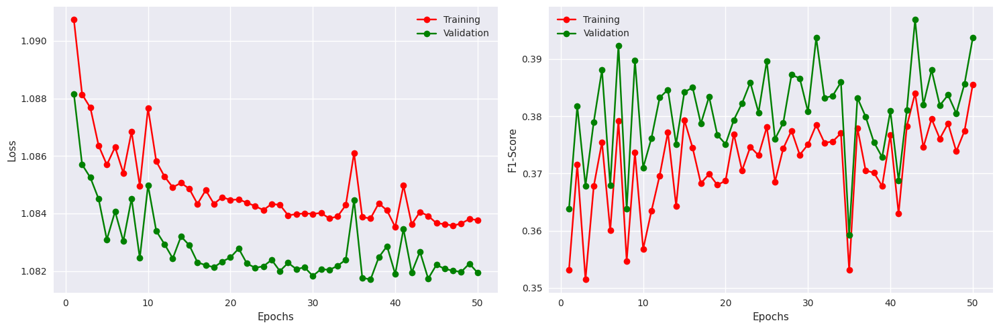


---------------------- Neural Network with 3 Hidden Layer of sizes 32 128 128 -----------------------

Time Taken:   		183.527
Average Loss: 		1.083059909875969
F1-Score:     		0.37025731801986694
Accuracy:     		0.39545106887817383
Recall:       		0.39545106887817383
Precision:    		0.40857672691345215

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.68      0.48     12210		    NEGATIVE       0.38      0.69      0.49      1744
     NEUTRAL       0.40      0.20      0.27     12210		     NEUTRAL       0.41      0.22      0.28      1744
    POSITIVE       0.43      0.27      0.33     12210		    POSITIVE       0.44      0.28      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.40      5232
   macro avg       0.40      0.38      0.36     36630		 

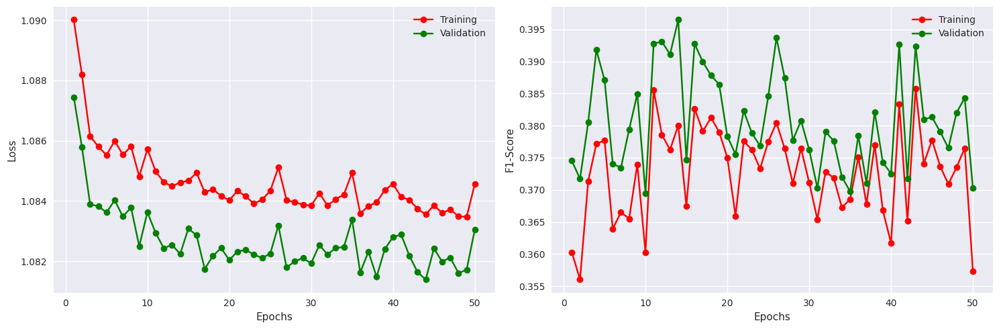


---------------------- Neural Network with 3 Hidden Layer of sizes 32 128 256 -----------------------

Time Taken:   		195.088
Average Loss: 		1.0821962639097045
F1-Score:     		0.3831706643104553
Accuracy:     		0.3900993764400482
Recall:       		0.3900993764400482
Precision:    		0.39498403668403625

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.53      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.37      0.33      0.35     12210		     NEUTRAL       0.37      0.34      0.35      1744
    POSITIVE       0.42      0.28      0.33     12210		    POSITIVE       0.43      0.29      0.35      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

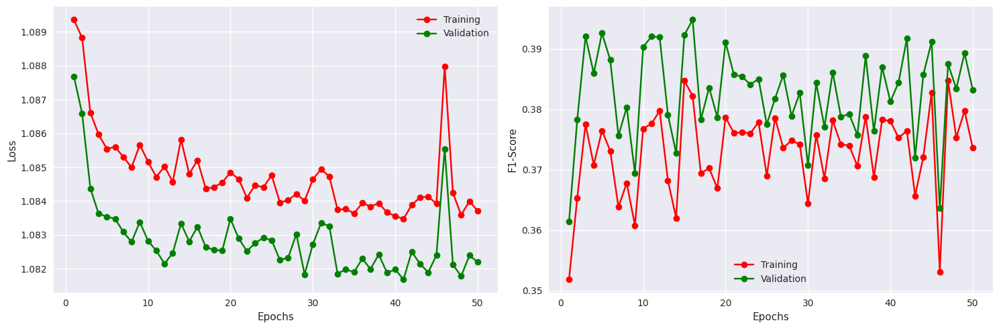


---------------------- Neural Network with 3 Hidden Layer of sizes 32 256 16 -----------------------

Time Taken:   		180.553
Average Loss: 		1.0829059064205997
F1-Score:     		0.3754384517669678
Accuracy:     		0.39258408546447754
Recall:       		0.39258408546447754
Precision:    		0.3972921371459961

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.46      0.41     12210		    NEGATIVE       0.39      0.47      0.43      1744
     NEUTRAL       0.40      0.17      0.24     12210		     NEUTRAL       0.41      0.18      0.25      1744
    POSITIVE       0.38      0.51      0.44     12210		    POSITIVE       0.39      0.53      0.45      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

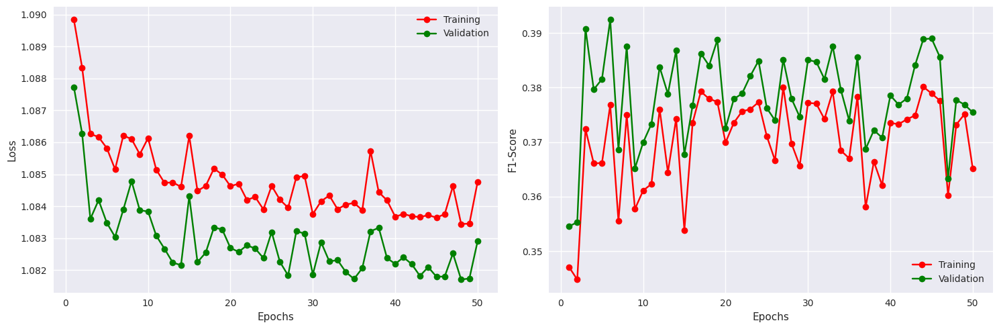


---------------------- Neural Network with 3 Hidden Layer of sizes 32 256 32 -----------------------

Time Taken:   		185.187
Average Loss: 		1.0821877076356055
F1-Score:     		0.378223180770874
Accuracy:     		0.38952597975730896
Recall:       		0.38952597975730896
Precision:    		0.38869187235832214

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.39      0.51      0.44      1744
     NEUTRAL       0.39      0.22      0.28     12210		     NEUTRAL       0.38      0.22      0.28      1744
    POSITIVE       0.39      0.42      0.40     12210		    POSITIVE       0.40      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   

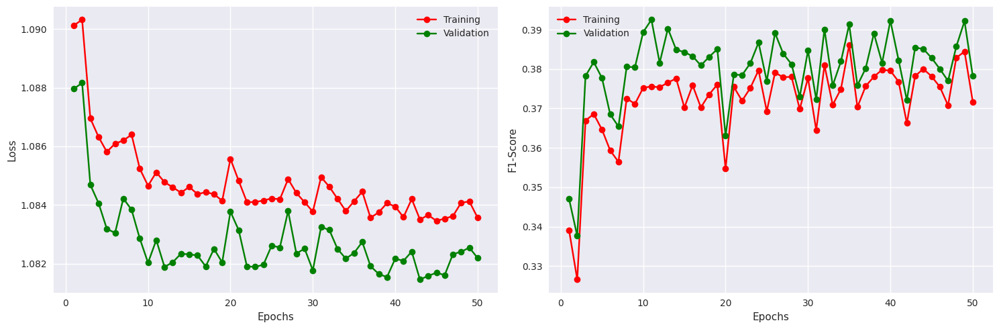


---------------------- Neural Network with 3 Hidden Layer of sizes 32 256 64 -----------------------

Time Taken:   		191.621
Average Loss: 		1.0816383633409437
F1-Score:     		0.3826363682746887
Accuracy:     		0.38952600955963135
Recall:       		0.38952600955963135
Precision:    		0.38917654752731323

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.39      0.51      0.44      1744
     NEUTRAL       0.39      0.26      0.31     12210		     NEUTRAL       0.38      0.26      0.31      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.40      0.39      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		  

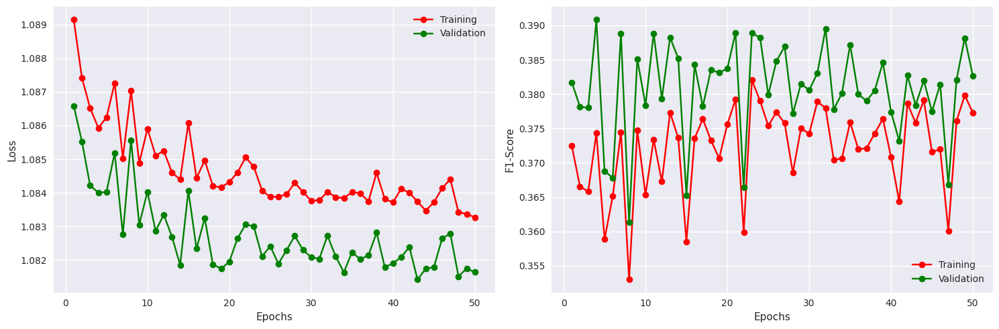


---------------------- Neural Network with 3 Hidden Layer of sizes 32 256 128 -----------------------

Time Taken:   		200.133
Average Loss: 		1.0825340849908485
F1-Score:     		0.39219072461128235
Accuracy:     		0.39449542760849
Recall:       		0.39449542760849
Precision:    		0.39459049701690674

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.36      0.37     12210		    NEGATIVE       0.41      0.37      0.39      1744
     NEUTRAL       0.38      0.34      0.36     12210		     NEUTRAL       0.38      0.33      0.36      1744
    POSITIVE       0.39      0.46      0.42     12210		    POSITIVE       0.39      0.48      0.43      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.38     36630		   mac

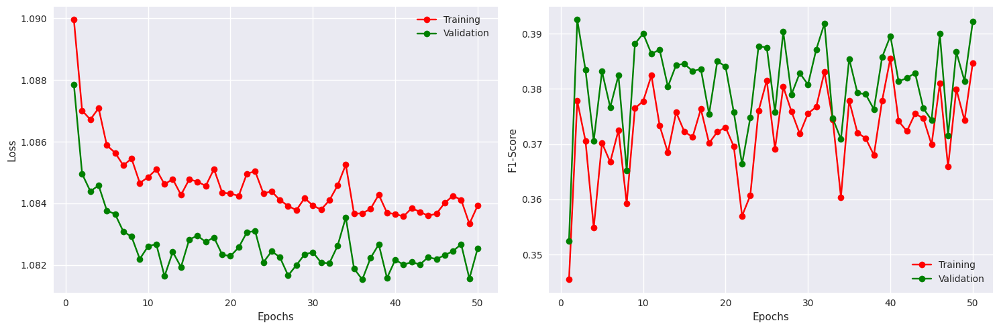


---------------------- Neural Network with 3 Hidden Layer of sizes 32 256 256 -----------------------

Time Taken:   		212.048
Average Loss: 		1.0821369345035028
F1-Score:     		0.3831630349159241
Accuracy:     		0.3904816508293152
Recall:       		0.3904816508293152
Precision:    		0.3908533453941345

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.38      0.51      0.44      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.39      0.25      0.31      1744
    POSITIVE       0.40      0.40      0.40     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

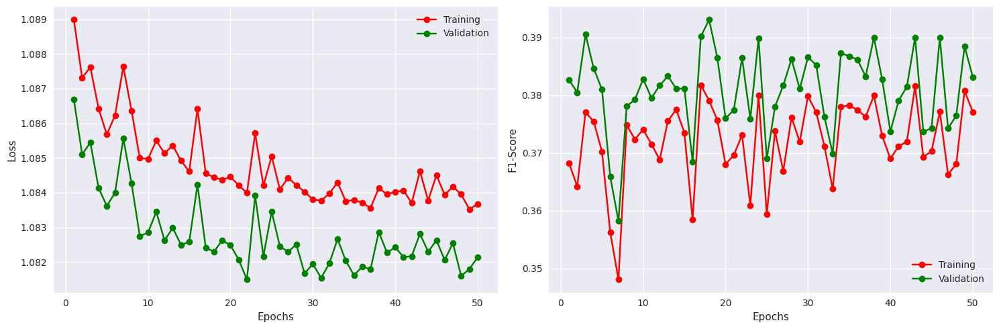


---------------------- Neural Network with 3 Hidden Layer of sizes 64 16 16 -----------------------

Time Taken:   		173.650
Average Loss: 		1.0815883907703085
F1-Score:     		0.38850313425064087
Accuracy:     		0.39373087882995605
Recall:       		0.39373087882995605
Precision:    		0.39270463585853577

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.45      0.41     12210		    NEGATIVE       0.39      0.47      0.43      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.39      0.27      0.32      1744
    POSITIVE       0.39      0.42      0.41     12210		    POSITIVE       0.40      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		  

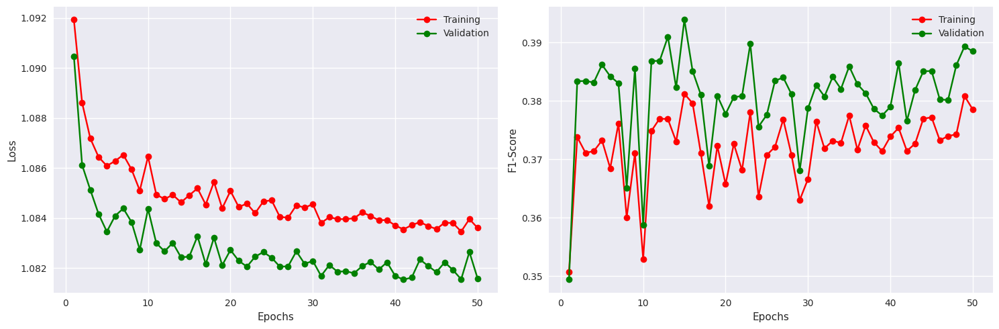


---------------------- Neural Network with 3 Hidden Layer of sizes 64 16 32 -----------------------

Time Taken:   		172.183
Average Loss: 		1.0819110904993996
F1-Score:     		0.3745765686035156
Accuracy:     		0.3927752375602722
Recall:       		0.3927752375602722
Precision:    		0.3978871703147888

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.56      0.45     12210		    NEGATIVE       0.38      0.56      0.45      1744
     NEUTRAL       0.41      0.17      0.24     12210		     NEUTRAL       0.41      0.18      0.25      1744
    POSITIVE       0.39      0.42      0.41     12210		    POSITIVE       0.40      0.44      0.42      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   mac

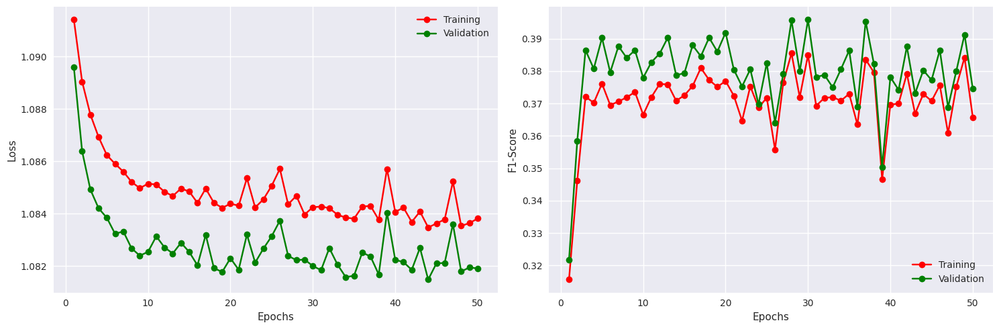


---------------------- Neural Network with 3 Hidden Layer of sizes 64 16 64 -----------------------

Time Taken:   		171.877
Average Loss: 		1.0816437421588723
F1-Score:     		0.3776676058769226
Accuracy:     		0.3874235451221466
Recall:       		0.3874235451221466
Precision:    		0.38685616850852966

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.52      0.43     12210		    NEGATIVE       0.38      0.53      0.44      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.38      0.23      0.29      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   ma

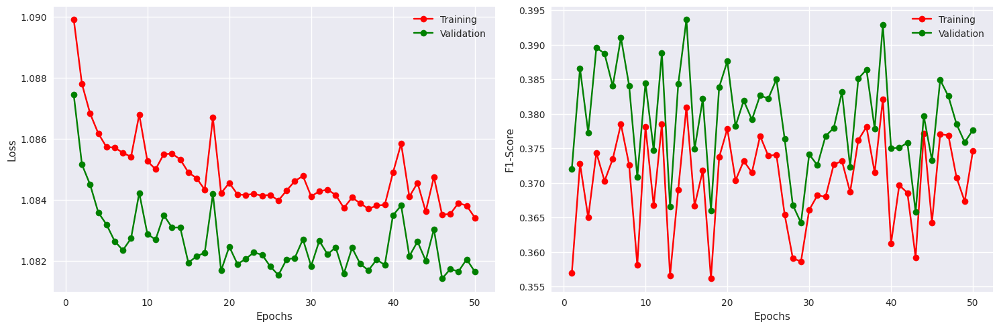


---------------------- Neural Network with 3 Hidden Layer of sizes 64 16 128 -----------------------

Time Taken:   		175.558
Average Loss: 		1.082268892260502
F1-Score:     		0.3853067457675934
Accuracy:     		0.3902905285358429
Recall:       		0.3902905285358429
Precision:    		0.39311671257019043

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.49      0.43     12210		    NEGATIVE       0.39      0.50      0.44      1744
     NEUTRAL       0.37      0.38      0.38     12210		     NEUTRAL       0.38      0.39      0.38      1744
    POSITIVE       0.42      0.28      0.33     12210		    POSITIVE       0.41      0.28      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   ma

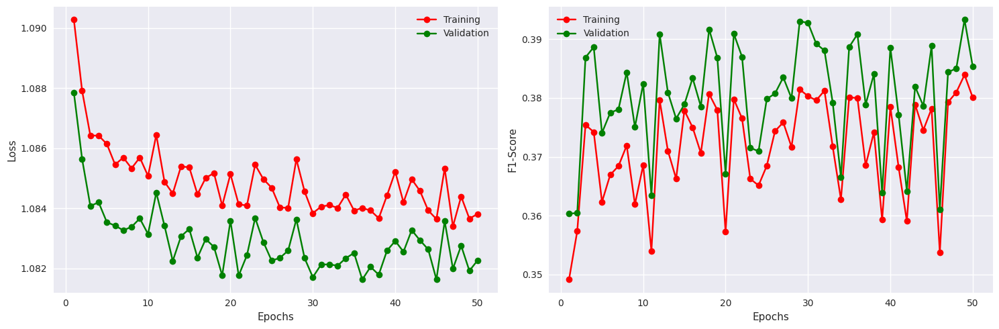


---------------------- Neural Network with 3 Hidden Layer of sizes 64 16 256 -----------------------

Time Taken:   		177.223
Average Loss: 		1.0820067036407075
F1-Score:     		0.3823195993900299
Accuracy:     		0.3900993764400482
Recall:       		0.3900993764400482
Precision:    		0.3883206248283386

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.45      0.41     12210		    NEGATIVE       0.40      0.46      0.43      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.38      0.24      0.30      1744
    POSITIVE       0.39      0.45      0.41     12210		    POSITIVE       0.39      0.46      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   ma

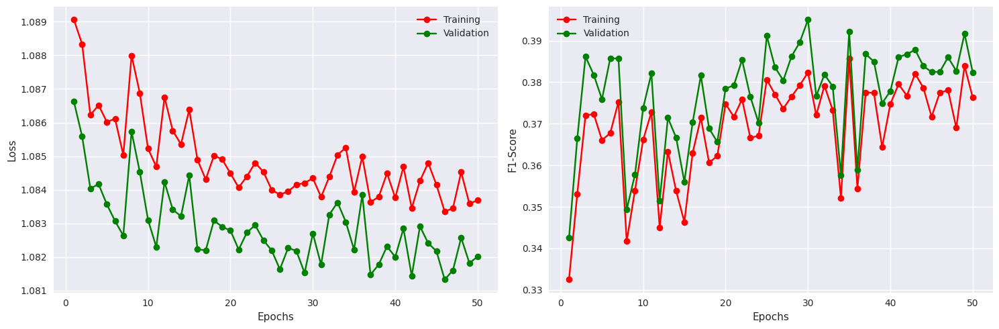


---------------------- Neural Network with 3 Hidden Layer of sizes 64 32 16 -----------------------

Time Taken:   		173.384
Average Loss: 		1.0825477187786627
F1-Score:     		0.386435329914093
Accuracy:     		0.3887614607810974
Recall:       		0.3887614607810974
Precision:    		0.39257535338401794

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.39      0.39     12210		    NEGATIVE       0.39      0.40      0.40      1744
     NEUTRAL       0.37      0.46      0.41     12210		     NEUTRAL       0.37      0.46      0.41      1744
    POSITIVE       0.41      0.30      0.34     12210		    POSITIVE       0.42      0.31      0.35      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   mac

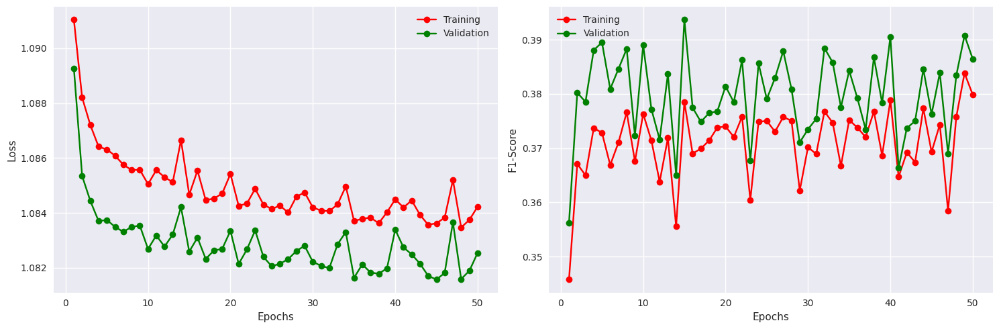


---------------------- Neural Network with 3 Hidden Layer of sizes 64 32 32 -----------------------

Time Taken:   		174.219
Average Loss: 		1.081702305818552
F1-Score:     		0.38626977801322937
Accuracy:     		0.39220184087753296
Recall:       		0.39220184087753296
Precision:    		0.391017884016037

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.42      0.40     12210		    NEGATIVE       0.40      0.43      0.41      1744
     NEUTRAL       0.38      0.27      0.31     12210		     NEUTRAL       0.38      0.26      0.31      1744
    POSITIVE       0.39      0.46      0.42     12210		    POSITIVE       0.39      0.48      0.43      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   ma

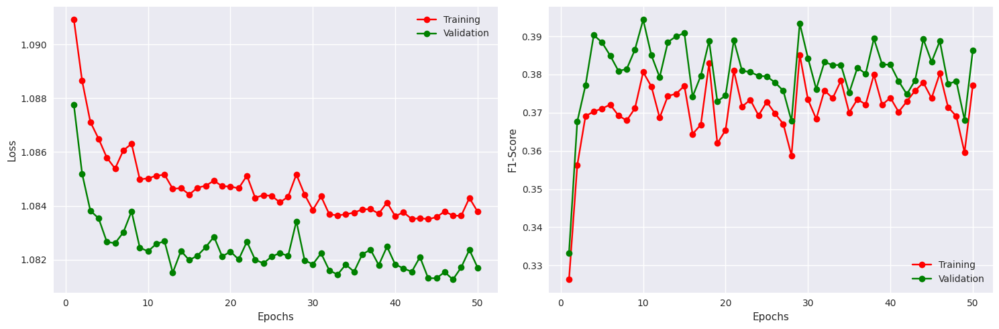


---------------------- Neural Network with 3 Hidden Layer of sizes 64 32 64 -----------------------

Time Taken:   		178.078
Average Loss: 		1.082584125004048
F1-Score:     		0.37196633219718933
Accuracy:     		0.39239296317100525
Recall:       		0.39239296317100525
Precision:    		0.39961397647857666

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.63      0.47     12210		    NEGATIVE       0.38      0.63      0.47      1744
     NEUTRAL       0.40      0.19      0.26     12210		     NEUTRAL       0.41      0.20      0.26      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.41      0.35      0.38      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.40      0.39      0.37     36630		   

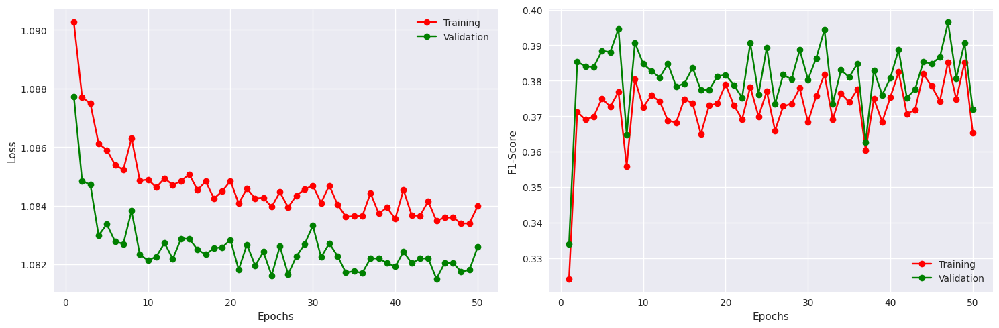


---------------------- Neural Network with 3 Hidden Layer of sizes 64 32 128 -----------------------

Time Taken:   		179.315
Average Loss: 		1.0818828594064858
F1-Score:     		0.39393752813339233
Accuracy:     		0.39793580770492554
Recall:       		0.39793580770492554
Precision:    		0.39847397804260254

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.40      0.39     12210		    NEGATIVE       0.40      0.41      0.41      1744
     NEUTRAL       0.39      0.30      0.34     12210		     NEUTRAL       0.40      0.30      0.34      1744
    POSITIVE       0.39      0.47      0.42     12210		    POSITIVE       0.39      0.49      0.43      1744
		
    accuracy                           0.39     36630		    accuracy                           0.40      5232
   macro avg       0.39      0.39      0.38     36630		 

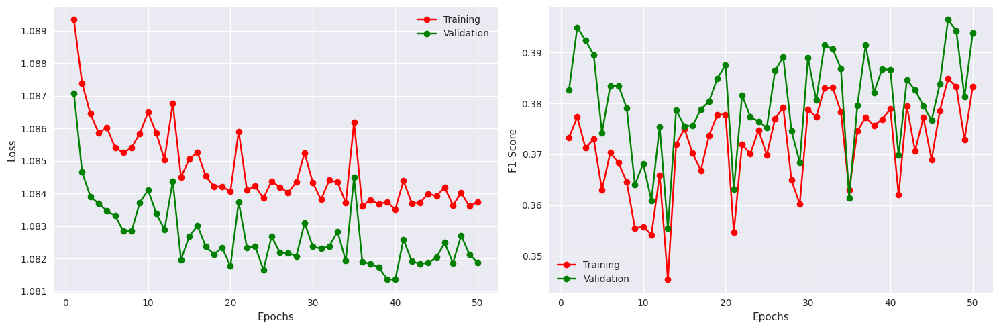


---------------------- Neural Network with 3 Hidden Layer of sizes 64 32 256 -----------------------

Time Taken:   		193.013
Average Loss: 		1.083382691994355
F1-Score:     		0.36865705251693726
Accuracy:     		0.38704127073287964
Recall:       		0.38704127073287964
Precision:    		0.392292857170105

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.36      0.37     12210		    NEGATIVE       0.40      0.36      0.38      1744
     NEUTRAL       0.39      0.20      0.26     12210		     NEUTRAL       0.40      0.20      0.26      1744
    POSITIVE       0.37      0.58      0.45     12210		    POSITIVE       0.37      0.60      0.46      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.36     36630		   m

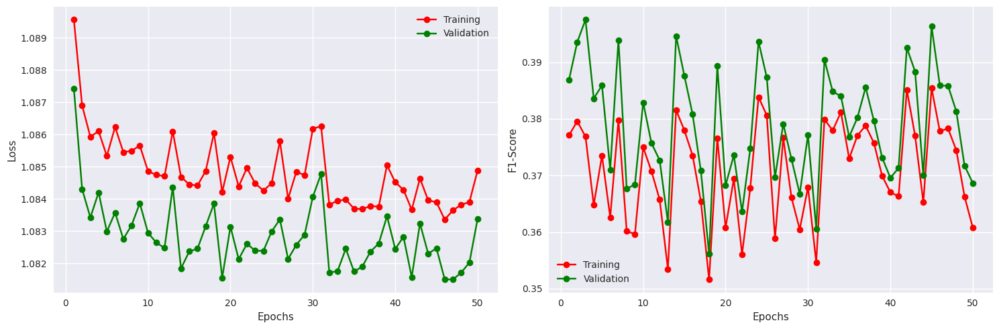


---------------------- Neural Network with 3 Hidden Layer of sizes 64 64 16 -----------------------

Time Taken:   		175.389
Average Loss: 		1.0829496921384736
F1-Score:     		0.3766615688800812
Accuracy:     		0.38704127073287964
Recall:       		0.38704127073287964
Precision:    		0.386738121509552

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.39      0.38     12210		    NEGATIVE       0.40      0.40      0.40      1744
     NEUTRAL       0.38      0.23      0.29     12210		     NEUTRAL       0.38      0.23      0.29      1744
    POSITIVE       0.38      0.51      0.44     12210		    POSITIVE       0.38      0.53      0.45      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   ma

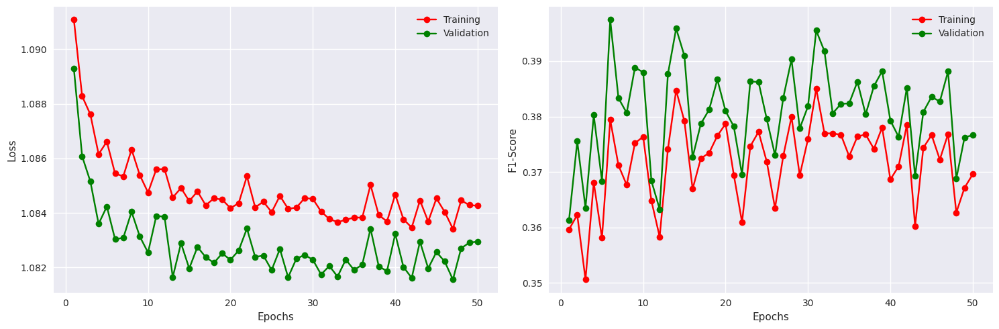


---------------------- Neural Network with 3 Hidden Layer of sizes 64 64 32 -----------------------

Time Taken:   		177.262
Average Loss: 		1.0817231951503579
F1-Score:     		0.3922949433326721
Accuracy:     		0.39373087882995605
Recall:       		0.39373087882995605
Precision:    		0.3951616585254669

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.46      0.42     12210		    NEGATIVE       0.39      0.47      0.42      1744
     NEUTRAL       0.38      0.36      0.37     12210		     NEUTRAL       0.38      0.36      0.37      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.42      0.36      0.39      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.39     36630		   m

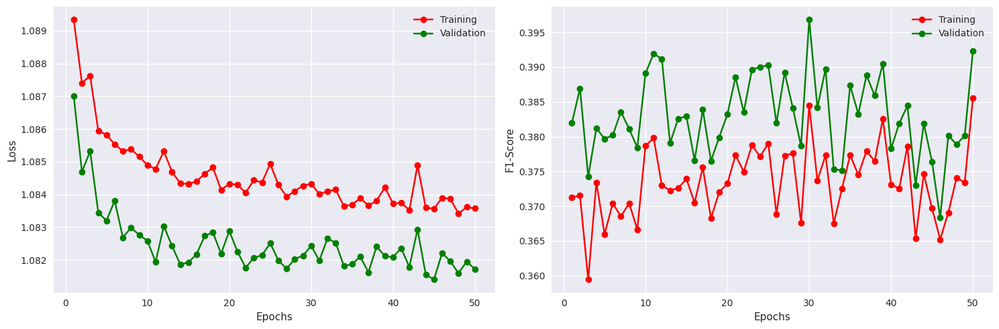


---------------------- Neural Network with 3 Hidden Layer of sizes 64 64 64 -----------------------

Time Taken:   		180.028
Average Loss: 		1.082814810655168
F1-Score:     		0.3685150444507599
Accuracy:     		0.38971713185310364
Recall:       		0.38971713185310364
Precision:    		0.40028539299964905

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.65      0.47     12210		    NEGATIVE       0.38      0.66      0.48      1744
     NEUTRAL       0.38      0.26      0.31     12210		     NEUTRAL       0.39      0.27      0.32      1744
    POSITIVE       0.43      0.23      0.30     12210		    POSITIVE       0.44      0.24      0.31      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.36     36630		   m

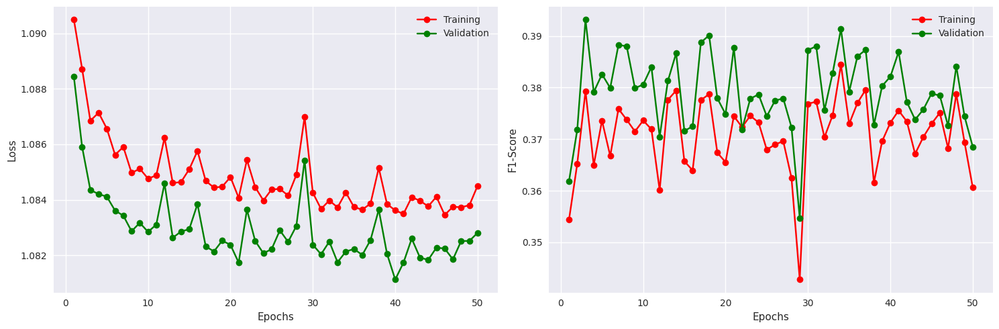


---------------------- Neural Network with 3 Hidden Layer of sizes 64 64 128 -----------------------

Time Taken:   		187.691
Average Loss: 		1.0819252641922836
F1-Score:     		0.3742855191230774
Accuracy:     		0.38914376497268677
Recall:       		0.38914376497268677
Precision:    		0.38996684551239014

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.53      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.40      0.20      0.27     12210		     NEUTRAL       0.39      0.20      0.26      1744
    POSITIVE       0.39      0.42      0.41     12210		    POSITIVE       0.39      0.43      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		  

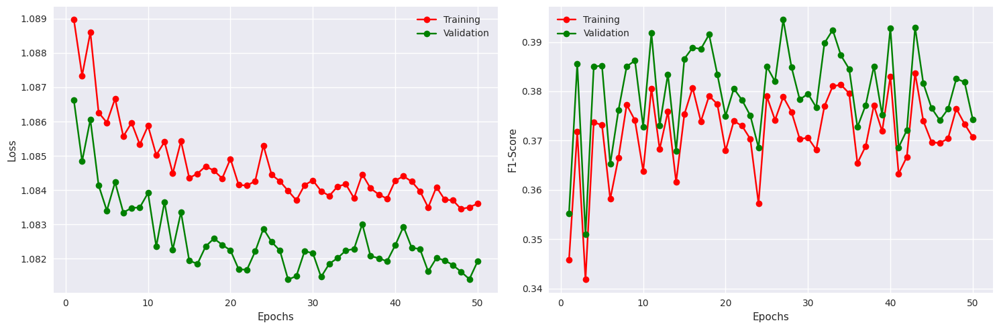


---------------------- Neural Network with 3 Hidden Layer of sizes 64 64 256 -----------------------

Time Taken:   		193.613
Average Loss: 		1.0821342318794414
F1-Score:     		0.37999552488327026
Accuracy:     		0.391437292098999
Recall:       		0.391437292098999
Precision:    		0.3914518356323242

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.39      0.54      0.45      1744
     NEUTRAL       0.39      0.23      0.29     12210		     NEUTRAL       0.39      0.23      0.29      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   mac

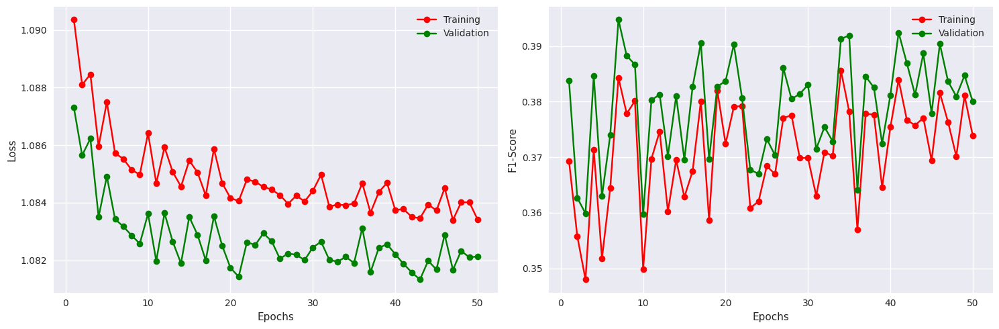


---------------------- Neural Network with 3 Hidden Layer of sizes 64 128 16 -----------------------

Time Taken:   		184.233
Average Loss: 		1.0815290872474694
F1-Score:     		0.38806235790252686
Accuracy:     		0.39124614000320435
Recall:       		0.39124614000320435
Precision:    		0.39124077558517456

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.39      0.48      0.43      1744
     NEUTRAL       0.38      0.31      0.34     12210		     NEUTRAL       0.38      0.31      0.34      1744
    POSITIVE       0.40      0.36      0.38     12210		    POSITIVE       0.41      0.38      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		 

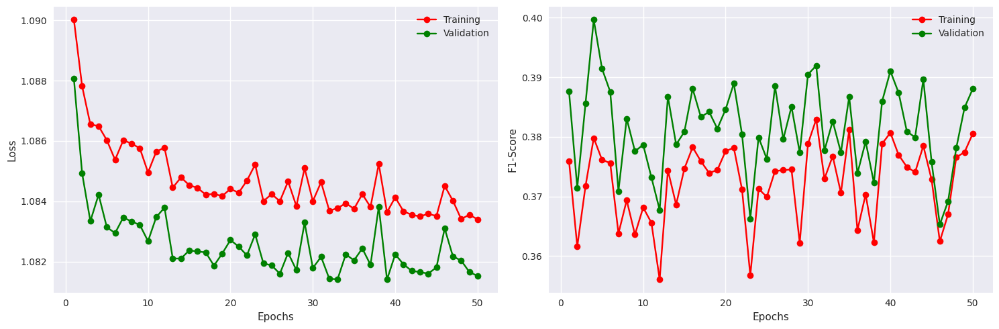


---------------------- Neural Network with 3 Hidden Layer of sizes 64 128 32 -----------------------

Time Taken:   		185.950
Average Loss: 		1.0821306260718482
F1-Score:     		0.3955307900905609
Accuracy:     		0.39640671014785767
Recall:       		0.39640671014785767
Precision:    		0.39602893590927124

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.43      0.40     12210		    NEGATIVE       0.40      0.44      0.42      1744
     NEUTRAL       0.38      0.35      0.36     12210		     NEUTRAL       0.39      0.35      0.36      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.41      0.41      0.41      1744
		
    accuracy                           0.39     36630		    accuracy                           0.40      5232
   macro avg       0.39      0.39      0.38     36630		  

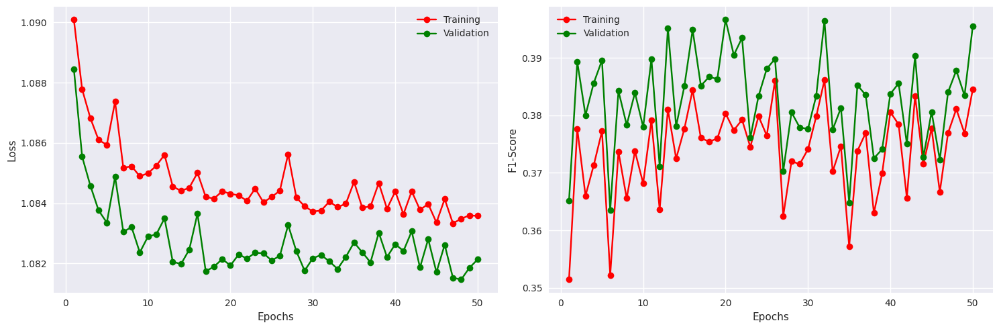


---------------------- Neural Network with 3 Hidden Layer of sizes 64 128 64 -----------------------

Time Taken:   		192.708
Average Loss: 		1.082241904480377
F1-Score:     		0.382016122341156
Accuracy:     		0.38704127073287964
Recall:       		0.38704127073287964
Precision:    		0.3892034590244293

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.51      0.43     12210		    NEGATIVE       0.38      0.52      0.44      1744
     NEUTRAL       0.38      0.32      0.35     12210		     NEUTRAL       0.37      0.31      0.34      1744
    POSITIVE       0.41      0.31      0.36     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   ma

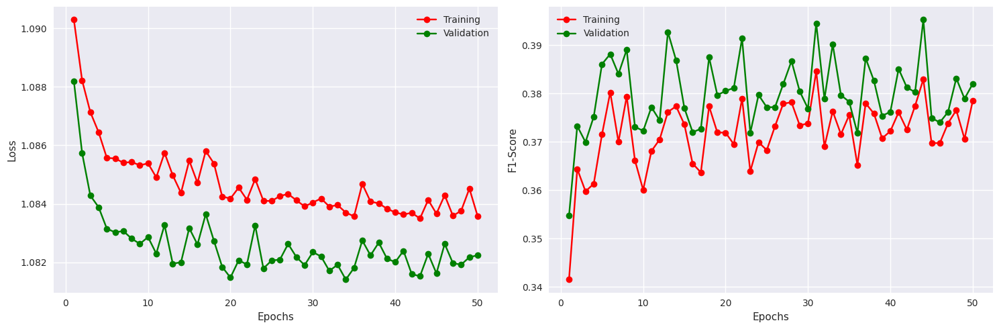


---------------------- Neural Network with 3 Hidden Layer of sizes 64 128 128 -----------------------

Time Taken:   		196.809
Average Loss: 		1.0819237589471566
F1-Score:     		0.3780120015144348
Accuracy:     		0.3891437351703644
Recall:       		0.3891437351703644
Precision:    		0.39272865653038025

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.57      0.45     12210		    NEGATIVE       0.38      0.59      0.46      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.42      0.29      0.34     12210		    POSITIVE       0.42      0.30      0.35      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

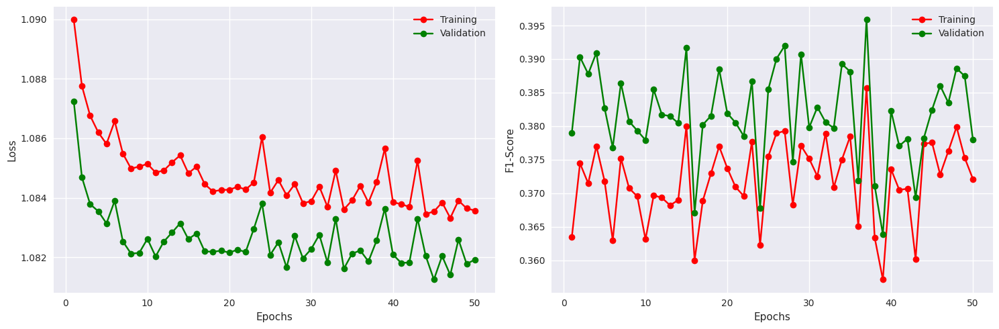


---------------------- Neural Network with 3 Hidden Layer of sizes 64 128 256 -----------------------

Time Taken:   		207.524
Average Loss: 		1.081538137128229
F1-Score:     		0.38418686389923096
Accuracy:     		0.39239296317100525
Recall:       		0.39239296317100525
Precision:    		0.39163732528686523

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.39      0.51      0.44      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.39      0.25      0.30      1744
    POSITIVE       0.40      0.41      0.40     12210		    POSITIVE       0.40      0.43      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		 

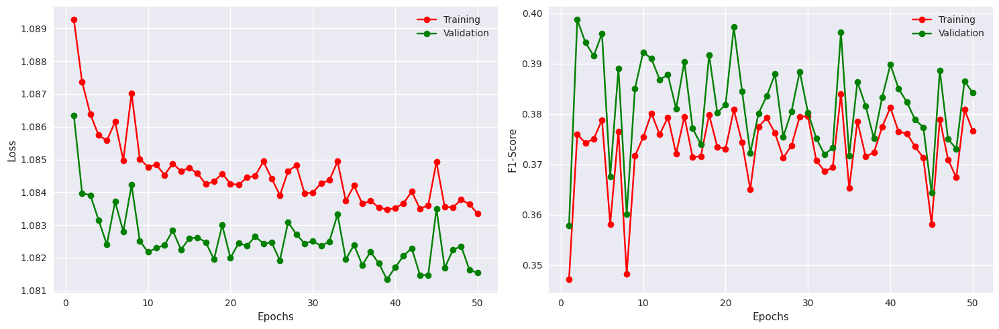


---------------------- Neural Network with 3 Hidden Layer of sizes 64 256 16 -----------------------

Time Taken:   		192.356
Average Loss: 		1.081656490990875
F1-Score:     		0.38942790031433105
Accuracy:     		0.39277520775794983
Recall:       		0.39277520775794983
Precision:    		0.3953949213027954

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.49      0.43     12210		    NEGATIVE       0.39      0.50      0.44      1744
     NEUTRAL       0.37      0.34      0.36     12210		     NEUTRAL       0.38      0.35      0.36      1744
    POSITIVE       0.41      0.31      0.36     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   

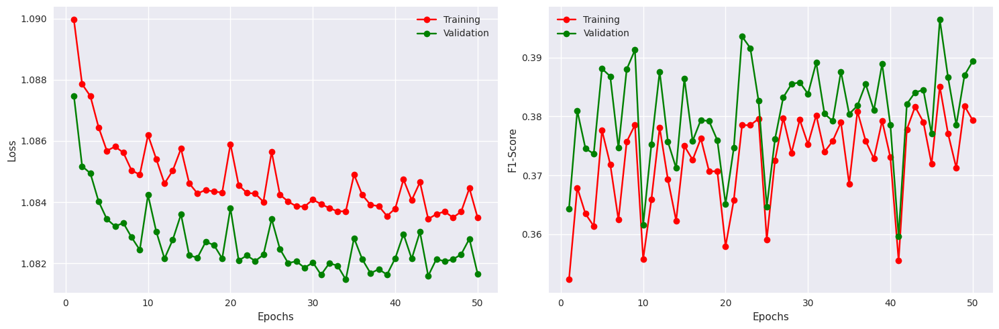


---------------------- Neural Network with 3 Hidden Layer of sizes 64 256 32 -----------------------

Time Taken:   		199.672
Average Loss: 		1.081781680430841
F1-Score:     		0.3841906487941742
Accuracy:     		0.3876146674156189
Recall:       		0.3876146674156189
Precision:    		0.389547199010849

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.49      0.42     12210		    NEGATIVE       0.38      0.50      0.43      1744
     NEUTRAL       0.37      0.34      0.35     12210		     NEUTRAL       0.37      0.34      0.35      1744
    POSITIVE       0.41      0.32      0.36     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   macr

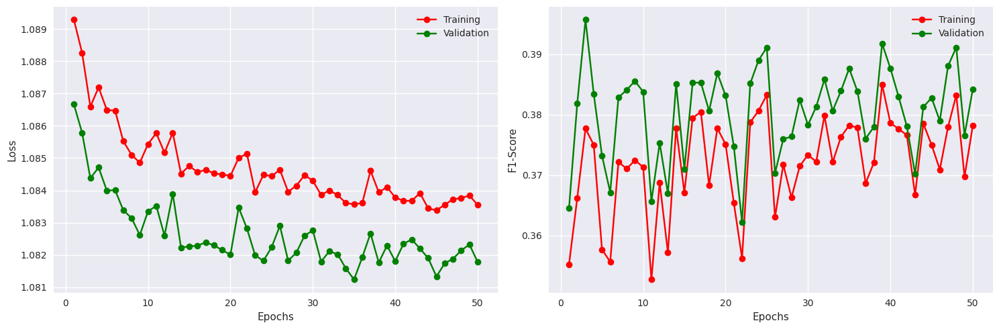


---------------------- Neural Network with 3 Hidden Layer of sizes 64 256 64 -----------------------

Time Taken:   		201.867
Average Loss: 		1.0819584043747787
F1-Score:     		0.3790399134159088
Accuracy:     		0.38933485746383667
Recall:       		0.38933485746383667
Precision:    		0.38841724395751953

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.39      0.51      0.44      1744
     NEUTRAL       0.39      0.23      0.29     12210		     NEUTRAL       0.38      0.22      0.28      1744
    POSITIVE       0.39      0.42      0.40     12210		    POSITIVE       0.40      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		  

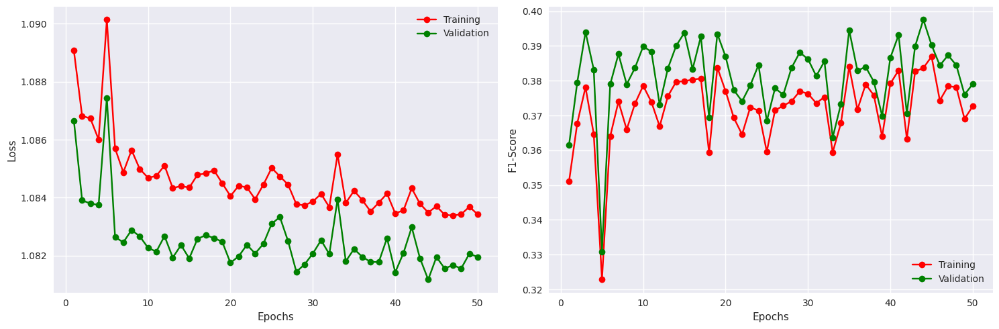


---------------------- Neural Network with 3 Hidden Layer of sizes 64 256 128 -----------------------

Time Taken:   		209.863
Average Loss: 		1.0821037215924045
F1-Score:     		0.3792015314102173
Accuracy:     		0.39086389541625977
Recall:       		0.39086389541625977
Precision:    		0.39490485191345215

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.59      0.46      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.42      0.29      0.34     12210		    POSITIVE       0.42      0.30      0.35      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		 

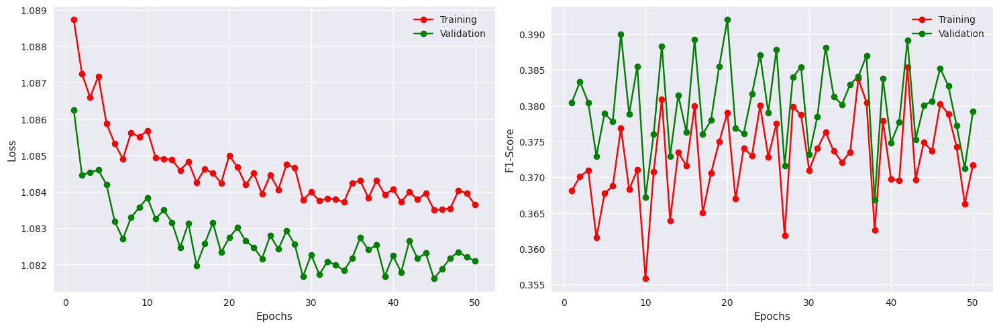


---------------------- Neural Network with 3 Hidden Layer of sizes 64 256 256 -----------------------

Time Taken:   		222.881
Average Loss: 		1.0825481084873187
F1-Score:     		0.3795769512653351
Accuracy:     		0.38264524936676025
Recall:       		0.38264524936676025
Precision:    		0.38591739535331726

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.46      0.41     12210		    NEGATIVE       0.38      0.47      0.42      1744
     NEUTRAL       0.37      0.39      0.38     12210		     NEUTRAL       0.36      0.39      0.37      1744
    POSITIVE       0.41      0.29      0.34     12210		    POSITIVE       0.41      0.30      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.38      5232
   macro avg       0.38      0.38      0.38     36630		 

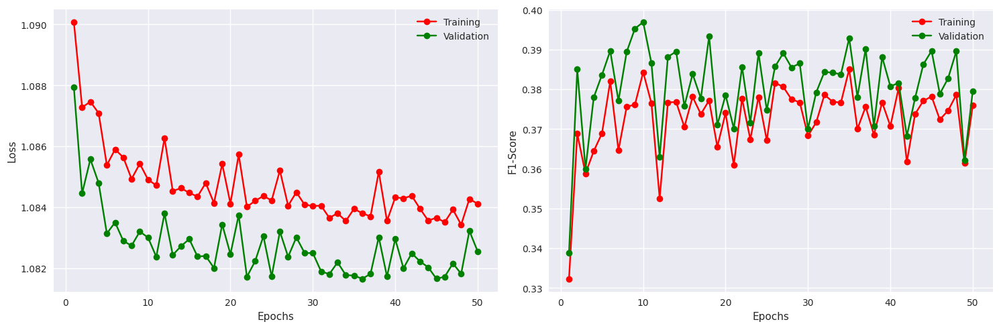


---------------------- Neural Network with 3 Hidden Layer of sizes 128 16 16 -----------------------

Time Taken:   		180.222
Average Loss: 		1.081628498863372
F1-Score:     		0.3798291087150574
Accuracy:     		0.3902904987335205
Recall:       		0.3902904987335205
Precision:    		0.39123550057411194

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.52      0.43     12210		    NEGATIVE       0.38      0.53      0.44      1744
     NEUTRAL       0.39      0.23      0.29     12210		     NEUTRAL       0.39      0.23      0.29      1744
    POSITIVE       0.40      0.40      0.40     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   ma

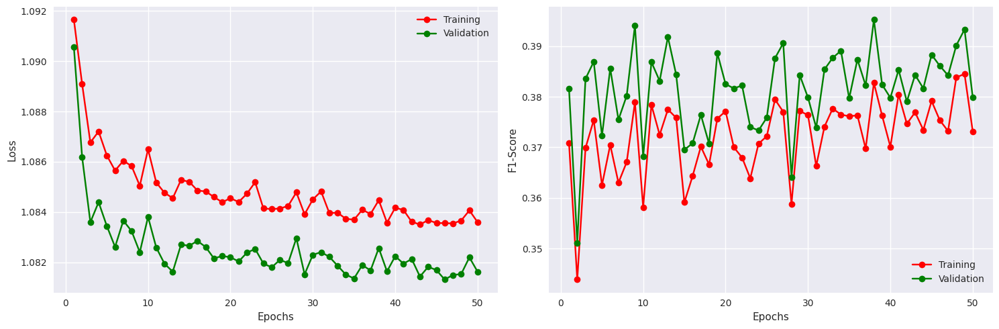


---------------------- Neural Network with 3 Hidden Layer of sizes 128 16 32 -----------------------

Time Taken:   		181.037
Average Loss: 		1.0820919885912437
F1-Score:     		0.38255393505096436
Accuracy:     		0.3872324228286743
Recall:       		0.3872324228286743
Precision:    		0.3854959011077881

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.44      0.40     12210		    NEGATIVE       0.39      0.44      0.41      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.37      0.27      0.31      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.39      0.45      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

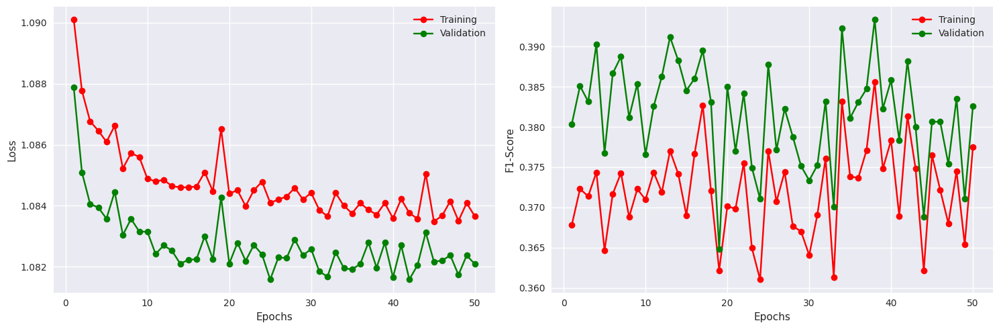


---------------------- Neural Network with 3 Hidden Layer of sizes 128 16 64 -----------------------

Time Taken:   		180.750
Average Loss: 		1.0821992867948083
F1-Score:     		0.3776252567768097
Accuracy:     		0.38971713185310364
Recall:       		0.38971713185310364
Precision:    		0.3953123390674591

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.60      0.46      1744
     NEUTRAL       0.38      0.29      0.33     12210		     NEUTRAL       0.38      0.29      0.33      1744
    POSITIVE       0.42      0.28      0.33     12210		    POSITIVE       0.42      0.28      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

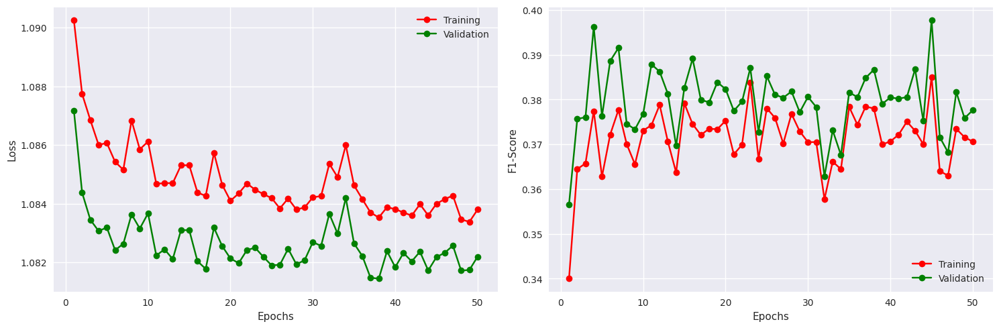


---------------------- Neural Network with 3 Hidden Layer of sizes 128 16 128 -----------------------

Time Taken:   		180.340
Average Loss: 		1.0818870827692364
F1-Score:     		0.3820236921310425
Accuracy:     		0.3889526128768921
Recall:       		0.3889526128768921
Precision:    		0.3900006413459778

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.53      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.41      0.35      0.38      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

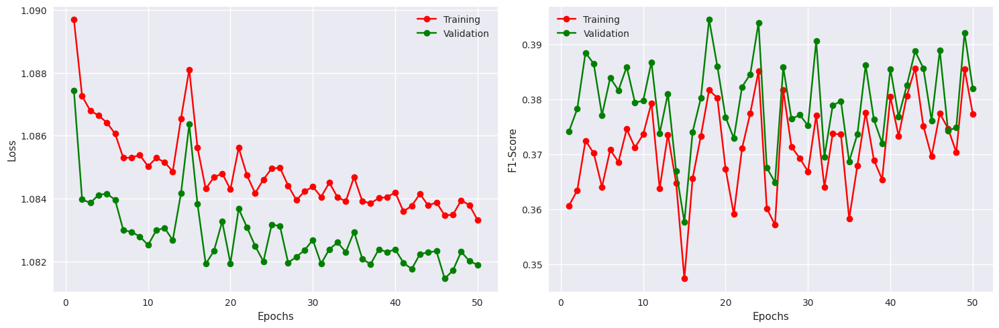


---------------------- Neural Network with 3 Hidden Layer of sizes 128 16 256 -----------------------

Time Taken:   		187.130
Average Loss: 		1.0836856943022586
F1-Score:     		0.3722696006298065
Accuracy:     		0.3933486342430115
Recall:       		0.3933486342430115
Precision:    		0.40129655599594116

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.59      0.46     12210		    NEGATIVE       0.38      0.59      0.46      1744
     NEUTRAL       0.41      0.17      0.24     12210		     NEUTRAL       0.42      0.17      0.25      1744
    POSITIVE       0.40      0.41      0.40     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.36     36630		   

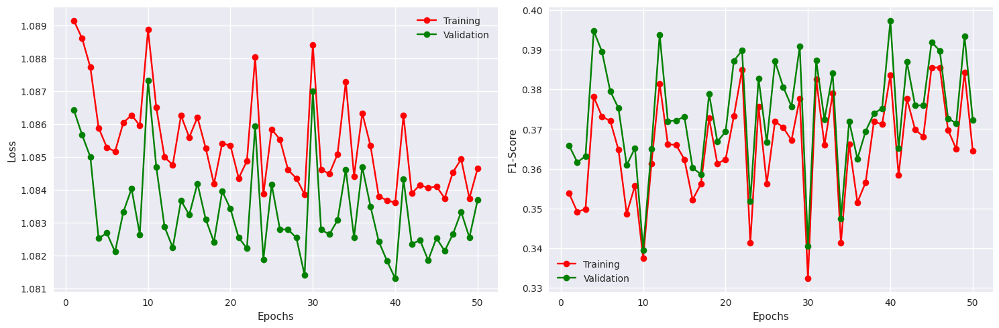


---------------------- Neural Network with 3 Hidden Layer of sizes 128 32 16 -----------------------

Time Taken:   		182.832
Average Loss: 		1.082382958416545
F1-Score:     		0.3713683485984802
Accuracy:     		0.3916284441947937
Recall:       		0.3916284441947937
Precision:    		0.3987559676170349

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.64      0.47     12210		    NEGATIVE       0.38      0.65      0.48      1744
     NEUTRAL       0.40      0.21      0.28     12210		     NEUTRAL       0.40      0.22      0.28      1744
    POSITIVE       0.42      0.30      0.35     12210		    POSITIVE       0.42      0.30      0.35      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.40      0.39      0.37     36630		   mac

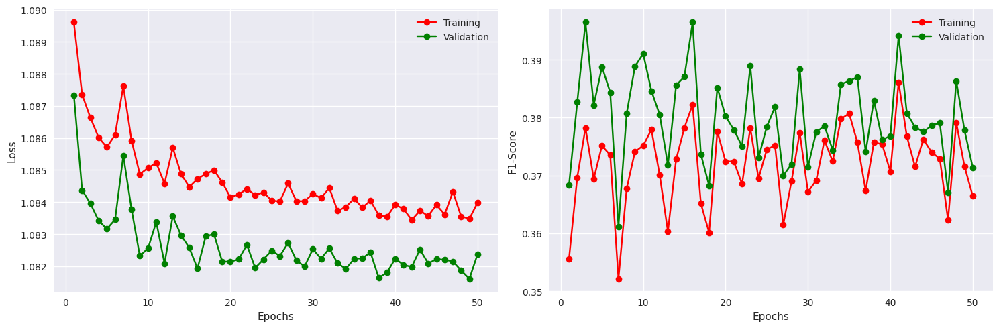


---------------------- Neural Network with 3 Hidden Layer of sizes 128 32 32 -----------------------

Time Taken:   		182.532
Average Loss: 		1.0820439988320028
F1-Score:     		0.37492114305496216
Accuracy:     		0.3933486342430115
Recall:       		0.3933486342430115
Precision:    		0.3990398645401001

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.61      0.46     12210		    NEGATIVE       0.38      0.62      0.47      1744
     NEUTRAL       0.40      0.20      0.26     12210		     NEUTRAL       0.40      0.20      0.27      1744
    POSITIVE       0.41      0.35      0.37     12210		    POSITIVE       0.42      0.36      0.39      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   m

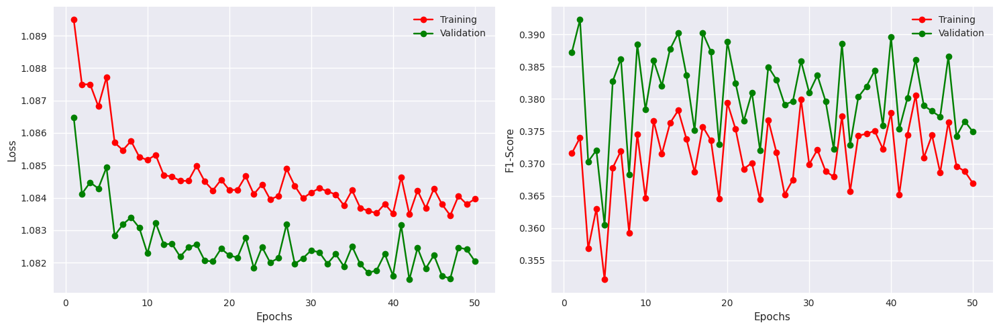


---------------------- Neural Network with 3 Hidden Layer of sizes 128 32 64 -----------------------

Time Taken:   		183.586
Average Loss: 		1.0815883492111067
F1-Score:     		0.38699063658714294
Accuracy:     		0.39105504751205444
Recall:       		0.39105504751205444
Precision:    		0.39034396409988403

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.39      0.48      0.43      1744
     NEUTRAL       0.38      0.29      0.33     12210		     NEUTRAL       0.38      0.29      0.33      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.41      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		 

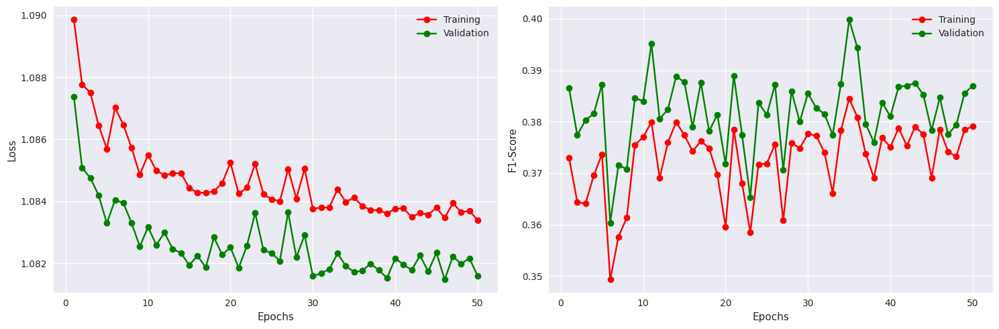


---------------------- Neural Network with 3 Hidden Layer of sizes 128 32 128 -----------------------

Time Taken:   		186.898
Average Loss: 		1.0823708721621685
F1-Score:     		0.3735308051109314
Accuracy:     		0.39086389541625977
Recall:       		0.39086389541625977
Precision:    		0.3971795439720154

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.62      0.46     12210		    NEGATIVE       0.38      0.63      0.47      1744
     NEUTRAL       0.39      0.22      0.29     12210		     NEUTRAL       0.40      0.23      0.29      1744
    POSITIVE       0.42      0.31      0.36     12210		    POSITIVE       0.42      0.32      0.36      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		  

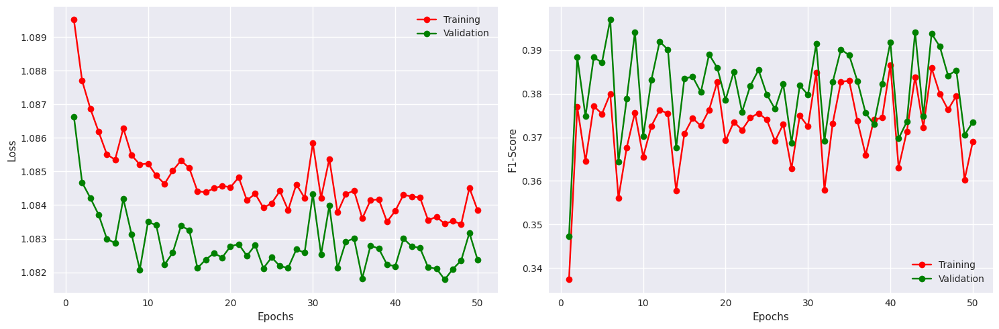


---------------------- Neural Network with 3 Hidden Layer of sizes 128 32 256 -----------------------

Time Taken:   		207.522
Average Loss: 		1.082060558715727
F1-Score:     		0.39352262020111084
Accuracy:     		0.3960244655609131
Recall:       		0.3960244655609131
Precision:    		0.3971238434314728

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.48      0.42     12210		    NEGATIVE       0.39      0.49      0.43      1744
     NEUTRAL       0.38      0.34      0.36     12210		     NEUTRAL       0.38      0.34      0.36      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.42      0.36      0.38      1744
		
    accuracy                           0.39     36630		    accuracy                           0.40      5232
   macro avg       0.39      0.39      0.38     36630		   m

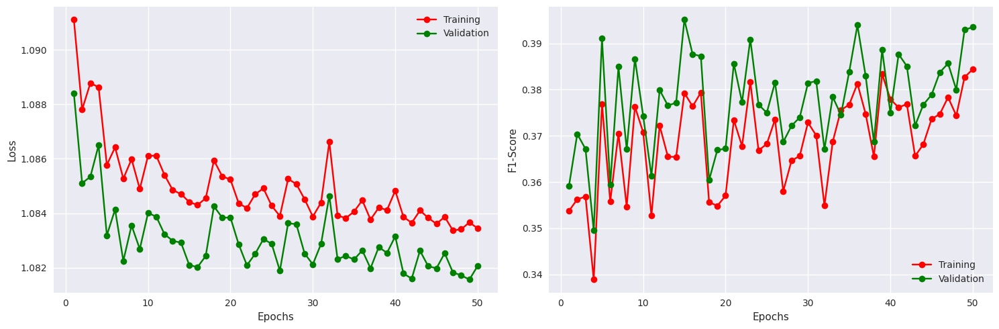


---------------------- Neural Network with 3 Hidden Layer of sizes 128 64 16 -----------------------

Time Taken:   		260.395
Average Loss: 		1.0817258337951217
F1-Score:     		0.38324618339538574
Accuracy:     		0.39105504751205444
Recall:       		0.39105504751205444
Precision:    		0.3919316530227661

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.54      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.38      0.27      0.32      1744
    POSITIVE       0.41      0.35      0.38     12210		    POSITIVE       0.41      0.36      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		  

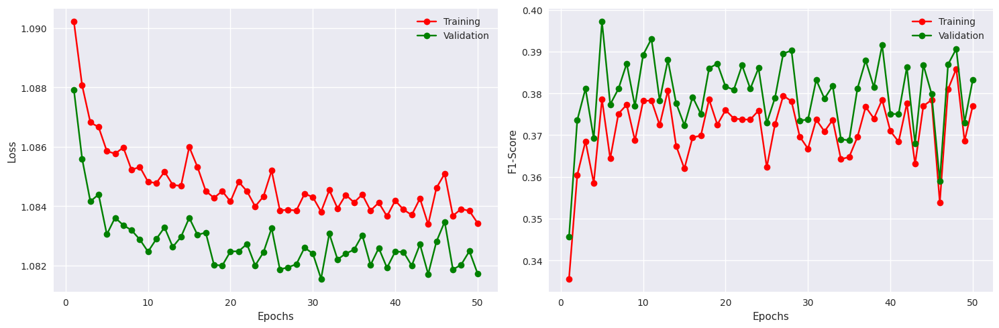


---------------------- Neural Network with 3 Hidden Layer of sizes 128 64 32 -----------------------

Time Taken:   		205.005
Average Loss: 		1.0814571070743992
F1-Score:     		0.3857330083847046
Accuracy:     		0.3929663598537445
Recall:       		0.3929663598537445
Precision:    		0.39495334029197693

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.53      0.44     12210		    NEGATIVE       0.38      0.54      0.45      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.39      0.27      0.32      1744
    POSITIVE       0.41      0.35      0.38     12210		    POSITIVE       0.41      0.37      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

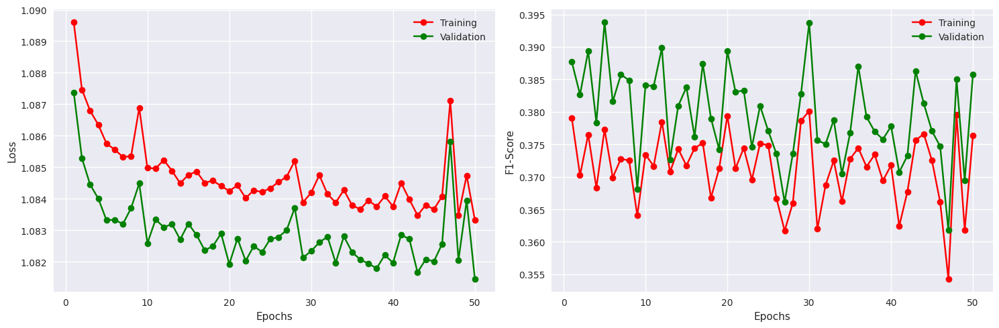


---------------------- Neural Network with 3 Hidden Layer of sizes 128 64 64 -----------------------

Time Taken:   		194.738
Average Loss: 		1.0816998496332664
F1-Score:     		0.38191184401512146
Accuracy:     		0.3918195962905884
Recall:       		0.3918195962905884
Precision:    		0.39449256658554077

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.56      0.45     12210		    NEGATIVE       0.38      0.56      0.45      1744
     NEUTRAL       0.38      0.25      0.31     12210		     NEUTRAL       0.39      0.26      0.31      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.42      0.36      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

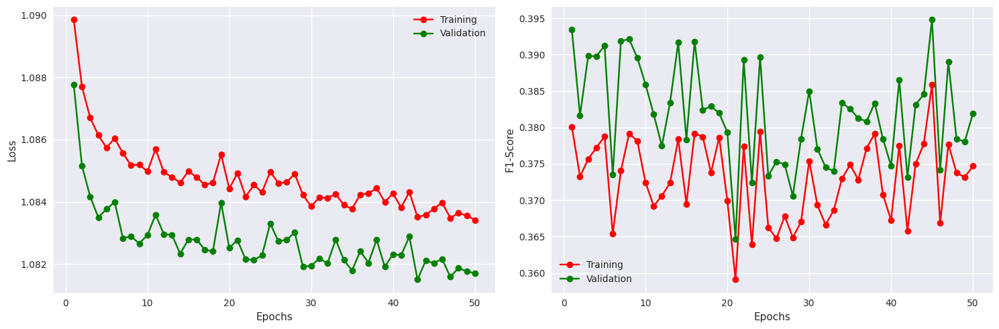


---------------------- Neural Network with 3 Hidden Layer of sizes 128 64 128 -----------------------

Time Taken:   		202.330
Average Loss: 		1.0820781747135548
F1-Score:     		0.36974385380744934
Accuracy:     		0.389143705368042
Recall:       		0.389143705368042
Precision:    		0.39572852849960327

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.59      0.46     12210		    NEGATIVE       0.38      0.59      0.46      1744
     NEUTRAL       0.41      0.17      0.24     12210		     NEUTRAL       0.41      0.18      0.25      1744
    POSITIVE       0.40      0.39      0.40     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   m

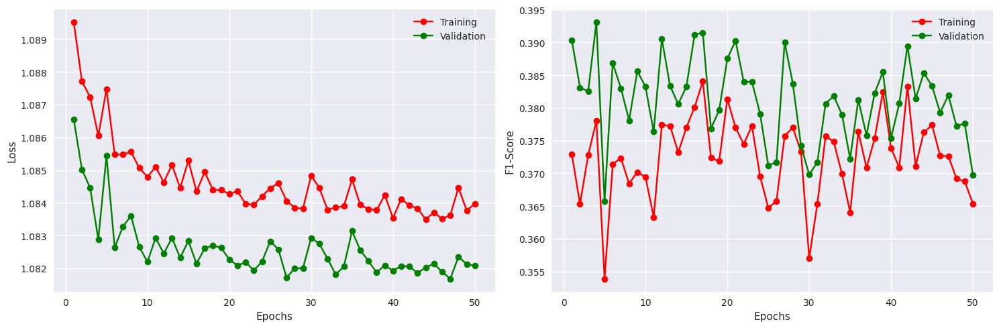


---------------------- Neural Network with 3 Hidden Layer of sizes 128 64 256 -----------------------

Time Taken:   		206.376
Average Loss: 		1.082655940033974
F1-Score:     		0.39355161786079407
Accuracy:     		0.39392200112342834
Recall:       		0.39392200112342834
Precision:    		0.39516475796699524

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.34      0.36     12210		    NEGATIVE       0.41      0.35      0.38      1744
     NEUTRAL       0.37      0.42      0.40     12210		     NEUTRAL       0.37      0.42      0.39      1744
    POSITIVE       0.39      0.38      0.39     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		 

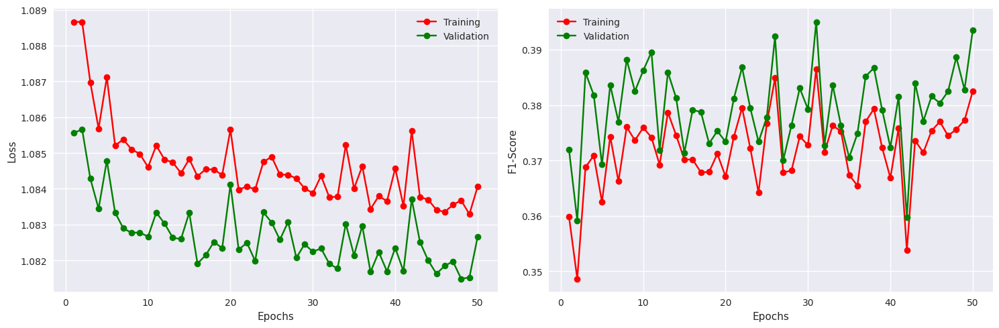


---------------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 -----------------------

Time Taken:   		213.647
Average Loss: 		1.081766934205268
F1-Score:     		0.39662203192710876
Accuracy:     		0.39659786224365234
Recall:       		0.39659786224365234
Precision:    		0.3970946967601776

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.41      0.39     12210		    NEGATIVE       0.39      0.41      0.40      1744
     NEUTRAL       0.37      0.39      0.38     12210		     NEUTRAL       0.38      0.39      0.38      1744
    POSITIVE       0.40      0.36      0.38     12210		    POSITIVE       0.42      0.39      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.40      5232
   macro avg       0.38      0.38      0.38     36630		  

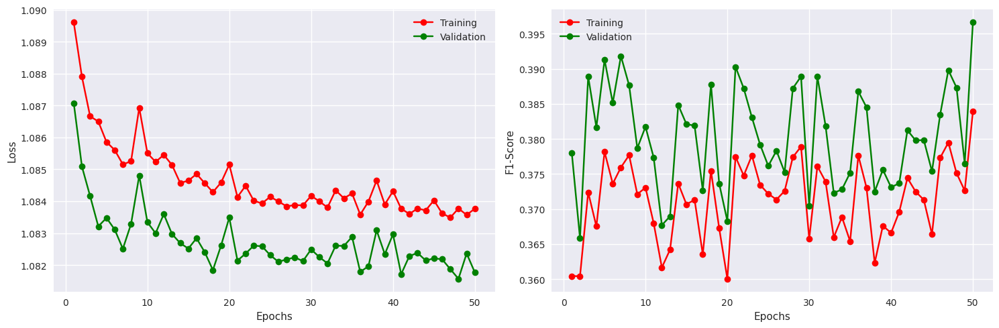


---------------------- Neural Network with 3 Hidden Layer of sizes 128 128 32 -----------------------

Time Taken:   		215.777
Average Loss: 		1.0815271972151708
F1-Score:     		0.3847891688346863
Accuracy:     		0.3887614607810974
Recall:       		0.3887614607810974
Precision:    		0.3911374807357788

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.38      0.51      0.44      1744
     NEUTRAL       0.37      0.33      0.35     12210		     NEUTRAL       0.37      0.32      0.34      1744
    POSITIVE       0.41      0.32      0.36     12210		    POSITIVE       0.42      0.34      0.38      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

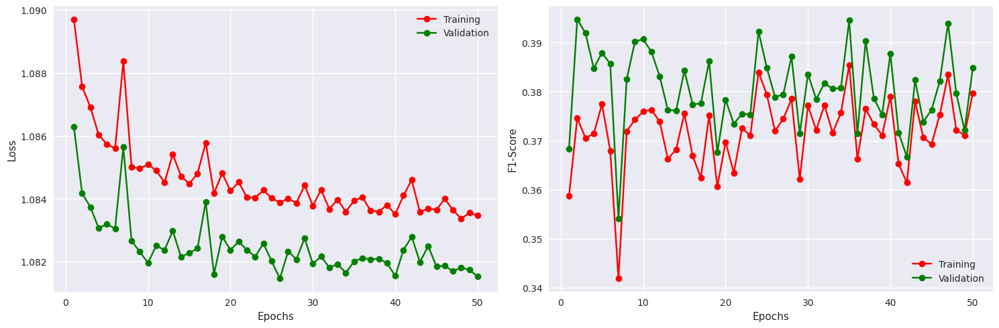


---------------------- Neural Network with 3 Hidden Layer of sizes 128 128 64 -----------------------

Time Taken:   		194.548
Average Loss: 		1.0818285276765853
F1-Score:     		0.39047878980636597
Accuracy:     		0.39392200112342834
Recall:       		0.39392200112342834
Precision:    		0.39356619119644165

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.39      0.48      0.43      1744
     NEUTRAL       0.37      0.30      0.33     12210		     NEUTRAL       0.38      0.30      0.34      1744
    POSITIVE       0.40      0.37      0.38     12210		    POSITIVE       0.41      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		

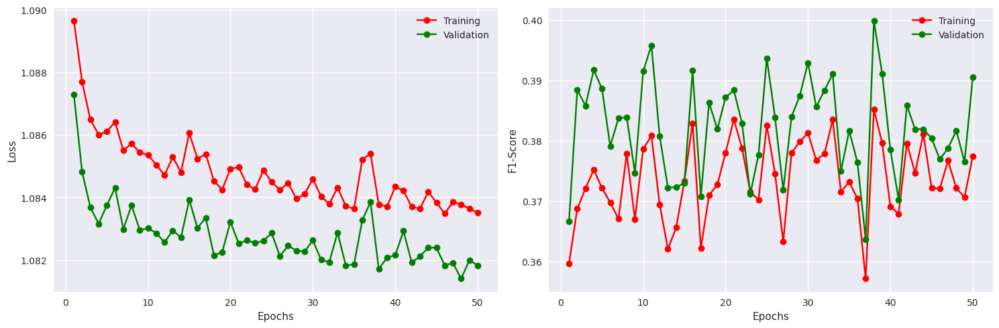


---------------------- Neural Network with 3 Hidden Layer of sizes 128 128 128 -----------------------

Time Taken:   		199.453
Average Loss: 		1.081771769472583
F1-Score:     		0.3788008689880371
Accuracy:     		0.3899082541465759
Recall:       		0.3899082541465759
Precision:    		0.3940958082675934

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.38      0.26      0.31     12210		     NEUTRAL       0.39      0.26      0.31      1744
    POSITIVE       0.41      0.31      0.35     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   m

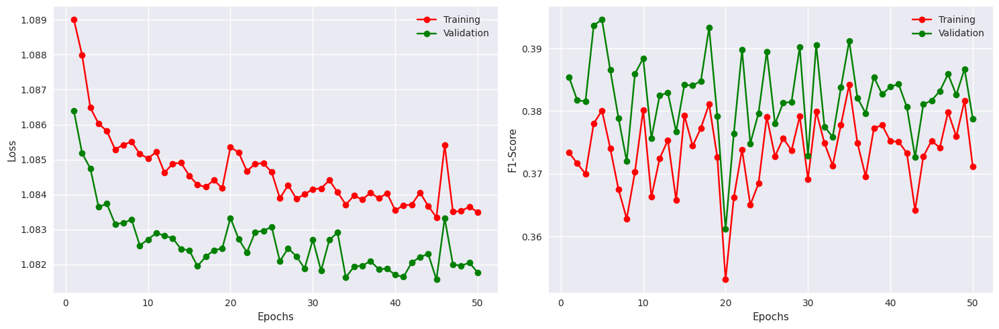


---------------------- Neural Network with 3 Hidden Layer of sizes 128 128 256 -----------------------

Time Taken:   		208.404
Average Loss: 		1.0822754159615309
F1-Score:     		0.39161810278892517
Accuracy:     		0.39258408546447754
Recall:       		0.39258408546447754
Precision:    		0.3942873775959015

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.44      0.40     12210		    NEGATIVE       0.39      0.45      0.42      1744
     NEUTRAL       0.37      0.38      0.37     12210		     NEUTRAL       0.38      0.39      0.38      1744
    POSITIVE       0.40      0.32      0.36     12210		    POSITIVE       0.42      0.35      0.38      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		

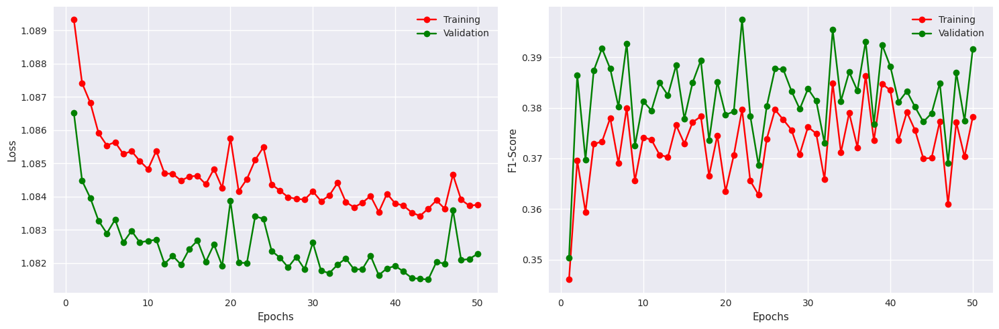


---------------------- Neural Network with 3 Hidden Layer of sizes 128 256 16 -----------------------

Time Taken:   		194.808
Average Loss: 		1.0815539168655326
F1-Score:     		0.3728676438331604
Accuracy:     		0.3876146674156189
Recall:       		0.3876146674156189
Precision:    		0.38851165771484375

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.55      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.39      0.20      0.27     12210		     NEUTRAL       0.39      0.20      0.26      1744
    POSITIVE       0.40      0.40      0.40     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

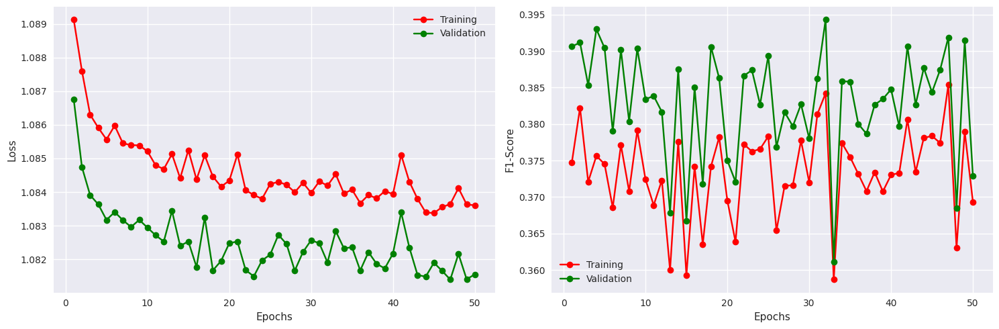


---------------------- Neural Network with 3 Hidden Layer of sizes 128 256 32 -----------------------

Time Taken:   		202.149
Average Loss: 		1.0814810783491222
F1-Score:     		0.3863162398338318
Accuracy:     		0.3899082541465759
Recall:       		0.3899082541465759
Precision:    		0.3893257975578308

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.46      0.41     12210		    NEGATIVE       0.39      0.47      0.42      1744
     NEUTRAL       0.38      0.29      0.33     12210		     NEUTRAL       0.38      0.29      0.33      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

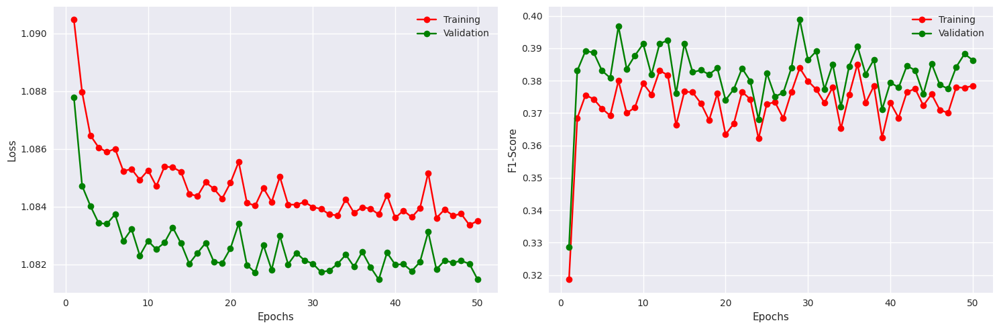


---------------------- Neural Network with 3 Hidden Layer of sizes 128 256 64 -----------------------

Time Taken:   		207.084
Average Loss: 		1.0822227230859458
F1-Score:     		0.38097095489501953
Accuracy:     		0.38685017824172974
Recall:       		0.38685017824172974
Precision:    		0.39246004819869995

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.38      0.51      0.44      1744
     NEUTRAL       0.37      0.37      0.37     12210		     NEUTRAL       0.37      0.37      0.37      1744
    POSITIVE       0.42      0.26      0.32     12210		    POSITIVE       0.43      0.28      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		

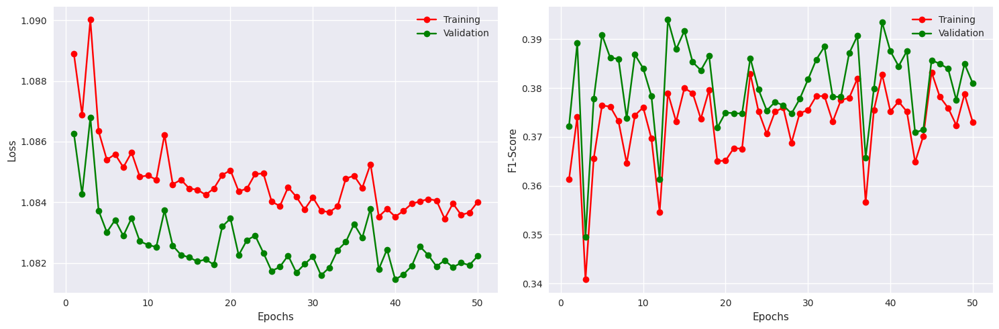


---------------------- Neural Network with 3 Hidden Layer of sizes 128 256 128 -----------------------

Time Taken:   		214.914
Average Loss: 		1.0820218630886953
F1-Score:     		0.3786175549030304
Accuracy:     		0.3920106887817383
Recall:       		0.3920106887817383
Precision:    		0.396719753742218

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.60      0.46     12210		    NEGATIVE       0.38      0.60      0.47      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.39      0.25      0.31      1744
    POSITIVE       0.41      0.31      0.36     12210		    POSITIVE       0.42      0.32      0.36      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   m

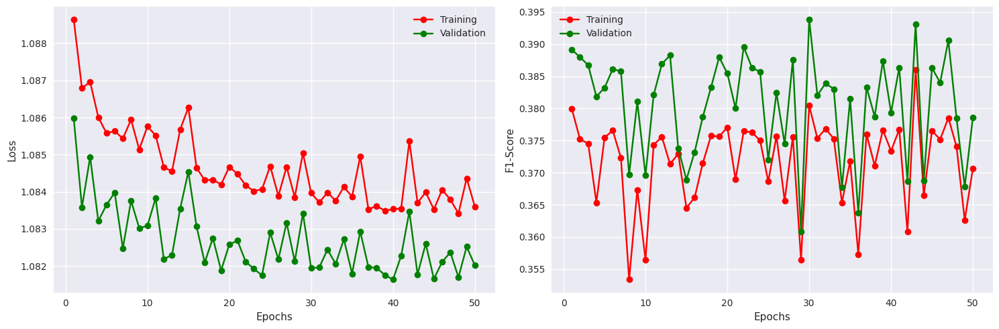


---------------------- Neural Network with 3 Hidden Layer of sizes 128 256 256 -----------------------

Time Taken:   		225.654
Average Loss: 		1.0820700712160234
F1-Score:     		0.3727874159812927
Accuracy:     		0.3914373219013214
Recall:       		0.3914373219013214
Precision:    		0.39702165126800537

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.40      0.18      0.25     12210		     NEUTRAL       0.41      0.18      0.25      1744
    POSITIVE       0.40      0.40      0.40     12210		    POSITIVE       0.40      0.41      0.40      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		  

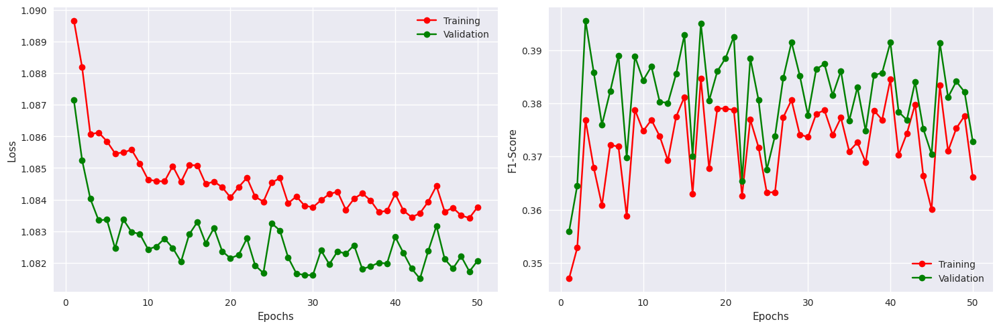


---------------------- Neural Network with 3 Hidden Layer of sizes 256 16 16 -----------------------

Time Taken:   		185.615
Average Loss: 		1.0823723309266093
F1-Score:     		0.38451552391052246
Accuracy:     		0.39220184087753296
Recall:       		0.39220184087753296
Precision:    		0.3924694061279297

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.39      0.50      0.44      1744
     NEUTRAL       0.38      0.25      0.30     12210		     NEUTRAL       0.39      0.25      0.31      1744
    POSITIVE       0.39      0.40      0.40     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		  

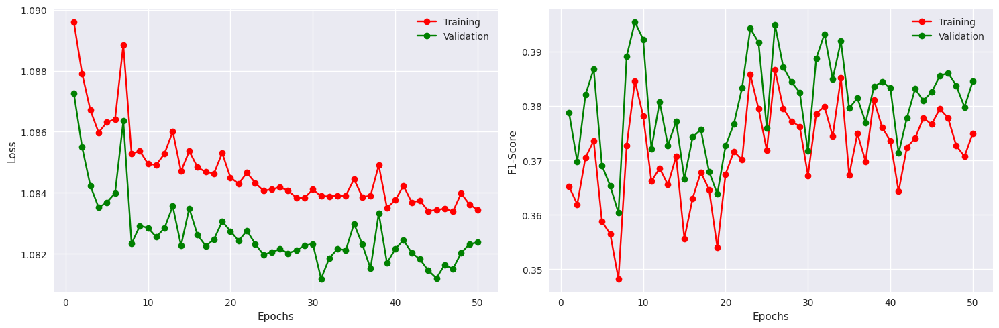


---------------------- Neural Network with 3 Hidden Layer of sizes 256 16 32 -----------------------

Time Taken:   		185.186
Average Loss: 		1.0816511849015495
F1-Score:     		0.3822140693664551
Accuracy:     		0.3929663300514221
Recall:       		0.3929663300514221
Precision:    		0.3957917094230652

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.56      0.45     12210		    NEGATIVE       0.38      0.57      0.46      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.39      0.25      0.31      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.41      0.36      0.38      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   ma

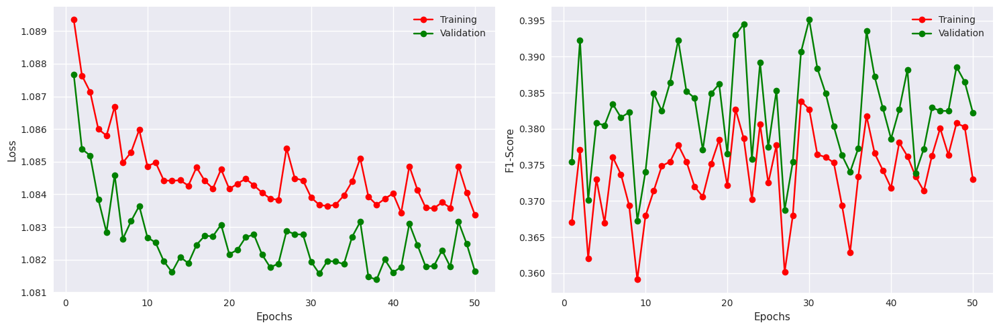


---------------------- Neural Network with 3 Hidden Layer of sizes 256 16 64 -----------------------

Time Taken:   		187.510
Average Loss: 		1.0827697792549016
F1-Score:     		0.3793676197528839
Accuracy:     		0.38837921619415283
Recall:       		0.38837921619415283
Precision:    		0.39045238494873047

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.55      0.44     12210		    NEGATIVE       0.38      0.56      0.45      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.41      0.32      0.36     12210		    POSITIVE       0.41      0.33      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		  

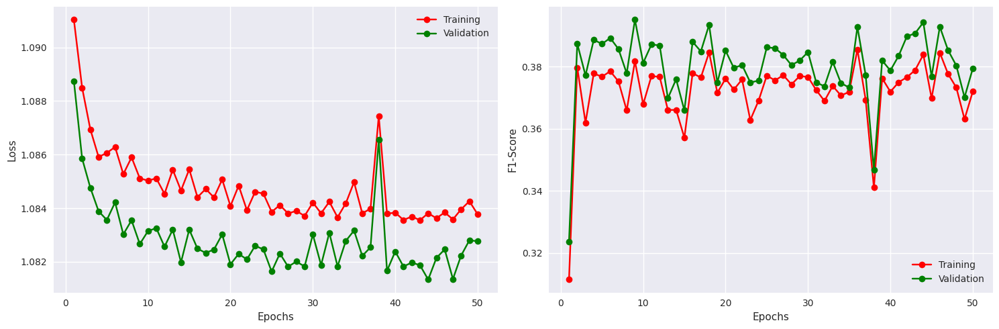


---------------------- Neural Network with 3 Hidden Layer of sizes 256 16 128 -----------------------

Time Taken:   		188.206
Average Loss: 		1.081455909695465
F1-Score:     		0.38638442754745483
Accuracy:     		0.39067280292510986
Recall:       		0.39067280292510986
Precision:    		0.3894954025745392

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.47      0.42     12210		    NEGATIVE       0.39      0.47      0.43      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.40      0.40      0.40     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		  

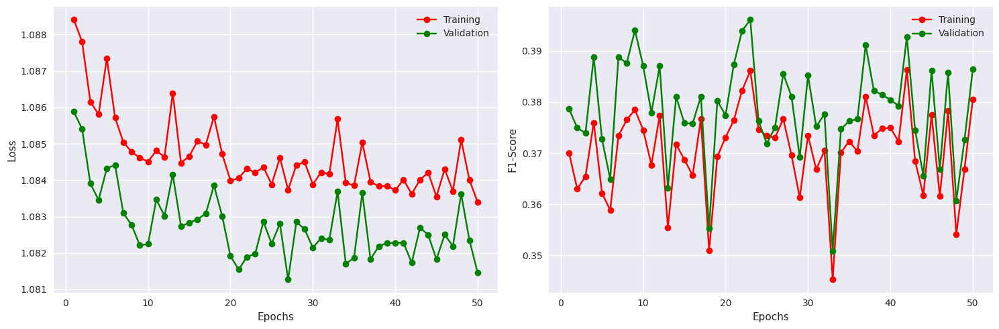


---------------------- Neural Network with 3 Hidden Layer of sizes 256 16 256 -----------------------

Time Taken:   		190.189
Average Loss: 		1.0832658750930693
F1-Score:     		0.36525779962539673
Accuracy:     		0.38952600955963135
Recall:       		0.38952600955963135
Precision:    		0.39518511295318604

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.62      0.46     12210		    NEGATIVE       0.38      0.62      0.47      1744
     NEUTRAL       0.42      0.16      0.23     12210		     NEUTRAL       0.40      0.16      0.23      1744
    POSITIVE       0.40      0.37      0.39     12210		    POSITIVE       0.41      0.39      0.40      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.40      0.39      0.36     36630		

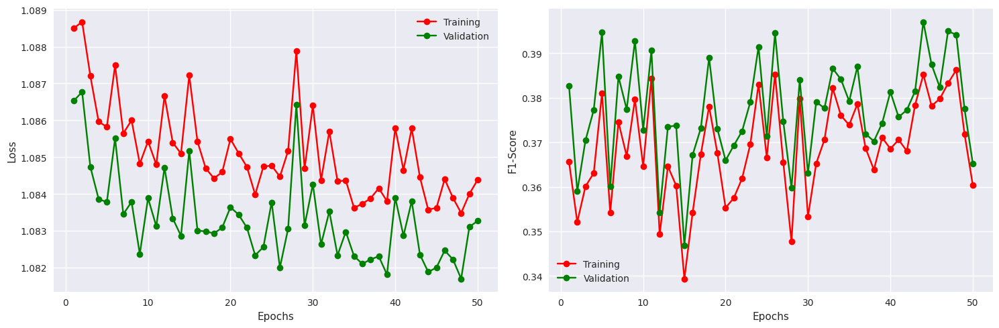


---------------------- Neural Network with 3 Hidden Layer of sizes 256 32 16 -----------------------

Time Taken:   		191.050
Average Loss: 		1.0821238271322455
F1-Score:     		0.37235337495803833
Accuracy:     		0.38971710205078125
Recall:       		0.38971710205078125
Precision:    		0.39307087659835815

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.55      0.44     12210		    NEGATIVE       0.38      0.55      0.45      1744
     NEUTRAL       0.40      0.18      0.25     12210		     NEUTRAL       0.40      0.18      0.25      1744
    POSITIVE       0.39      0.43      0.41     12210		    POSITIVE       0.39      0.44      0.42      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		 

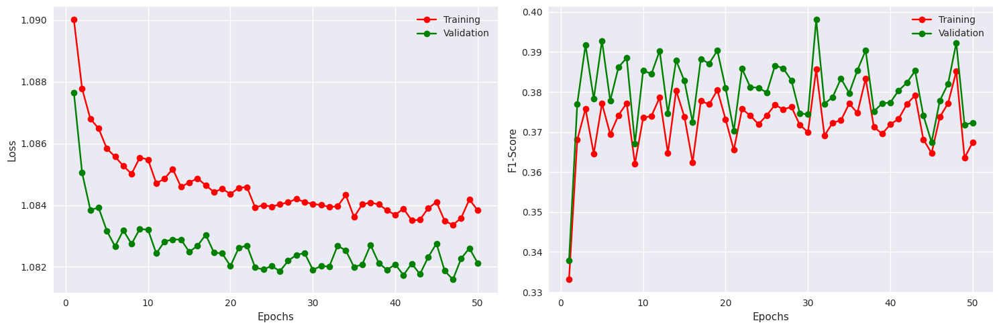


---------------------- Neural Network with 3 Hidden Layer of sizes 256 32 32 -----------------------

Time Taken:   		190.279
Average Loss: 		1.081356248542074
F1-Score:     		0.3787575662136078
Accuracy:     		0.38818806409835815
Recall:       		0.38818806409835815
Precision:    		0.38772082328796387

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.53      0.44     12210		    NEGATIVE       0.38      0.53      0.44      1744
     NEUTRAL       0.39      0.24      0.30     12210		     NEUTRAL       0.38      0.24      0.29      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   

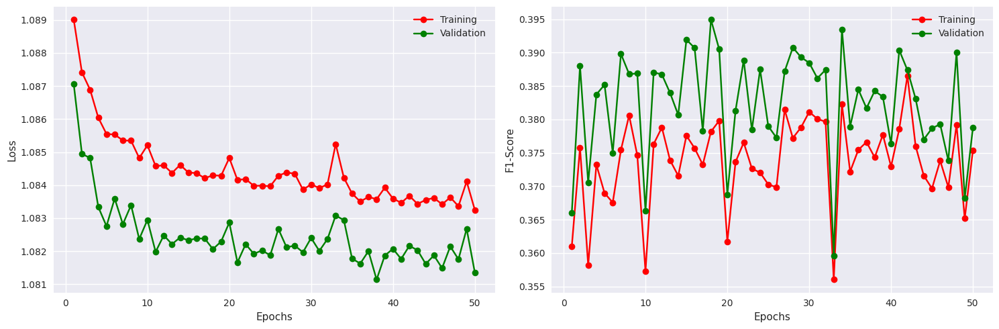


---------------------- Neural Network with 3 Hidden Layer of sizes 256 32 64 -----------------------

Time Taken:   		192.525
Average Loss: 		1.0821165546364742
F1-Score:     		0.377392053604126
Accuracy:     		0.3918195962905884
Recall:       		0.3918195962905884
Precision:    		0.3940783441066742

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.46      0.41     12210		    NEGATIVE       0.39      0.47      0.43      1744
     NEUTRAL       0.39      0.19      0.26     12210		     NEUTRAL       0.40      0.20      0.27      1744
    POSITIVE       0.38      0.49      0.43     12210		    POSITIVE       0.39      0.51      0.44      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   mac

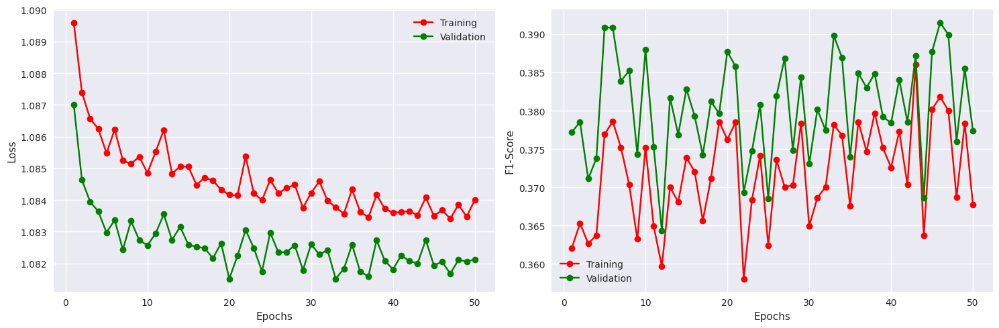


---------------------- Neural Network with 3 Hidden Layer of sizes 256 32 128 -----------------------

Time Taken:   		194.507
Average Loss: 		1.082206108154507
F1-Score:     		0.37817856669425964
Accuracy:     		0.3891437351703644
Recall:       		0.3891437351703644
Precision:    		0.3915690779685974

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.57      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.38      0.27      0.32     12210		     NEUTRAL       0.38      0.27      0.31      1744
    POSITIVE       0.41      0.31      0.35     12210		    POSITIVE       0.42      0.32      0.36      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   m

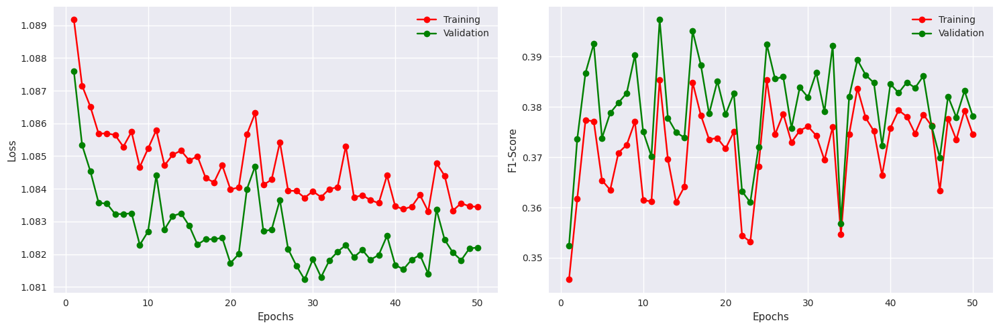


---------------------- Neural Network with 3 Hidden Layer of sizes 256 32 256 -----------------------

Time Taken:   		204.434
Average Loss: 		1.081864666865871
F1-Score:     		0.3859235644340515
Accuracy:     		0.3906727731227875
Recall:       		0.3906727731227875
Precision:    		0.39304518699645996

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.52      0.43     12210		    NEGATIVE       0.38      0.52      0.44      1744
     NEUTRAL       0.37      0.32      0.35     12210		     NEUTRAL       0.38      0.33      0.35      1744
    POSITIVE       0.41      0.31      0.35     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

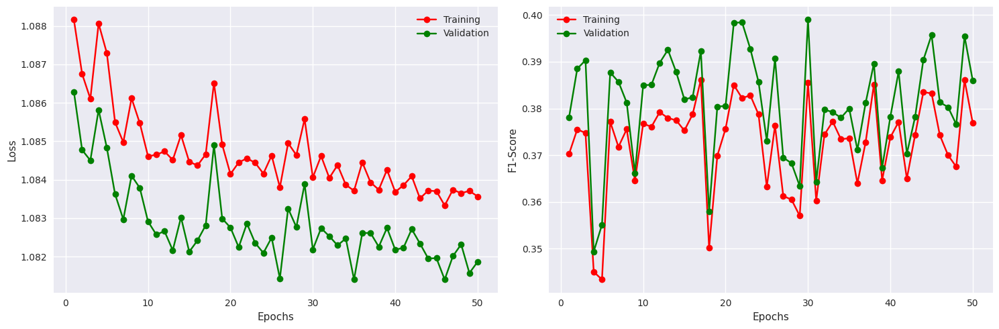


---------------------- Neural Network with 3 Hidden Layer of sizes 256 64 16 -----------------------

Time Taken:   		196.919
Average Loss: 		1.0824051415519247
F1-Score:     		0.3770333230495453
Accuracy:     		0.3874235153198242
Recall:       		0.3874235153198242
Precision:    		0.3870057463645935

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.43      0.40     12210		    NEGATIVE       0.39      0.43      0.41      1744
     NEUTRAL       0.38      0.23      0.28     12210		     NEUTRAL       0.38      0.22      0.28      1744
    POSITIVE       0.38      0.49      0.43     12210		    POSITIVE       0.39      0.51      0.44      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.37     36630		   ma

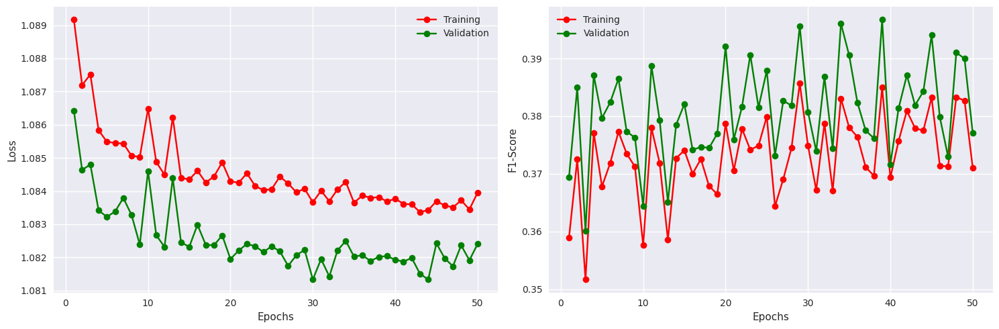


---------------------- Neural Network with 3 Hidden Layer of sizes 256 64 32 -----------------------

Time Taken:   		197.332
Average Loss: 		1.0821408392457057
F1-Score:     		0.3763207197189331
Accuracy:     		0.387423574924469
Recall:       		0.387423574924469
Precision:    		0.3925623297691345

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.38      0.29      0.33     12210		     NEUTRAL       0.38      0.29      0.33      1744
    POSITIVE       0.42      0.28      0.34     12210		    POSITIVE       0.42      0.29      0.34      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   macr

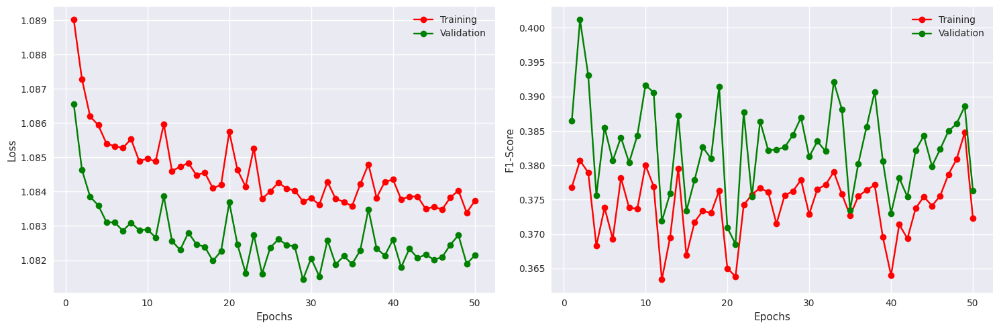


---------------------- Neural Network with 3 Hidden Layer of sizes 256 64 64 -----------------------

Time Taken:   		197.906
Average Loss: 		1.0817797989655709
F1-Score:     		0.3765307068824768
Accuracy:     		0.38837921619415283
Recall:       		0.38837921619415283
Precision:    		0.3913147449493408

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.58      0.45     12210		    NEGATIVE       0.38      0.58      0.46      1744
     NEUTRAL       0.39      0.24      0.29     12210		     NEUTRAL       0.39      0.24      0.30      1744
    POSITIVE       0.41      0.34      0.37     12210		    POSITIVE       0.41      0.34      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

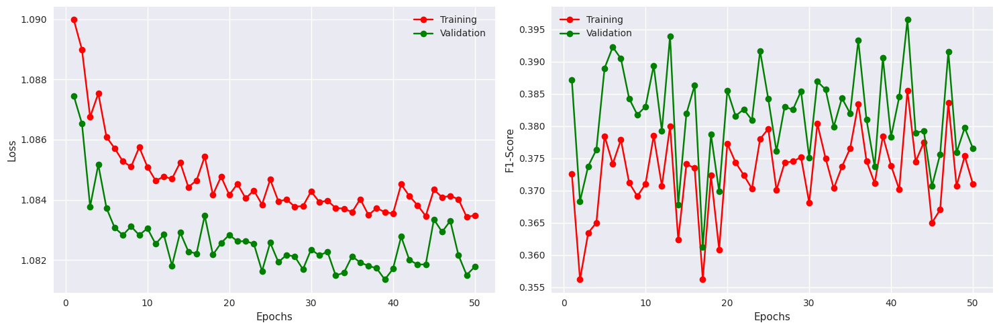


---------------------- Neural Network with 3 Hidden Layer of sizes 256 64 128 -----------------------

Time Taken:   		205.259
Average Loss: 		1.0814647980786245
F1-Score:     		0.38769036531448364
Accuracy:     		0.3918195962905884
Recall:       		0.3918195962905884
Precision:    		0.3932915925979614

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.50      0.43     12210		    NEGATIVE       0.38      0.51      0.44      1744
     NEUTRAL       0.37      0.31      0.34     12210		     NEUTRAL       0.38      0.31      0.34      1744
    POSITIVE       0.41      0.33      0.37     12210		    POSITIVE       0.42      0.36      0.39      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   

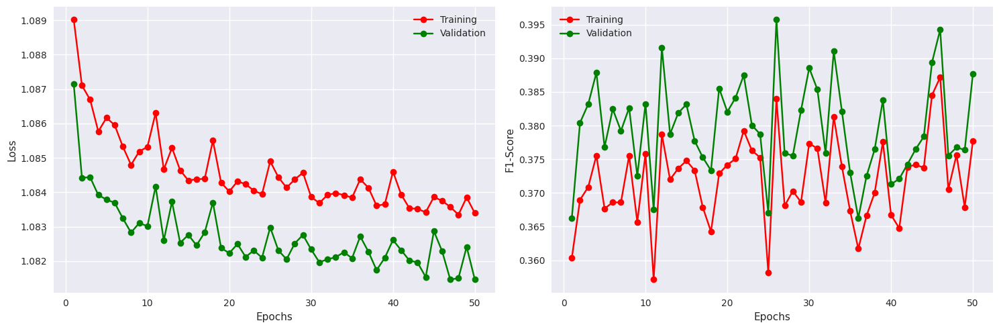


---------------------- Neural Network with 3 Hidden Layer of sizes 256 64 256 -----------------------

Time Taken:   		213.802
Average Loss: 		1.0822856063507384
F1-Score:     		0.3750547170639038
Accuracy:     		0.3920106887817383
Recall:       		0.3920106887817383
Precision:    		0.39915239810943604

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.63      0.47     12210		    NEGATIVE       0.38      0.64      0.47      1744
     NEUTRAL       0.39      0.25      0.30     12210		     NEUTRAL       0.39      0.25      0.30      1744
    POSITIVE       0.43      0.28      0.34     12210		    POSITIVE       0.43      0.29      0.35      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		   

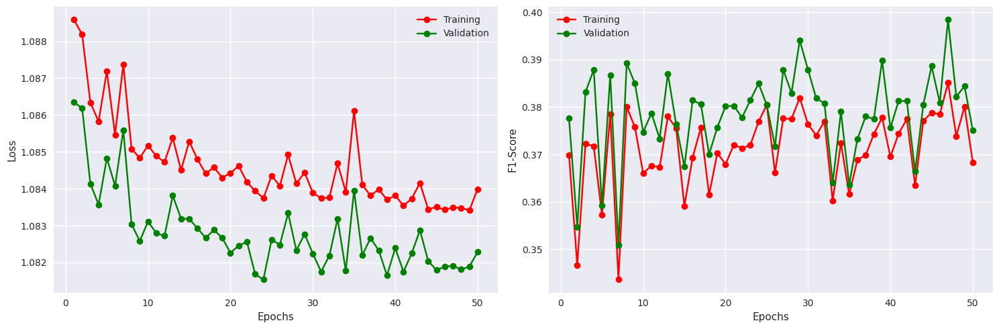


---------------------- Neural Network with 3 Hidden Layer of sizes 256 128 16 -----------------------

Time Taken:   		204.767
Average Loss: 		1.0824205838941288
F1-Score:     		0.3873724043369293
Accuracy:     		0.3891437351703644
Recall:       		0.3891437351703644
Precision:    		0.39201587438583374

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.41      0.40     12210		    NEGATIVE       0.39      0.41      0.40      1744
     NEUTRAL       0.37      0.44      0.40     12210		     NEUTRAL       0.37      0.44      0.40      1744
    POSITIVE       0.41      0.31      0.35     12210		    POSITIVE       0.41      0.32      0.36      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.38     36630		   

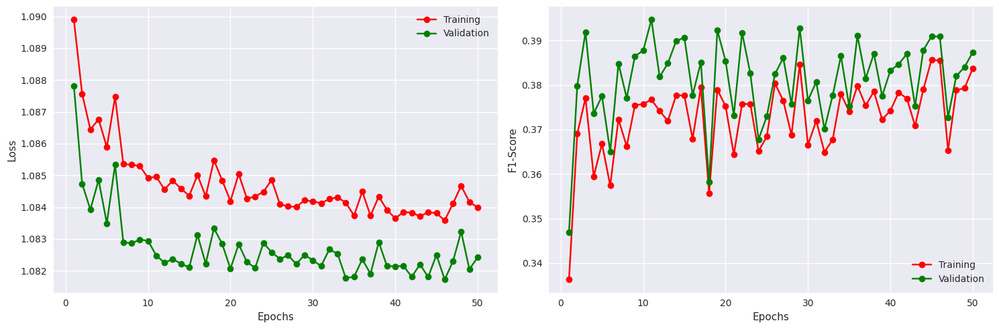


---------------------- Neural Network with 3 Hidden Layer of sizes 256 128 32 -----------------------

Time Taken:   		206.264
Average Loss: 		1.0815099253566987
F1-Score:     		0.3934229016304016
Accuracy:     		0.39525994658470154
Recall:       		0.39525994658470154
Precision:    		0.3951122462749481

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.45      0.41     12210		    NEGATIVE       0.39      0.45      0.42      1744
     NEUTRAL       0.38      0.32      0.35     12210		     NEUTRAL       0.39      0.32      0.35      1744
    POSITIVE       0.40      0.39      0.39     12210		    POSITIVE       0.40      0.41      0.41      1744
		
    accuracy                           0.39     36630		    accuracy                           0.40      5232
   macro avg       0.39      0.39      0.38     36630		  

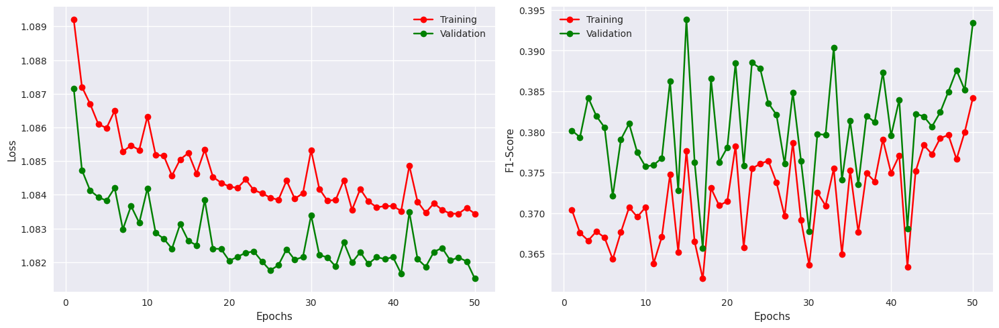


---------------------- Neural Network with 3 Hidden Layer of sizes 256 128 64 -----------------------

Time Taken:   		212.882
Average Loss: 		1.0825257919250277
F1-Score:     		0.3826470375061035
Accuracy:     		0.3885703384876251
Recall:       		0.3885703384876251
Precision:    		0.3941013813018799

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.48      0.43     12210		    NEGATIVE       0.38      0.49      0.43      1744
     NEUTRAL       0.37      0.41      0.39     12210		     NEUTRAL       0.37      0.41      0.39      1744
    POSITIVE       0.42      0.26      0.32     12210		    POSITIVE       0.42      0.26      0.33      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   m

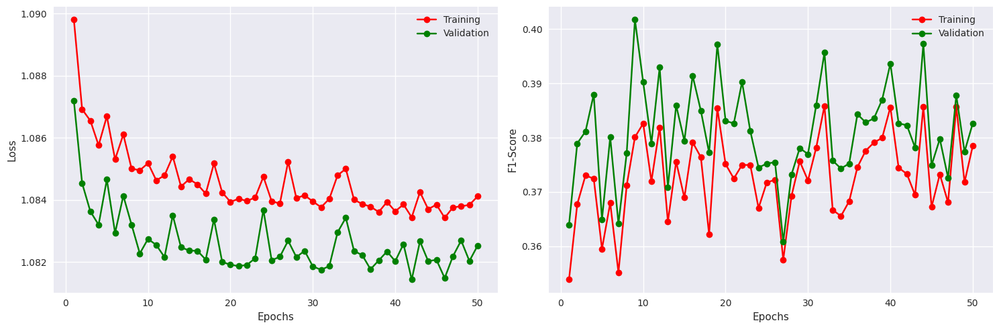


---------------------- Neural Network with 3 Hidden Layer of sizes 256 128 128 -----------------------

Time Taken:   		217.865
Average Loss: 		1.0840319229193054
F1-Score:     		0.3662489056587219
Accuracy:     		0.39086392521858215
Recall:       		0.39086392521858215
Precision:    		0.39744800329208374

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.41      0.39     12210		    NEGATIVE       0.39      0.41      0.40      1744
     NEUTRAL       0.41      0.16      0.23     12210		     NEUTRAL       0.42      0.16      0.23      1744
    POSITIVE       0.38      0.57      0.45     12210		    POSITIVE       0.38      0.60      0.47      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.36     36630		

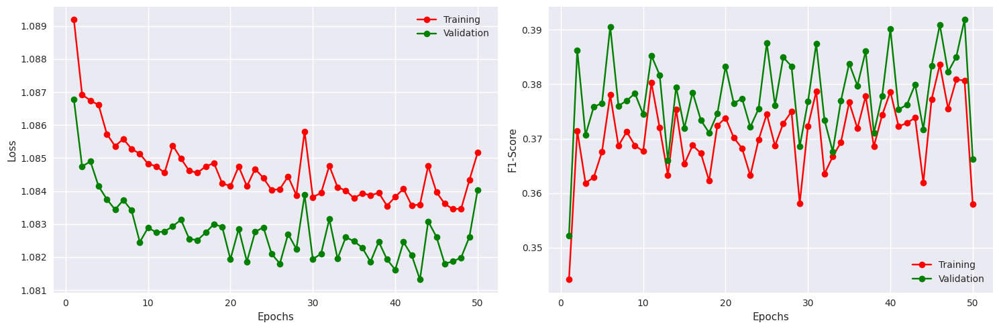


---------------------- Neural Network with 3 Hidden Layer of sizes 256 128 256 -----------------------

Time Taken:   		226.976
Average Loss: 		1.0819568626742115
F1-Score:     		0.37480154633522034
Accuracy:     		0.39277520775794983
Recall:       		0.39277520775794983
Precision:    		0.3969188332557678

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.59      0.46     12210		    NEGATIVE       0.38      0.59      0.46      1744
     NEUTRAL       0.41      0.18      0.25     12210		     NEUTRAL       0.40      0.19      0.26      1744
    POSITIVE       0.40      0.39      0.40     12210		    POSITIVE       0.41      0.40      0.40      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.39      0.37     36630		

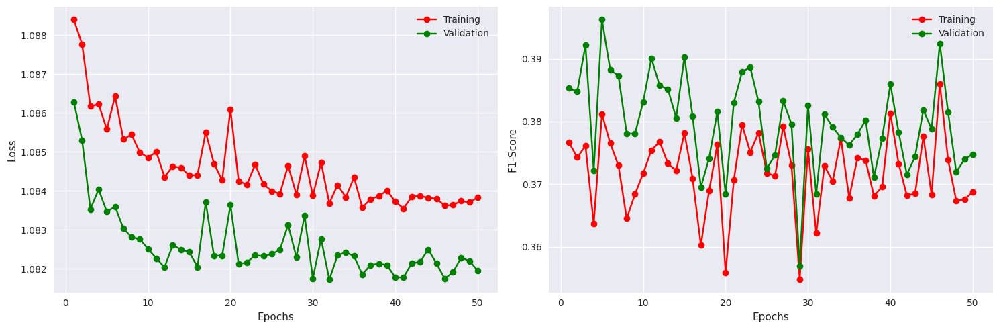


---------------------- Neural Network with 3 Hidden Layer of sizes 256 256 16 -----------------------

Time Taken:   		214.723
Average Loss: 		1.0819111967670079
F1-Score:     		0.3681056499481201
Accuracy:     		0.3920106887817383
Recall:       		0.3920106887817383
Precision:    		0.4012073278427124

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.65      0.47     12210		    NEGATIVE       0.38      0.66      0.48      1744
     NEUTRAL       0.41      0.17      0.24     12210		     NEUTRAL       0.41      0.19      0.26      1744
    POSITIVE       0.41      0.33      0.37     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.39     36630		    accuracy                           0.39      5232
   macro avg       0.40      0.39      0.36     36630		   m

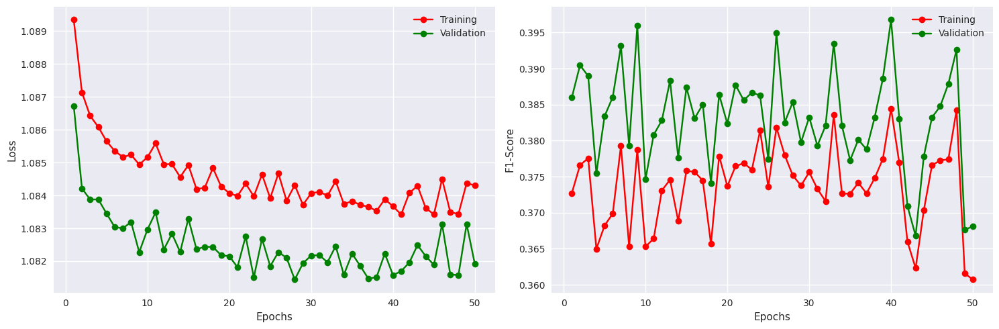


---------------------- Neural Network with 3 Hidden Layer of sizes 256 256 32 -----------------------

Time Taken:   		221.997
Average Loss: 		1.0822879271040633
F1-Score:     		0.3843945860862732
Accuracy:     		0.387423574924469
Recall:       		0.387423574924469
Precision:    		0.3878752589225769

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.39      0.49      0.43      1744
     NEUTRAL       0.37      0.34      0.36     12210		     NEUTRAL       0.37      0.33      0.35      1744
    POSITIVE       0.41      0.32      0.36     12210		    POSITIVE       0.41      0.34      0.37      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   mac

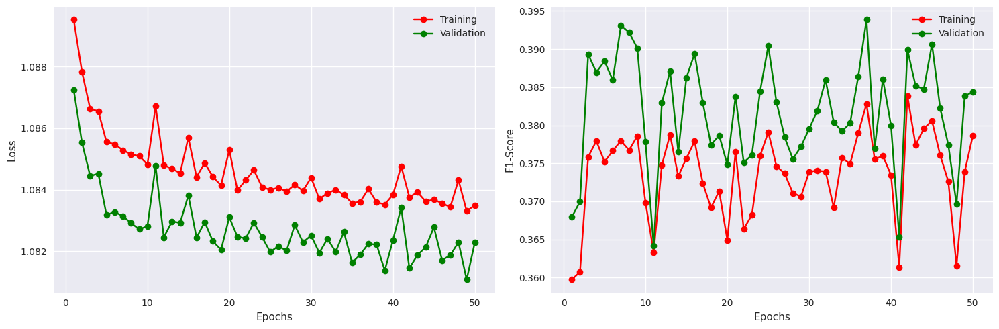


---------------------- Neural Network with 3 Hidden Layer of sizes 256 256 64 -----------------------

Time Taken:   		224.413
Average Loss: 		1.0822684815899677
F1-Score:     		0.3802828788757324
Accuracy:     		0.3902905285358429
Recall:       		0.3902905285358429
Precision:    		0.392477810382843

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.57      0.45     12210		    NEGATIVE       0.38      0.57      0.46      1744
     NEUTRAL       0.38      0.28      0.32     12210		     NEUTRAL       0.38      0.28      0.32      1744
    POSITIVE       0.42      0.31      0.35     12210		    POSITIVE       0.42      0.32      0.36      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.38     36630		   ma

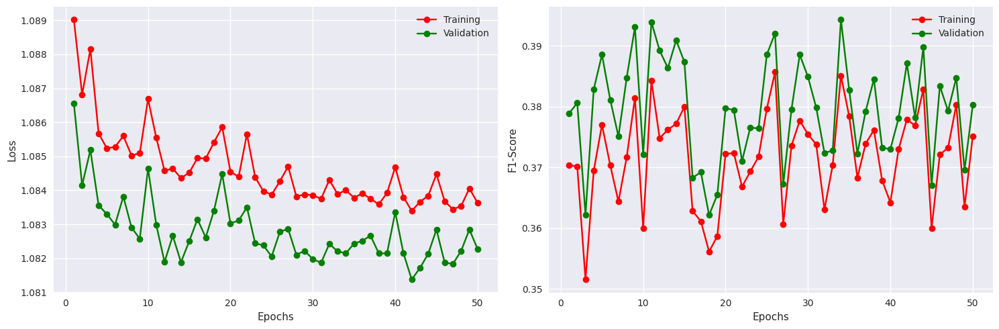


---------------------- Neural Network with 3 Hidden Layer of sizes 256 256 128 -----------------------

Time Taken:   		231.624
Average Loss: 		1.081934638161907
F1-Score:     		0.38025006651878357
Accuracy:     		0.3862767517566681
Recall:       		0.3862767517566681
Precision:    		0.384988009929657

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.48      0.42     12210		    NEGATIVE       0.38      0.48      0.43      1744
     NEUTRAL       0.38      0.26      0.31     12210		     NEUTRAL       0.37      0.26      0.31      1744
    POSITIVE       0.40      0.41      0.40     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.38      0.38      0.38     36630		   m

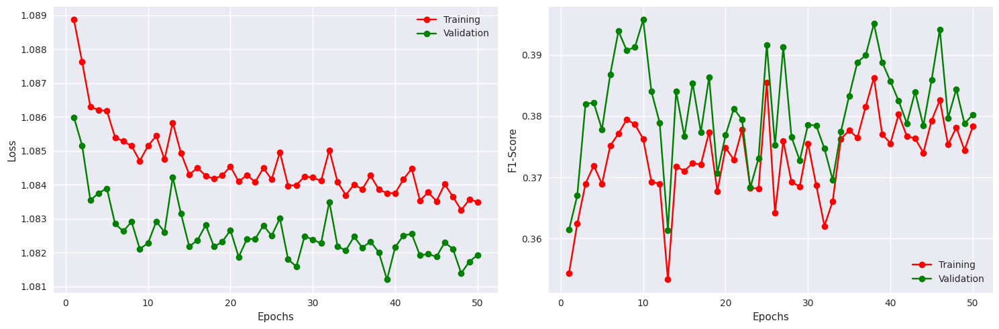


---------------------- Neural Network with 3 Hidden Layer of sizes 256 256 256 -----------------------

Time Taken:   		242.721
Average Loss: 		1.0818848637265897
F1-Score:     		0.3777937889099121
Accuracy:     		0.3916284441947937
Recall:       		0.3916284441947937
Precision:    		0.3943709135055542

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.57      0.45     12210		    NEGATIVE       0.38      0.57      0.46      1744
     NEUTRAL       0.39      0.20      0.27     12210		     NEUTRAL       0.40      0.21      0.28      1744
    POSITIVE       0.40      0.38      0.39     12210		    POSITIVE       0.40      0.40      0.40      1744
		
    accuracy                           0.38     36630		    accuracy                           0.39      5232
   macro avg       0.39      0.38      0.37     36630		   

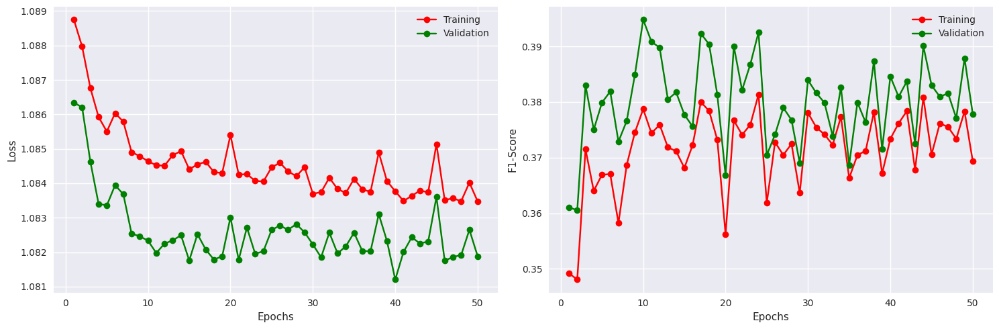

In [27]:
for H1 in [16, 32, 64, 128, 256]:
    for H2 in [16, 32, 64, 128, 256]:
        for H3 in [16, 32, 64, 128, 256]:

            print(f"---------------------- Neural Network with 3 Hidden Layer of sizes {H1} {H2} {H3} -----------------------\n")
            # Eliminate randomness    
            randonmness_elimination(212)

            model = GenericNeuralNetwork(300, [H1, H2, H3], 3, None, None)

            # preds, targets = 
            evaluation_process( path = f"arch_3/{H1}_{H2}_{H3}",
                                train_dataloader = train_dataloader, 
                                val_dataloader = val_dataloader, 
                                model = model,
                                epochs = 50, 
                                optimizer = torch.optim.SGD, 
                                costFunc = nn.CrossEntropyLoss(), 
                                learning_rate = 0.01,  
                                scheduler = None,
                                scheduler_info = None,
                                device = "cuda" if torch.cuda.is_available() else "cpu",  
                                show_progress = False)
            print()

## Activation Function

------------------ Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU -------------------

Time Taken:   		204.497
Average Loss: 		1.1197934907146185
F1-Score:     		0.3585146367549896
Accuracy:     		0.37538227438926697
Recall:       		0.37538227438926697
Precision:    		0.38794705271720886

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.48      0.43      0.45     12210		    NEGATIVE       0.39      0.35      0.37      1744
     NEUTRAL       0.41      0.68      0.51     12210		     NEUTRAL       0.36      0.58      0.44      1744
    POSITIVE       0.58      0.26      0.36     12210		    POSITIVE       0.42      0.19      0.27      1744
		
    accuracy                           0.46     36630		    accuracy                           0.38      5232
   macro avg       0.49      0.46      0.44     36630		   

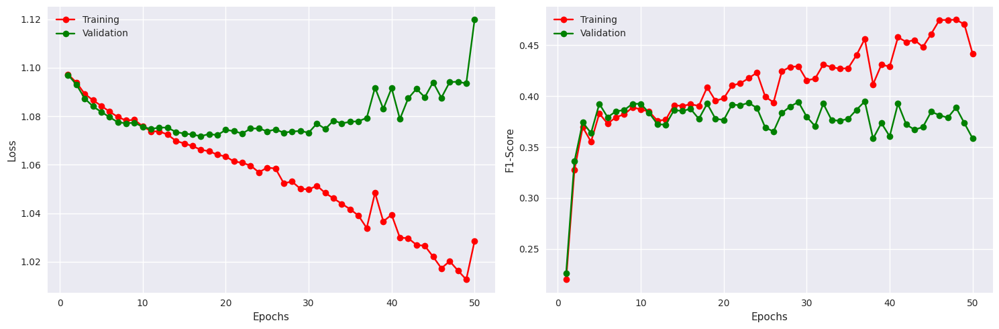


------------------ Neural Network with 3 Hidden Layer of sizes 128 128 16 & CELU -------------------

Time Taken:   		212.429
Average Loss: 		1.0734105677050552
F1-Score:     		0.3873679041862488
Accuracy:     		0.3916284739971161
Recall:       		0.3916284739971161
Precision:    		0.39853471517562866

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.40      0.40      0.40     12210		    NEGATIVE       0.40      0.40      0.40      1744
     NEUTRAL       0.38      0.50      0.43     12210		     NEUTRAL       0.36      0.49      0.42      1744
    POSITIVE       0.44      0.29      0.35     12210		    POSITIVE       0.43      0.28      0.34      1744
		
    accuracy                           0.40     36630		    accuracy                           0.39      5232
   macro avg       0.41      0.40      0.40     36630		   m

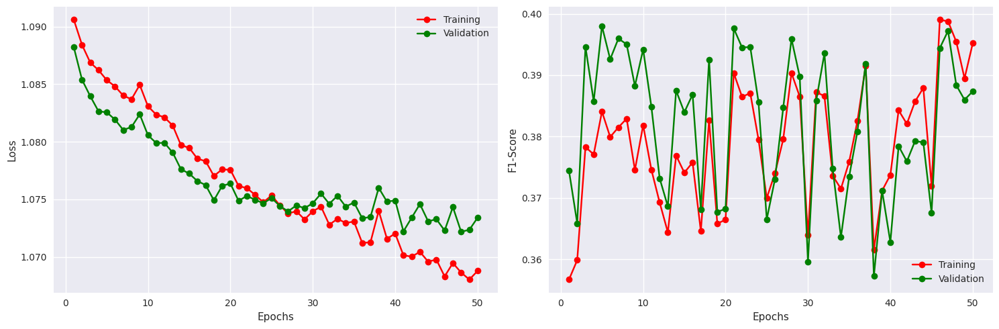


------------------ Neural Network with 3 Hidden Layer of sizes 128 128 16 & GELU -------------------

Time Taken:   		256.973
Average Loss: 		1.0700904045265385
F1-Score:     		0.40292900800704956
Accuracy:     		0.4067278206348419
Recall:       		0.4067278206348419
Precision:    		0.40762418508529663

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.50      0.44     12210		    NEGATIVE       0.40      0.52      0.45      1744
     NEUTRAL       0.41      0.35      0.37     12210		     NEUTRAL       0.41      0.33      0.37      1744
    POSITIVE       0.42      0.36      0.39     12210		    POSITIVE       0.42      0.37      0.39      1744
		
    accuracy                           0.40     36630		    accuracy                           0.41      5232
   macro avg       0.41      0.40      0.40     36630		   

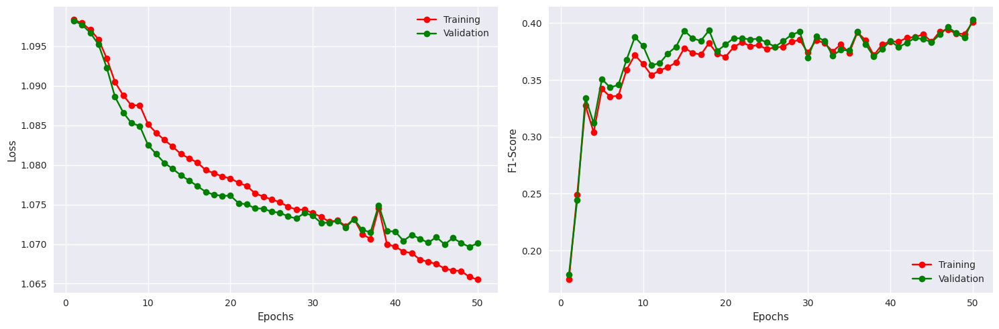


------------------ Neural Network with 3 Hidden Layer of sizes 128 128 16 & SiLU -------------------

Time Taken:   		208.806
Average Loss: 		1.0722563108172984
F1-Score:     		0.4021279811859131
Accuracy:     		0.4063456058502197
Recall:       		0.4063456058502197
Precision:    		0.40653496980667114

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.49      0.43     12210		    NEGATIVE       0.40      0.52      0.45      1744
     NEUTRAL       0.39      0.34      0.36     12210		     NEUTRAL       0.40      0.32      0.35      1744
    POSITIVE       0.42      0.36      0.39     12210		    POSITIVE       0.42      0.38      0.40      1744
		
    accuracy                           0.40     36630		    accuracy                           0.41      5232
   macro avg       0.40      0.40      0.39     36630		   m

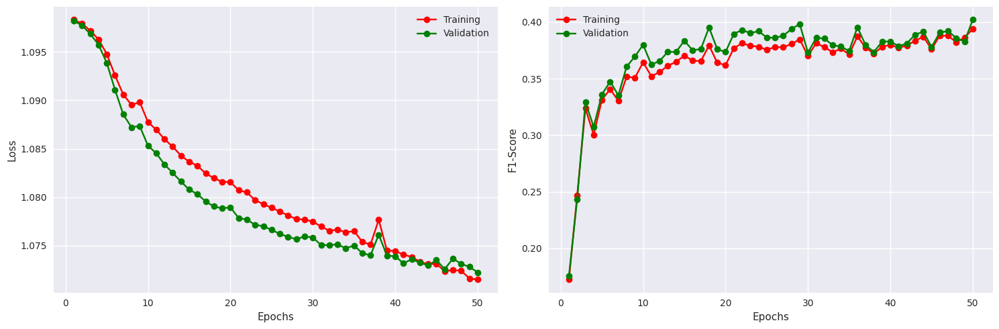

In [28]:
for actv in [nn.ReLU,
             nn.CELU,
             nn.GELU,
             nn.SiLU]:
    print(f"------------------ Neural Network with 3 Hidden Layer of sizes 128 128 16 & {actv.__name__} -------------------\n")
    # Eliminate randomness    
    randonmness_elimination(212)

    model = GenericNeuralNetwork(300, [128, 128, 16], 3, actv, None)

    # preds, targets = 
    evaluation_process( path = f"most_promising/128_128_16_{actv.__name__}",
                        train_dataloader = train_dataloader, 
                        val_dataloader = val_dataloader, 
                        model = model,
                        epochs = 50, 
                        optimizer = torch.optim.SGD, 
                        costFunc = nn.CrossEntropyLoss(), 
                        learning_rate = 0.01,  
                        scheduler = None,
                        scheduler_info = None,
                        device = "cuda" if torch.cuda.is_available() else "cpu",  
                        show_progress = False)
    print()

## Activation Functions with best Epoch

--------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 ----------

Time Taken:   		41.276
Average Loss: 		1.075634155798396
F1-Score:     		0.3924849033355713
Accuracy:     		0.40194955468177795
Recall:       		0.40194955468177795
Precision:    		0.40710151195526123

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.56      0.46     12210		    NEGATIVE       0.39      0.58      0.47      1744
     NEUTRAL       0.39      0.34      0.36     12210		     NEUTRAL       0.39      0.33      0.36      1744
    POSITIVE       0.43      0.28      0.34     12210		    POSITIVE       0.44      0.29      0.35      1744
		
    accuracy                           0.40     36630		    accuracy                           0.40      5232
   macro avg       0.40      0.40      0.39     36630		   macro avg

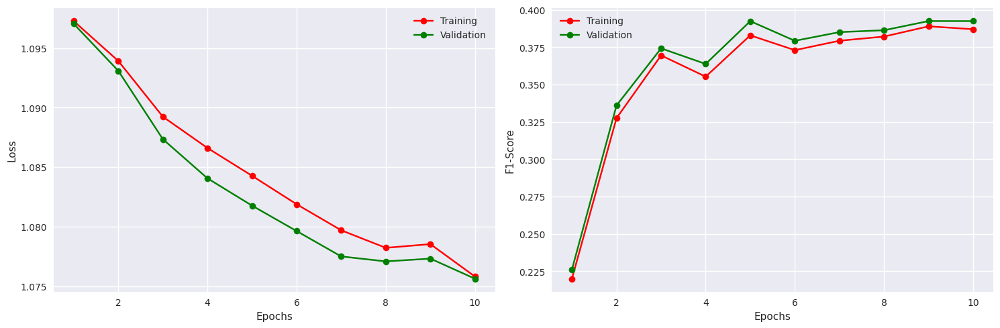


--------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & CELU & Epoch 25 ----------

Time Taken:   		103.735
Average Loss: 		1.0751167240492794
F1-Score:     		0.3665035665035248
Accuracy:     		0.3971712589263916
Recall:       		0.3971712589263916
Precision:    		0.4093601405620575

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.70      0.49     12210		    NEGATIVE       0.38      0.73      0.50      1744
     NEUTRAL       0.43      0.22      0.29     12210		     NEUTRAL       0.40      0.20      0.27      1744
    POSITIVE       0.44      0.27      0.33     12210		    POSITIVE       0.45      0.26      0.33      1744
		
    accuracy                           0.40     36630		    accuracy                           0.40      5232
   macro avg       0.41      0.40      0.37     36630		   macro avg

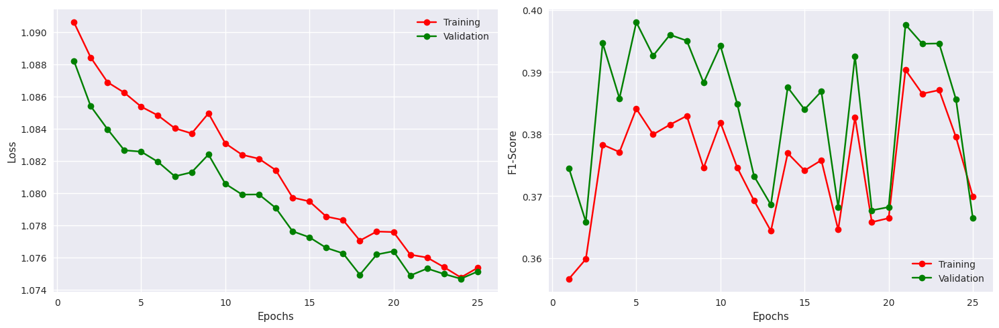


--------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & GELU & Epoch 30 ----------

Time Taken:   		151.783
Average Loss: 		1.073575013821278
F1-Score:     		0.36974790692329407
Accuracy:     		0.39659786224365234
Recall:       		0.39659786224365234
Precision:    		0.4053260087966919

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.37      0.66      0.48     12210		    NEGATIVE       0.38      0.68      0.49      1744
     NEUTRAL       0.43      0.20      0.27     12210		     NEUTRAL       0.42      0.18      0.25      1744
    POSITIVE       0.43      0.33      0.37     12210		    POSITIVE       0.42      0.32      0.36      1744
		
    accuracy                           0.40     36630		    accuracy                           0.40      5232
   macro avg       0.41      0.40      0.37     36630		   macro a

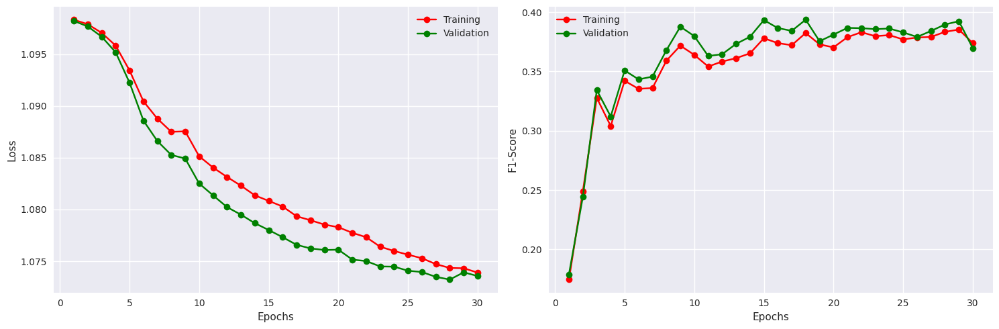


--------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & SiLU & Epoch 45 ----------

Time Taken:   		183.364
Average Loss: 		1.0735183421989465
F1-Score:     		0.37793469429016113
Accuracy:     		0.401567280292511
Recall:       		0.401567280292511
Precision:    		0.4146193861961365

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.51      0.44     12210		    NEGATIVE       0.40      0.52      0.45      1744
     NEUTRAL       0.46      0.17      0.25     12210		     NEUTRAL       0.45      0.16      0.23      1744
    POSITIVE       0.39      0.51      0.44     12210		    POSITIVE       0.39      0.53      0.45      1744
		
    accuracy                           0.40     36630		    accuracy                           0.40      5232
   macro avg       0.41      0.40      0.38     36630		   macro avg 

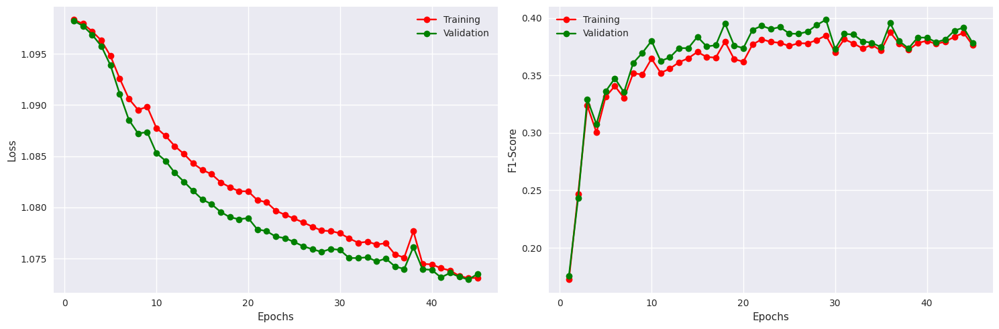

In [29]:
# actv in [nn.ReLU, nn.CELU, nn.GELU, nn.SiLU]:
for actv, epoch_num in zip([nn.ReLU, nn.CELU, nn.GELU, nn.SiLU], [10, 25, 30, 45]):
    print(f"--------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & {actv.__name__} & Epoch {epoch_num} ----------\n")
    # Eliminate randomness    
    randonmness_elimination(212)

    model = GenericNeuralNetwork(300, [128, 128, 16], 3, actv, None)

    # preds, targets = 
    evaluation_process( path = f"most_promising_best_epoch/128_128_16_{actv.__name__}_{epoch_num}",
                        train_dataloader = train_dataloader, 
                        val_dataloader = val_dataloader, 
                        model = model,
                        epochs = epoch_num, 
                        optimizer = torch.optim.SGD, 
                        costFunc = nn.CrossEntropyLoss(), 
                        learning_rate = 0.01,  
                        scheduler = None,
                        scheduler_info = None,
                        device = "cuda" if torch.cuda.is_available() else "cpu",  
                        show_progress = False)
    print()

## Optimizer Testing

-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD ---------------

Time Taken:   		40.490
Average Loss: 		1.075634155798396
F1-Score:     		0.3924849033355713
Accuracy:     		0.40194955468177795
Recall:       		0.40194955468177795
Precision:    		0.40710151195526123

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.56      0.46     12210		    NEGATIVE       0.39      0.58      0.47      1744
     NEUTRAL       0.39      0.34      0.36     12210		     NEUTRAL       0.39      0.33      0.36      1744
    POSITIVE       0.43      0.28      0.34     12210		    POSITIVE       0.44      0.29      0.35      1744
		
    accuracy                           0.40     36630		    accuracy                           0.40      5232
   macro avg       0.40      0.40      0.39     366

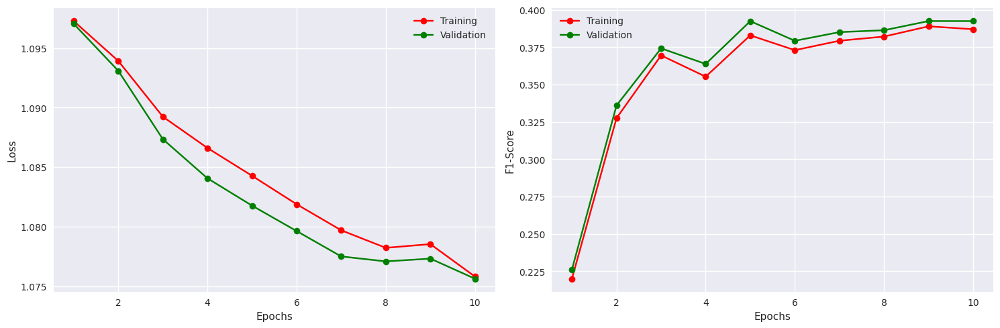


-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & Adagrad ---------------

Time Taken:   		48.287
Average Loss: 		1.0713630767043578
F1-Score:     		0.3826901614665985
Accuracy:     		0.3914373219013214
Recall:       		0.3914373219013214
Precision:    		0.3967621922492981

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.40      0.61      0.48     12210		    NEGATIVE       0.38      0.57      0.45      1744
     NEUTRAL       0.45      0.36      0.40     12210		     NEUTRAL       0.39      0.31      0.35      1744
    POSITIVE       0.46      0.32      0.38     12210		    POSITIVE       0.42      0.30      0.35      1744
		
    accuracy                           0.43     36630		    accuracy                           0.39      5232
   macro avg       0.44      0.43      0.42     

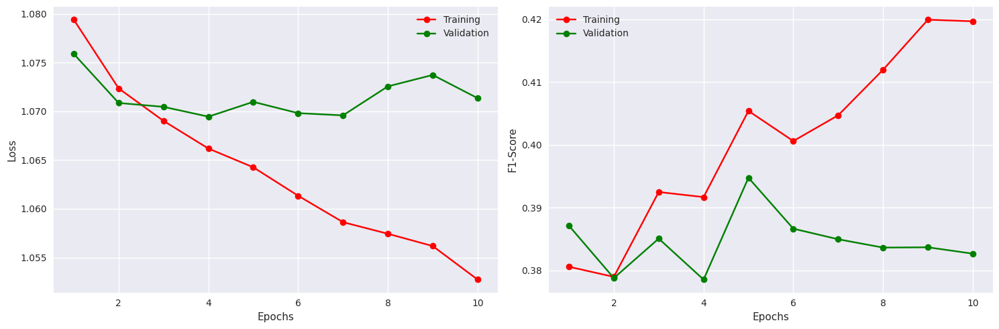


-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & Adamax ---------------

Time Taken:   		69.191
Average Loss: 		1.0757253277556977
F1-Score:     		0.38383591175079346
Accuracy:     		0.3931574821472168
Recall:       		0.3931574821472168
Precision:    		0.4065655767917633

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.40      0.53      0.46     12210		    NEGATIVE       0.39      0.49      0.43      1744
     NEUTRAL       0.40      0.48      0.44     12210		     NEUTRAL       0.37      0.46      0.41      1744
    POSITIVE       0.50      0.25      0.33     12210		    POSITIVE       0.46      0.23      0.31      1744
		
    accuracy                           0.42     36630		    accuracy                           0.39      5232
   macro avg       0.44      0.42      0.41     

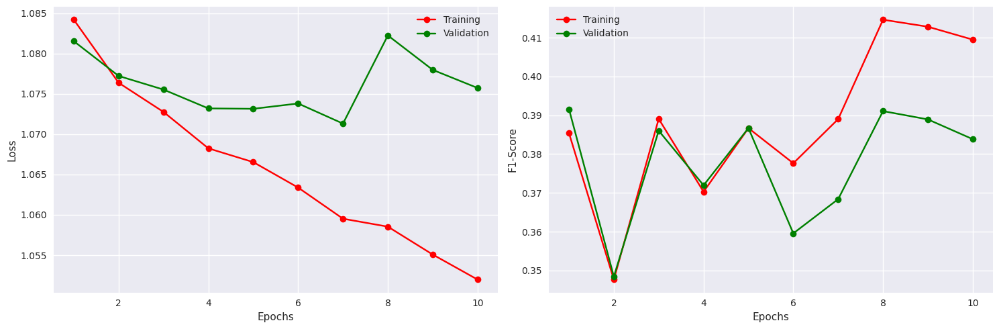

In [30]:
for optimizer in [torch.optim.SGD, torch.optim.Adagrad, torch.optim.Adamax]:
    print(f"-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & {optimizer.__name__} ---------------\n")
    # Eliminate randomness    
    randonmness_elimination(212)

    model = GenericNeuralNetwork(300, [128, 128, 16], 3, nn.ReLU, None)

    # preds, targets = 
    evaluation_process( path = f"most_promising_best_epoch_optimizer/128_128_16_ReLU_10_{optimizer.__name__}",
                        train_dataloader = train_dataloader, 
                        val_dataloader = val_dataloader, 
                        model = model,
                        epochs = 10, 
                        optimizer = optimizer, 
                        costFunc = nn.CrossEntropyLoss(), 
                        learning_rate = 0.01,  
                        scheduler = None,
                        scheduler_info = None,
                        device = "cuda" if torch.cuda.is_available() else "cpu",  
                        show_progress = False)
    print()

## Dropout Testing

-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Dropout 0.01 ---------------

Time Taken:   		46.609
Average Loss: 		1.07492910339198
F1-Score:     		0.394195556640625
Accuracy:     		0.4025229215621948
Recall:       		0.4025229215621948
Precision:    		0.40402811765670776

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.52      0.44     12210		    NEGATIVE       0.40      0.53      0.46      1744
     NEUTRAL       0.41      0.27      0.33     12210		     NEUTRAL       0.41      0.26      0.32      1744
    POSITIVE       0.41      0.41      0.41     12210		    POSITIVE       0.40      0.42      0.41      1744
		
    accuracy                           0.40     36630		    accuracy                           0.40      5232
   macro avg       0.40      0.40      0

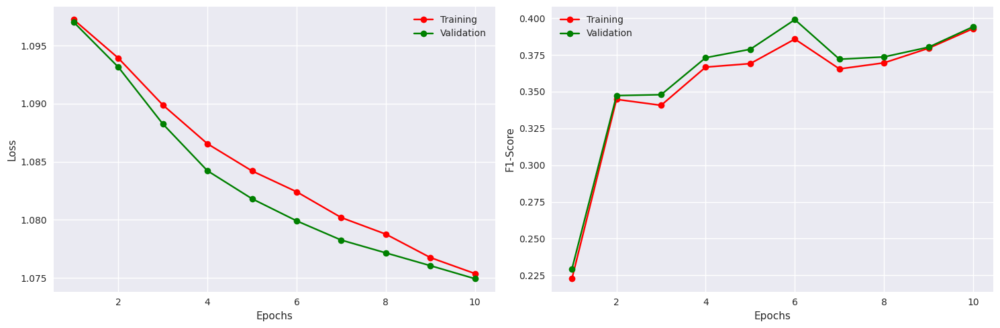


-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Dropout 0.02 ---------------

Time Taken:   		46.481
Average Loss: 		1.0750369281943786
F1-Score:     		0.39529240131378174
Accuracy:     		0.4044342637062073
Recall:       		0.4044342637062073
Precision:    		0.4059419631958008

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.52      0.44     12210		    NEGATIVE       0.40      0.54      0.46      1744
     NEUTRAL       0.41      0.27      0.32     12210		     NEUTRAL       0.41      0.25      0.31      1744
    POSITIVE       0.41      0.41      0.41     12210		    POSITIVE       0.41      0.42      0.41      1744
		
    accuracy                           0.40     36630		    accuracy                           0.40      5232
   macro avg       0.40      0.40   

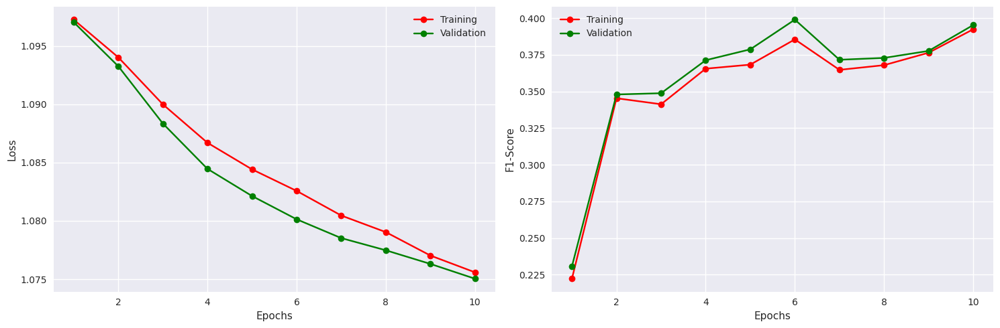


-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Dropout 0.03 ---------------

Time Taken:   		46.751
Average Loss: 		1.0752167860302357
F1-Score:     		0.3963801860809326
Accuracy:     		0.4051987826824188
Recall:       		0.4051987826824188
Precision:    		0.4067874252796173

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.52      0.44     12210		    NEGATIVE       0.40      0.55      0.46      1744
     NEUTRAL       0.41      0.27      0.33     12210		     NEUTRAL       0.41      0.26      0.32      1744
    POSITIVE       0.41      0.41      0.41     12210		    POSITIVE       0.41      0.41      0.41      1744
		
    accuracy                           0.40     36630		    accuracy                           0.41      5232
   macro avg       0.40      0.40    

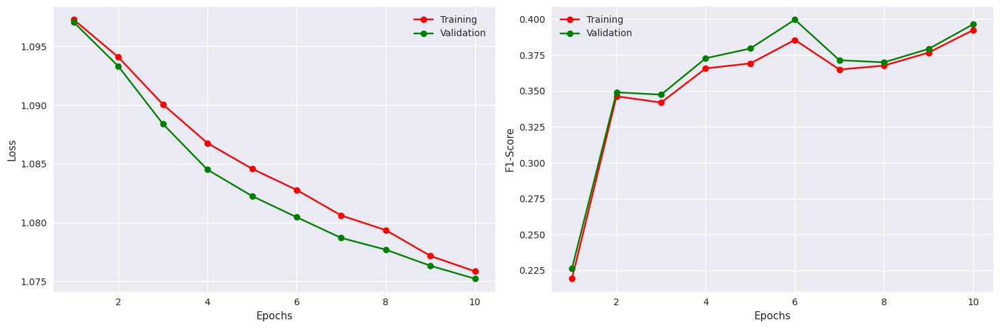

In [31]:
for dropout in [0.01, 0.02, 0.03]:
    print(f"-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Dropout {dropout} ---------------\n")
    # Eliminate randomness    
    randonmness_elimination(212)

    model = GenericNeuralNetwork(300, [128, 128, 16], 3, nn.ReLU, dropout)

    # preds, targets = 
    evaluation_process( path = f"most_promising_best_epoch_optimizer_dropout/128_128_16_ReLU_10_SGD_{dropout}",
                        train_dataloader = train_dataloader, 
                        val_dataloader = val_dataloader, 
                        model = model,
                        epochs = 10, 
                        optimizer = torch.optim.SGD, 
                        costFunc = nn.CrossEntropyLoss(), 
                        learning_rate = 0.01,  
                        scheduler = None,
                        scheduler_info = None,
                        device = "cuda" if torch.cuda.is_available() else "cpu",  
                        show_progress = False)
    print()

## Learning Rate

-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Learning Rate 0.005 ---------------

Time Taken:   		40.649
Average Loss: 		1.081512274545267
F1-Score:     		0.3886370062828064
Accuracy:     		0.4017584025859833
Recall:       		0.4017584025859833
Precision:    		0.4069826006889343

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.38      0.59      0.46     12210		    NEGATIVE       0.39      0.61      0.48      1744
     NEUTRAL       0.40      0.26      0.32     12210		     NEUTRAL       0.41      0.26      0.32      1744
    POSITIVE       0.42      0.32      0.36     12210		    POSITIVE       0.42      0.33      0.37      1744
		
    accuracy                           0.39     36630		    accuracy                           0.40      5232
   macro avg       0.40      0.3

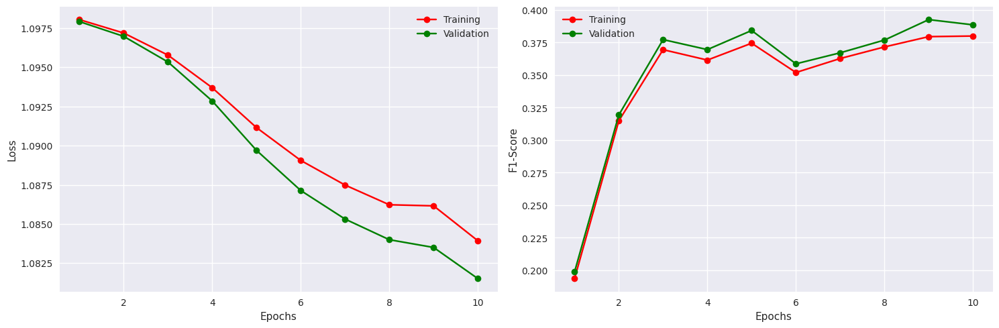


-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Learning Rate 0.02 ---------------

Time Taken:   		41.138
Average Loss: 		1.0733908112260544
F1-Score:     		0.3880527913570404
Accuracy:     		0.39449542760849
Recall:       		0.39449542760849
Precision:    		0.39889413118362427

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.39      0.51      0.45     12210		    NEGATIVE       0.40      0.52      0.45      1744
     NEUTRAL       0.39      0.42      0.41     12210		     NEUTRAL       0.37      0.39      0.38      1744
    POSITIVE       0.45      0.28      0.35     12210		    POSITIVE       0.43      0.27      0.33      1744
		
    accuracy                           0.41     36630		    accuracy                           0.39      5232
   macro avg       0.41      0.41 

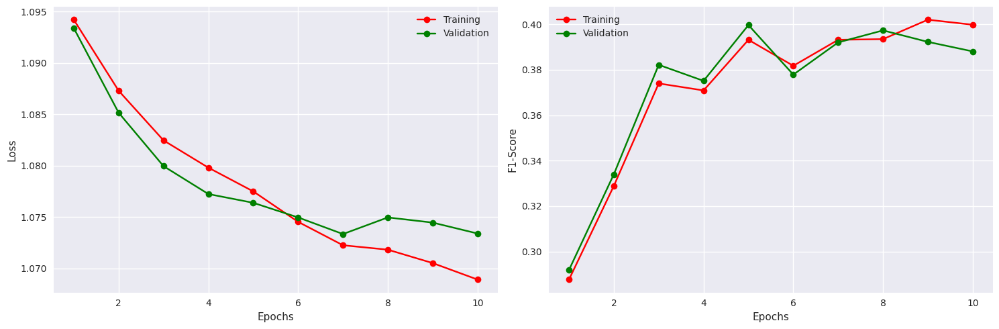


-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Learning Rate 0.025 ---------------

Time Taken:   		40.206
Average Loss: 		1.0725865426048955
F1-Score:     		0.38800156116485596
Accuracy:     		0.391437292098999
Recall:       		0.391437292098999
Precision:    		0.39740294218063354

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.40      0.45      0.43     12210		    NEGATIVE       0.40      0.45      0.42      1744
     NEUTRAL       0.39      0.47      0.43     12210		     NEUTRAL       0.36      0.44      0.40      1744
    POSITIVE       0.45      0.30      0.36     12210		    POSITIVE       0.43      0.29      0.34      1744
		
    accuracy                           0.41     36630		    accuracy                           0.39      5232
   macro avg       0.42      0

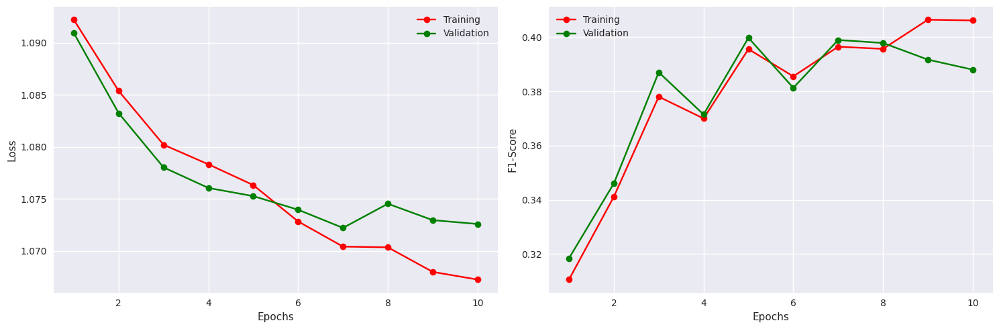


-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Learning Rate 0.03 ---------------

Time Taken:   		40.471
Average Loss: 		1.0720042892552297
F1-Score:     		0.3832414448261261
Accuracy:     		0.39124616980552673
Recall:       		0.39124616980552673
Precision:    		0.4035797715187073

Training classification report                  		Validation classification report
		
              precision    recall  f1-score   support		              precision    recall  f1-score   support
		
    NEGATIVE       0.40      0.42      0.41     12210		    NEGATIVE       0.40      0.41      0.40      1744
     NEUTRAL       0.38      0.54      0.45     12210		     NEUTRAL       0.36      0.52      0.43      1744
    POSITIVE       0.47      0.26      0.34     12210		    POSITIVE       0.45      0.25      0.32      1744
		
    accuracy                           0.41     36630		    accuracy                           0.39      5232
   macro avg       0.42      

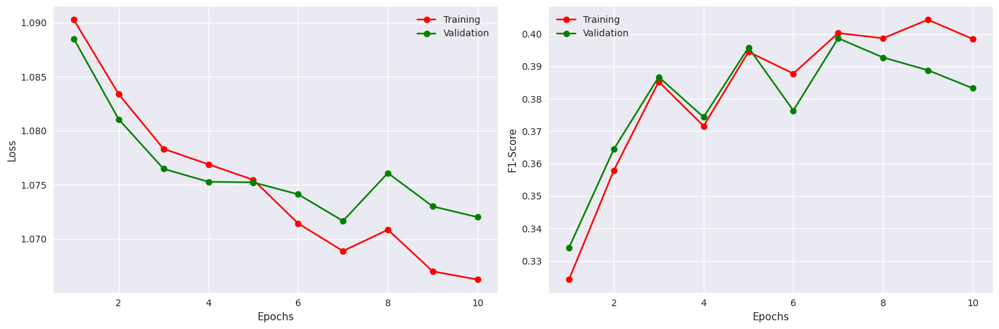

In [32]:
for lr in [0.005, 0.02, 0.025, 0.03]:
    print(f"-------------- Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Learning Rate {lr} ---------------\n")
    # Eliminate randomness    
    randonmness_elimination(212)

    model = GenericNeuralNetwork(300, [128, 128, 16], 3, nn.ReLU, None)

    # preds, targets = 
    evaluation_process( path = f"most_promising_best_epoch_optimizer_dropout_lr/128_128_16_ReLU_10_SGD_{lr}",
                        train_dataloader = train_dataloader, 
                        val_dataloader = val_dataloader, 
                        model = model,
                        epochs = 10, 
                        optimizer = torch.optim.SGD, 
                        costFunc = nn.CrossEntropyLoss(), 
                        learning_rate = lr,  
                        scheduler = None,
                        scheduler_info = None,
                        device = "cuda" if torch.cuda.is_available() else "cpu",  
                        show_progress = False)
    print()

# Best Model

In [33]:
def evaluation_process_best(path, train_dataloader, val_dataloader, model, epochs, optimizer, costFunc, learning_rate, scheduler, scheduler_info, device, show_progress):
    model = model.to(device)
    
    optimizer = optimizer(model.parameters(), lr = learning_rate)
    
    if scheduler:
        scheduler = scheduler(optimizer, lr = learning_rate, **scheduler_info)
    
    # Begin timer    
    begin_timer = time.perf_counter()
    
    # Do the train
    trained_model, train_losses, val_losses, train_f1, val_f1, best_stats = training_process(epochs, optimizer, train_dataloader, val_dataloader, costFunc, model, scheduler, device, show_progress)

    # Stop timer
    stop_timer = time.perf_counter()
    
    loss_val, f_val, a_val, r_val, p_val, preds_val, targets_val = testing_process(best_stats["best_model"], val_dataloader, costFunc, device)
       
    show_report(stop_timer - begin_timer, loss_val, f_val, a_val, r_val, p_val)
    
    print()
    
    # That's just to save the plots in order for us to download them and use them in report instead of screenshooting everything
    fig = plt.figure()
    custom_learning_curve(train_losses, val_losses, [i + 1 for i in range(epochs)], "Epochs", "Loss", False)
    plt.close(fig)
    try:
        fig.savefig(f'{path}/lr_loss.png')    
    except:
        os.makedirs(f"{path}")
        fig.savefig(f'{path}/lr_loss.png')  
    
    fig = plt.figure()
    custom_learning_curve(train_f1, val_f1, [i + 1 for i in range(epochs)], "Epochs", "F1-Score", False)
    plt.close(fig)
    try:
        fig.savefig(f'{path}/lr_f1.png')    
    except:
        os.makedirs(f"{path}")
        fig.savefig(f'{path}/lr_f1.png')      
    
    # ROC Curve
    fig = plt.figure()
    custom_roc_curve(torch.cat(targets_val).to(device).numpy(), torch.cat(preds_val).to(device).numpy(), False)
    plt.close(fig)
    try:
        fig.savefig(f'{path}/roc.png')    
    except:
        os.makedirs(f"{path}")
        fig.savefig(f'{path}/roc.png')

    # Confusion Matrix
    fig = plt.figure()
    conf_matrix = ConfusionMatrix(task='multiclass', num_classes=3, normalize='true').to(device)
    custom_confusion_matrix(conf_matrix(torch.cat(preds_val).to(device), torch.cat(targets_val).to(device)).numpy(), False)
    plt.close(fig)
    try:
        fig.savefig(f'{path}/cm.png')    
    except:
        os.makedirs(f"{path}")
        fig.savefig(f'{path}/cm.png')
    
    
    # Display plots       
    all_plots = [ "custom_learning_curve(train_losses, val_losses, [i + 1 for i in range(epochs)], \"Epochs\", \"Loss\", False)",
                  "custom_learning_curve(train_f1, val_f1, [i + 1 for i in range(epochs)], \"Epochs\", \"F1-Score\", False)",
                  "custom_roc_curve(torch.cat(targets_val).to(device).numpy(), torch.cat(preds_val).to(device).numpy(), False)",
                  "custom_confusion_matrix(conf_matrix(torch.cat(preds_val).to(device), torch.cat(targets_val).to(device)).numpy(), False)"
                ]
    # Make subplots
    _, axes = plt.subplots(1, len(all_plots), figsize=(20, 5))
    # Print each plot in a different subplot section
    for i, plot_command in enumerate(all_plots):
        plt.subplot(1, len(all_plots), i + 1)
        exec(f"{plot_command}")
    plt.tight_layout()
#     plt.savefig(f"{path}/combined.png")
    plt.show()
    

-------------- Best Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Learning Rate 0.01 ---------------

Time Taken:   		40.929
Average Loss: 		1.075634155798396
F1-Score:     		0.3924849033355713
Accuracy:     		0.40194955468177795
Recall:       		0.40194955468177795
Precision:    		0.40710151195526123



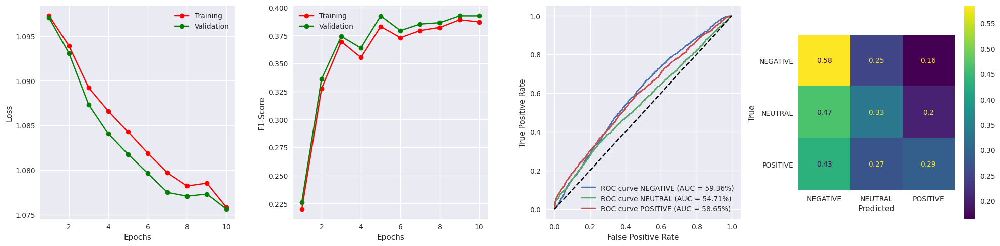

In [34]:
print(f"-------------- Best Neural Network with 3 Hidden Layer of sizes 128 128 16 & ReLU & Epoch 10 & SGD & Learning Rate 0.01 ---------------\n")
# Eliminate randomness    
randonmness_elimination(212)

model = GenericNeuralNetwork(300, [128, 128, 16], 3, nn.ReLU, None)

# preds, targets = 
evaluation_process_best( path = f"best_model",
                         train_dataloader = train_dataloader, 
                         val_dataloader = val_dataloader, 
                         model = model,
                         epochs = 10, 
                         optimizer = torch.optim.SGD, 
                         costFunc = nn.CrossEntropyLoss(), 
                         learning_rate = 0.01,  
                         scheduler = None,
                         scheduler_info = None,
                         device = "cuda" if torch.cuda.is_available() else "cpu",  
                         show_progress = False)

In [35]:
# This cell was executed in order to take all the images with one download and categorized in their directory
!zip -r file.zip /kaggle/working -q

# Evaluation on Test Set
The function below will make evaluations for the test set. It needs the path to the train and the test. It makes the necessary pre-processing, it creates the previous model, which was found the most optimal among many, and make predictions for the test set in the submission.csv

In [36]:
def predict_unseen_data(TRAIN_PATH, TEST_PATH):
    # Eliminate randomness    
    randonmness_elimination(212)
    
    df_train = pd.read_csv(TRAIN_PATH)
    
    df_test = pd.read_csv(TEST_PATH)
    
    # First wabse copy the dataframe
    df_train_cleaned_bp = df_train.copy()
    # Now we will clean the text column
    df_train_cleaned_bp = clean_tweets(df_train_cleaned_bp, False)
    
    # Now we are doing the same process for the test set
    df_test_cleaned_bp = df_test.copy()
    df_test_cleaned_bp = clean_tweets(df_test_cleaned_bp, False)
    
    # Define the word2vec model
    word2vec_model = Word2Vec(sentences=list(df_train_cleaned_bp["Tokens"]), workers=1, min_count=1, vector_size=300, seed=212)

    # Train the word2vec model as we said above
    word2vec_model.train(list(df_train_cleaned_bp["Tokens"]), epochs=20, total_examples=word2vec_model.corpus_count)
    
    # Make a new column with the mean vector for each tweet for the training set
    df_train_cleaned_bp["embeddings_mean_vector"] = df_train_cleaned_bp["Tokens"].apply(mean_vector, model=word2vec_model)

    # Make a new column with the mean vector for each tweet for the validation set
    df_test_cleaned_bp["embeddings_mean_vector"] = df_test_cleaned_bp["Tokens"].apply(mean_vector, model=word2vec_model)

    
    # Make dataloader ONLY for train

    # Map each category to it's corresponding integer
    labels_to_ints = {np.unique(df_train_cleaned_bp["Sentiment"])[i]: i for i in range(0, len(np.unique(df_train_cleaned_bp["Sentiment"])))}

    # Create DataLoader for the train set
    train_dataloader = create_dataloader(df_train_cleaned_bp["embeddings_mean_vector"], df_train_cleaned_bp["Sentiment"], labels_to_ints, 16, True)

    # And the other way around in order to change the .csv
    ints_to_labels = {i: np.unique(df_train_cleaned_bp["Sentiment"])[i] for i in range(0, len(np.unique(df_train_cleaned_bp["Sentiment"])))}
    
    
    # For the test we are making only a torch
    # We first need to convert the data from a Panda Series into a numpy array
    TEST = np.array(df_test_cleaned_bp["embeddings_mean_vector"].to_list())
    # Convert data to fit the requirements
    TEST = torch.from_numpy(TEST).type(torch.float)
    
    device = "cuda" if torch.cuda.is_available() else "cpu"  
    
    model = GenericNeuralNetwork(300, [128, 128, 16], 3, nn.ReLU, None)
    
    model = model.to(device)
    
    learning_rate = 0.01
    optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate)    
    epochs = 10
    costFunc = nn.CrossEntropyLoss()
        
    for epoch in range(epochs):
        model.train()
        for batch, (X, y) in enumerate(train_dataloader):
            # Move the data to the corresponding device
            X = X.to(device)
            y = y.to(device)

            # Compute prediction and loss
            pred = model(X.float())
            loss = costFunc(pred, y)

            # Backpropagation
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    
    preds = []
   
    model.eval()
    
    with torch.no_grad():
        for X in TEST:
            
            # Move the data to the corresponding device
            X = X.to(device)
  
            # Compute prediction
            pred = model(X.float())
            preds.append(pred)

    final = [ints_to_labels[torch.argmax(i).item()] for i in preds]

    df_final = pd.DataFrame(list(enumerate(final, start=1)), columns=["Id", "Predicted"])
    df_final.to_csv(OUTPUT_PATH + "submission.csv", index=False)
    
    print("Sentiment Classification is done!")
    print("You can find the results in the submission.csv")

In [37]:
predict_unseen_data(INPUT_PATH + "train_set.csv", INPUT_PATH + "test_set.csv")

Sentiment Classification is done!
You can find the results in the submission.csv
